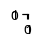

In [1]:
import pandas as pd
import numpy as np
import sklearn
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
f,a = plt.subplots(1,1,figsize=(1e-2, 1e-2))
mpl.rcParams['figure.dpi'] = 150
sns.set_style('darkgrid')
import os,sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
import warnings
warnings.filterwarnings("ignore")
import glob
from tqdm.auto import tqdm
from datetime import datetime as dt
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import LabelEncoder
import torch
from torch import optim
from torch.utils.data import RandomSampler, SequentialSampler
from torch import nn
from torch.nn import functional as F
mpl.rcParams['figure.dpi'] = 180
# Load models together
%load_ext autoreload
%autoreload 2
    
from src.torch_utils import load_model_full
from src.utils import get_class_initcode_keys
from torch.utils.data import SequentialSampler
from src.datasets import *
from src.models import *
from src.utils import mkdirs, convert_path, pkl_dump, pkl_load, add_median_labels, get_palette
from src.data_processing import BL62_VALUES, BL62FREQ_VALUES, HLAS, AA_KEYS
from src.utils import pkl_load, pkl_dump, get_palette
from src.sim_utils import make_dist_matrix
from src.torch_utils import save_checkpoint, load_checkpoint
from src.train_eval import predict_model, train_eval_loops
from src.models import FullTCRVAE, TwoStageVAECLF
from src.multimodal_datasets import MultimodalMarginalLatentDataset
from src.multimodal_models import BSSVAE, JMVAE
from src.multimodal_train_eval import predict_multimodal
from src.metrics import reconstruction_accuracy, VAELoss, TripletLoss, CombinedVAELoss, compute_cosine_distance
from src.datasets import TCRSpecificDataset, FullTCRDataset



In [2]:
new_df = pd.read_csv('../data/multimodal/240311_nettcr_pairedAB_expanded_noswap.csv')
old_df = pd.read_csv('../data/filtered/240416_nettcr_old_26pep_no_swaps.csv')
new_df_78 = pd.read_csv('../data/filtered/240507_nettcr_exp_pruned_noswap_78peps.csv')
new_df_17 = pd.read_csv('../data/filtered/240418_nettcr_expanded_20binders_17pep_POSONLY.csv')
old_df_15 = pd.read_csv('../data/filtered/240416_nettcr_old_top15peps_no_swaps.csv')
old_df_20 = pd.read_csv('../data/filtered/240507_nettcr_old_pruned_noswap_20peps.csv')

In [3]:
tbcr = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv', index_col=0)
tbcr_valid = tbcr.query('partition==0')
tbcr_valid = tbcr_valid[[str(x) for x in tbcr_valid.index]+['peptide','binder','partition','raw_index']]
tbcr_array = tbcr_valid.iloc[:len(tbcr_valid), :len(tbcr_valid)].values

# Check old clustering pruning cnn etc results

In [4]:
from src.cluster_utils import get_all_rpauc
from joblib import Parallel, delayed

def rpauc_wrapper(df, input_type):
    tmp = df.query('input_type==@input_type')
    ret = tmp['retention'].values[1:-1]
    pur = tmp['mean_purity'].values[1:-1]
    return get_all_rpauc(ret, pur, input_type, None)
    
def find_best_not_agg(intervals, nm=None):
    tmp = intervals.query('not input_type.str.contains("TBCR") and not input_type.str.startswith("agg") and not input_type.str.contains("tcrdist")')
    results = pd.DataFrame(Parallel(n_jobs=5)(delayed(rpauc_wrapper)(df=tmp, input_type=k) for k in tmp.input_type.unique()))
    best=results.sort_values('p70_r35_auc', ascending=False).head(1).input_type.item()
    return tmp.query('input_type==@best')

def find_agg(fn):
    return pd.read_csv(fn).query('input_type.str.contains("agg")')


def get_agg_given_dir(maindir, set, idf):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}*.csv') if '_OLD_' not in x]
    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    return pd.concat([baselines] + [find_agg(x) for x in folders]).assign(identifier=idf)
    
def get_best_given_dir(maindir, set, idf):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}*.csv') if '_OLD_' not in x]
    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    return pd.concat([baselines] + [find_best_not_agg(pd.read_csv(x)) for x in folders]).assign(identifier=idf)

In [5]:
from src.cluster_utils import get_all_rpauc

def get_best_given_dir_diag2(maindir, set, idf='', filters=None):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}_results*.csv') if '_OLD_' not in x]
    files = {x.split('/')[-1].split('_24')[0]\
             .replace('RedoHP_','').replace('_train_','').replace('CNNVAE','Conv')\
             .replace('OldPruned','').replace('ExpDataTop78','').replace('latent','ld').replace('kld','kl')\
             .replace('ExpData17peps','').replace('OldDataNoPrune','').replace('_KFold_0','')\
             .replace('ExpAll_','').replace('OldAll_','').replace('OldDataTop15','').replace('OldDataTop20','').lstrip('_').rstrip('_'): x for x in folders}
    if filters is not None:
        files = {key: value for key, value in files.items() if any(keyword in key for keyword in filters)}

    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    baselines['name'] = ''
    out = pd.concat([baselines] + [find_best_not_agg(pd.read_csv(path)).assign(name=name) for name, path in files.items()]).assign(identifier=idf)
    out['epoch'] = out['input_type']
    out['input_type'] = out.apply(lambda x: x['name']+'_'+x['input_type'] if x['name']!='' else x['input_type'], axis=1)#['name']+'_'+out['input_type']
    out['name'] = out.apply(lambda x: x['input_type'] if 'TBCR' in x['name'] or 'tcrdist' in x['name'] else x['name'], axis=1)
    return out[[x for x in out.columns if not 'Unnamed' in x]]
    
def get_agg_given_dir_diag2(maindir, set, idf='', filters=None):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}_results*.csv') if '_OLD_' not in x]
    files = {x.split('/')[-1].split('_24')[0]\
             .replace('RedoHP_','').replace('_train_','').replace('CNNVAE','Conv')\
             .replace('OldPruned','').replace('ExpDataTop78','').replace('latent','ld').replace('kld','kl')\
             .replace('ExpData17peps','').replace('OldDataNoPrune','').replace('_KFold_0','')\
             .replace('ExpAll_','').replace('OldAll_','').replace('OldDataTop15','').replace('OldDataTop20','').lstrip('_').rstrip('_'): x for x in folders}
    if filters is not None:
        files = {key: value for key, value in files.items() if any(keyword in key for keyword in filters)}

    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    baselines['name'] = ''
    out = pd.concat([baselines] + [find_agg(path).assign(name=name) for name, path in files.items()]).assign(identifier=idf)
    out['input_type'] = out.apply(lambda x: x['name']+'_'+x['input_type'] if x['name']!='' else x['input_type'], axis=1)#['name']+'_'+out['input_type']
    out['name'] = out.apply(lambda x: x['input_type'] if 'TBCR' in x['name'] or 'tcrdist' in x['name'] else x['name'], axis=1)
    
    return out[[x for x in out.columns if not 'Unnamed' in x]]

def get_rpcurve_stats(maindir, set, which, idf='', filters=None):
    res = get_agg_given_dir_diag2(maindir, set, idf, None) if which=='agg' else get_best_given_dir_diag2(maindir, set, idf, None)
    # stupid for loop
    out = []
    for k in res.input_type.unique():
        tmp = res.query('input_type==@k')
        out.append(get_all_rpauc(tmp['retention'].values[1:-1], tmp['mean_purity'].values[1:-1], tmp['input_type'].unique()[0], tmp['name'].unique()[0]))
    return pd.DataFrame(out).sort_values('p70_r35_auc',ascending=False)

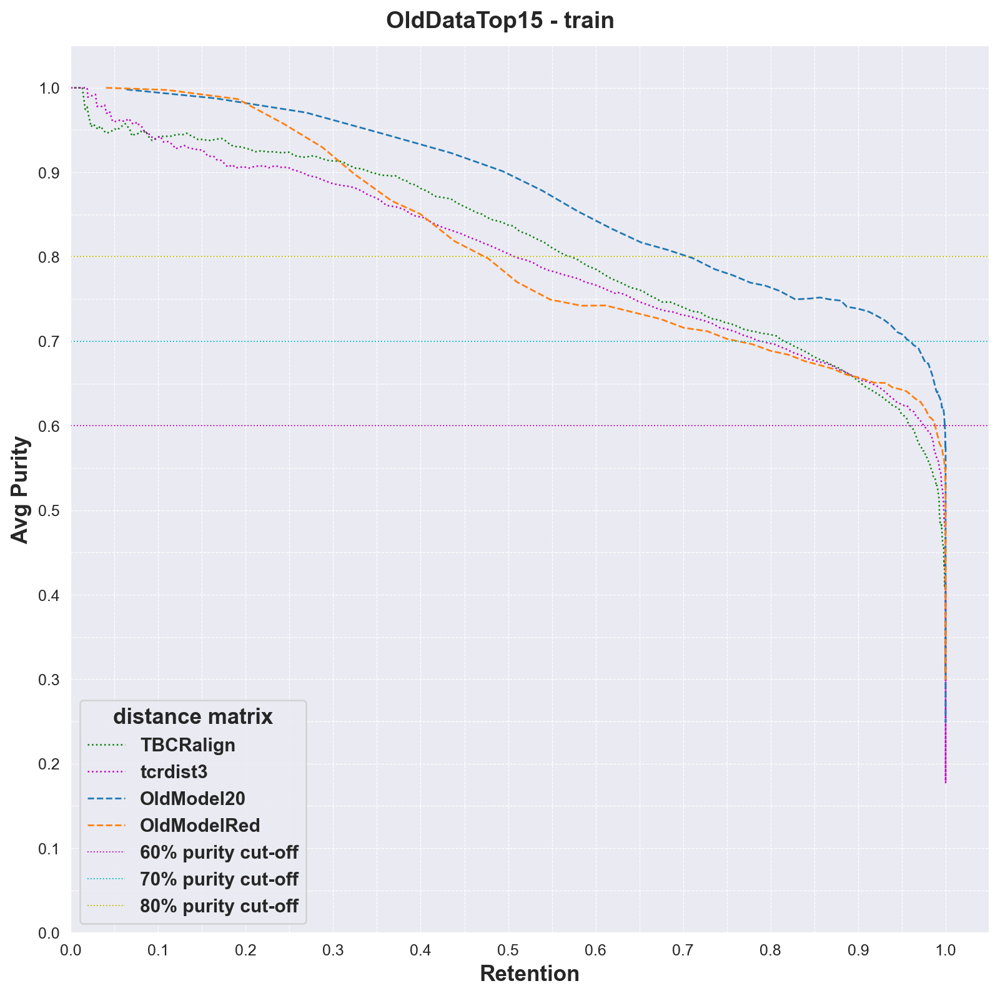

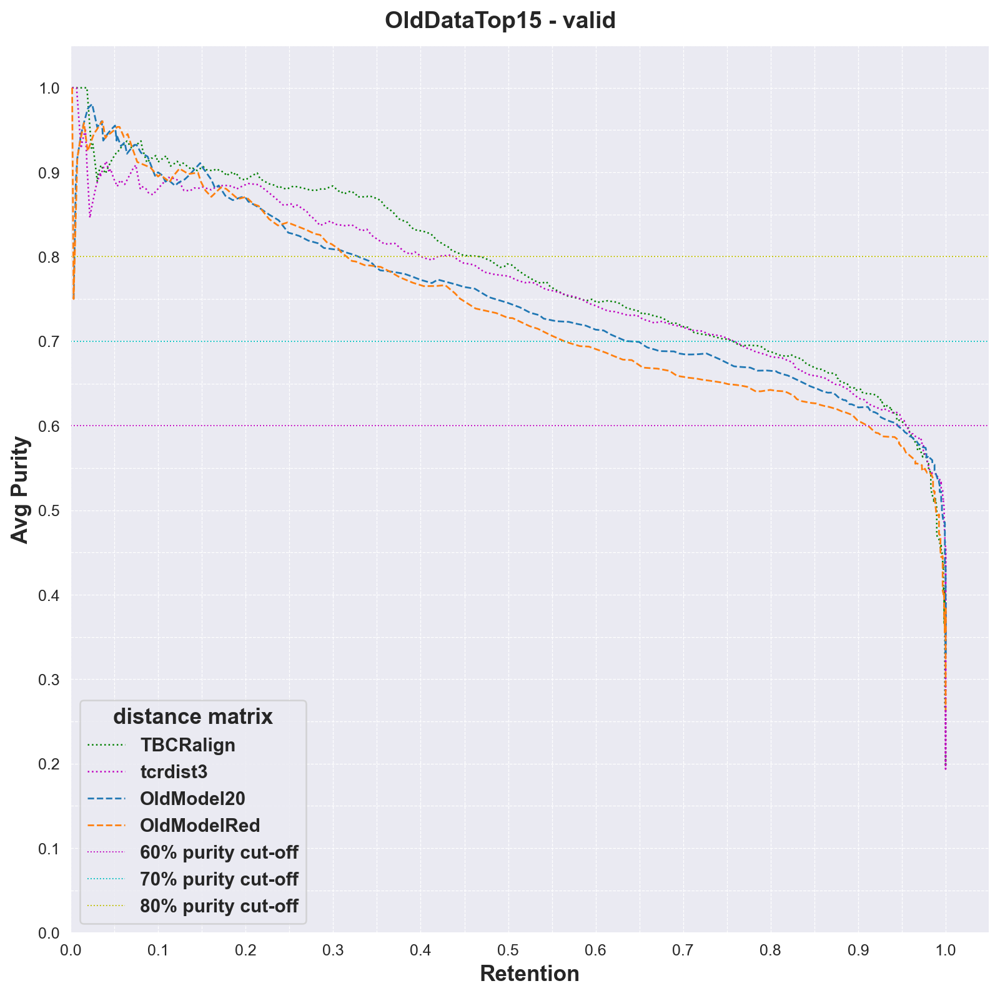

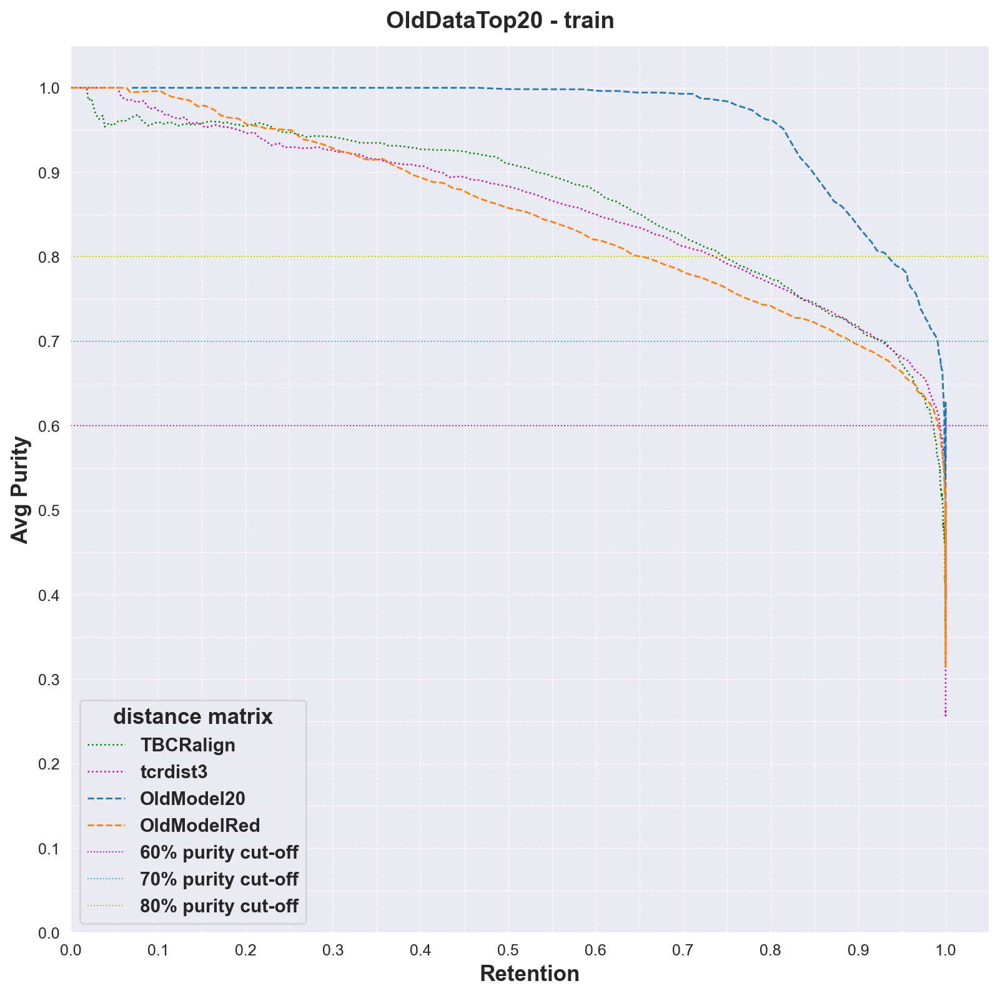

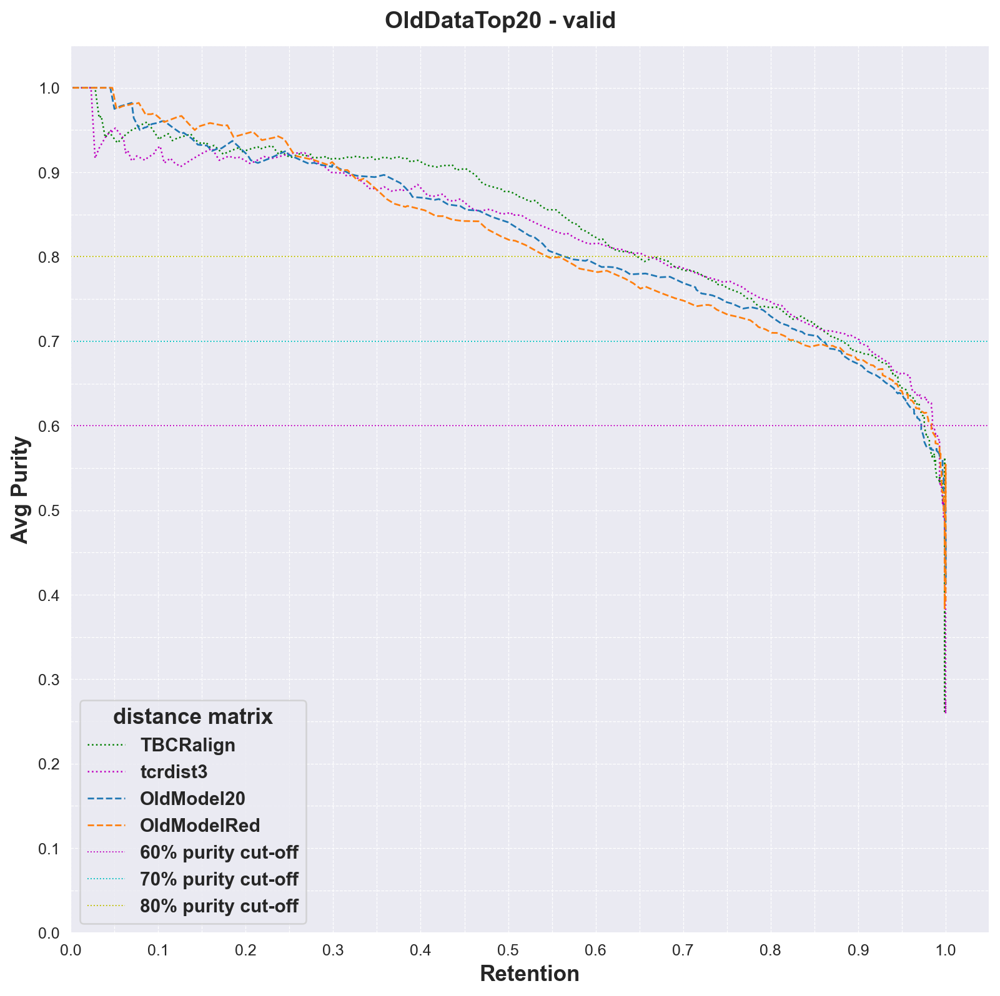

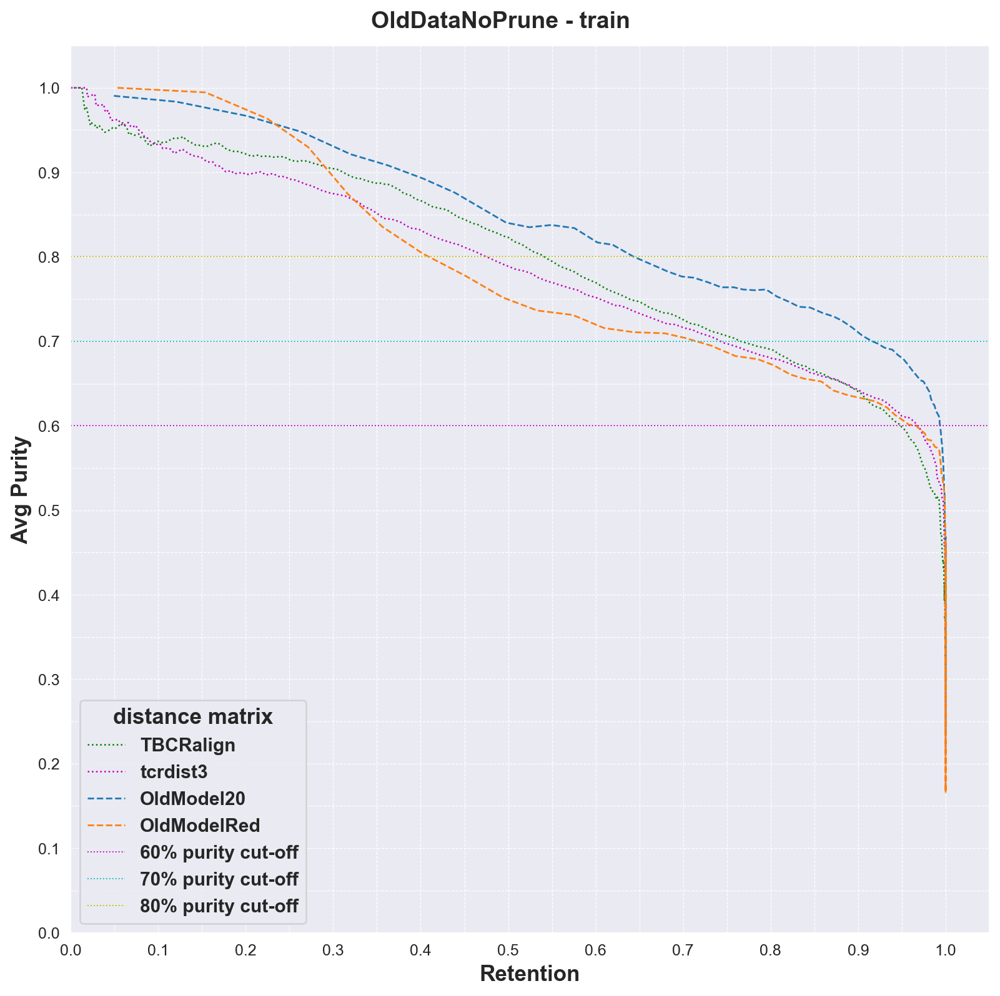

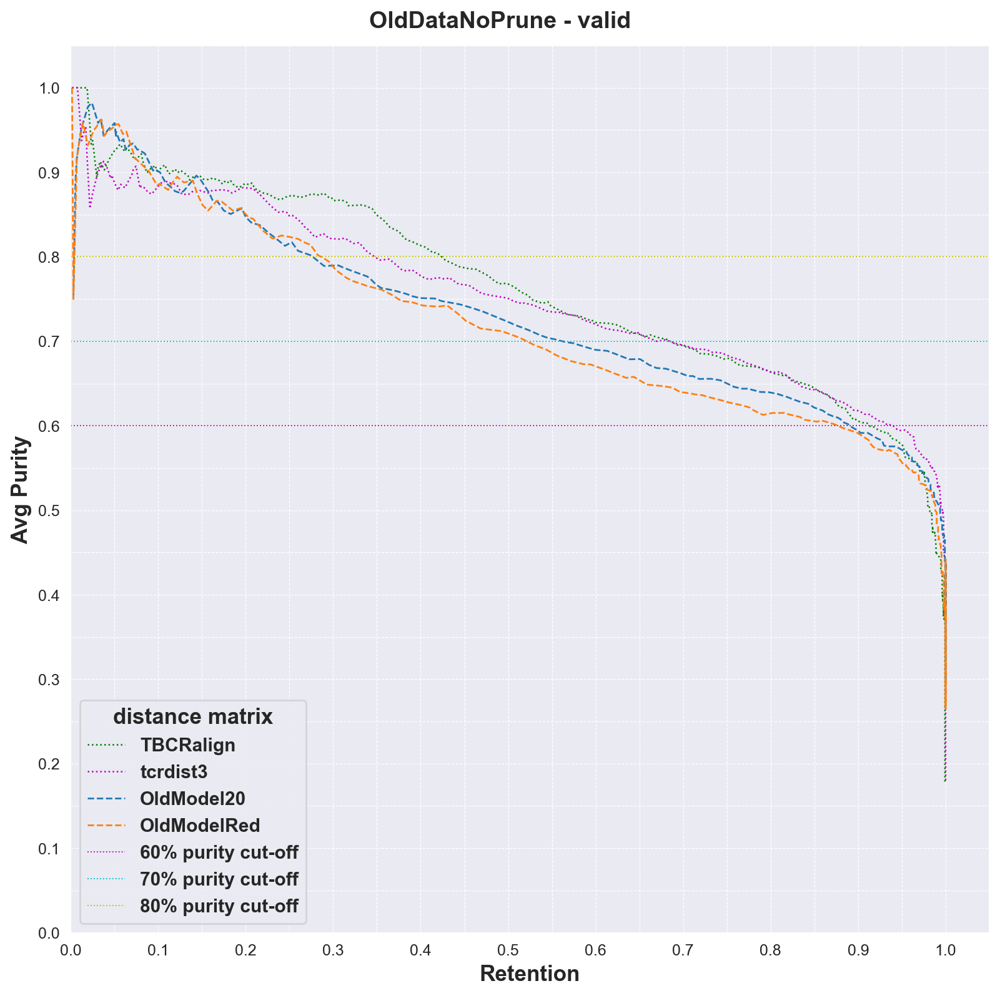

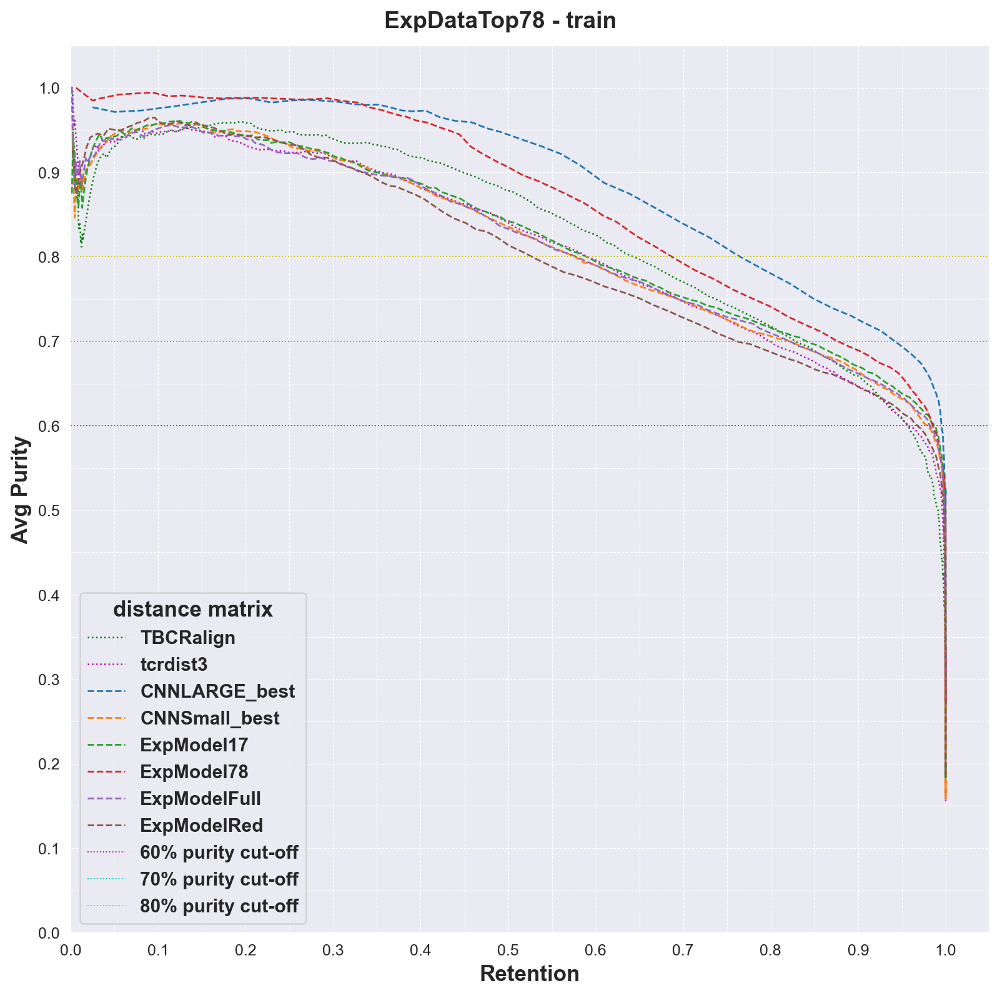

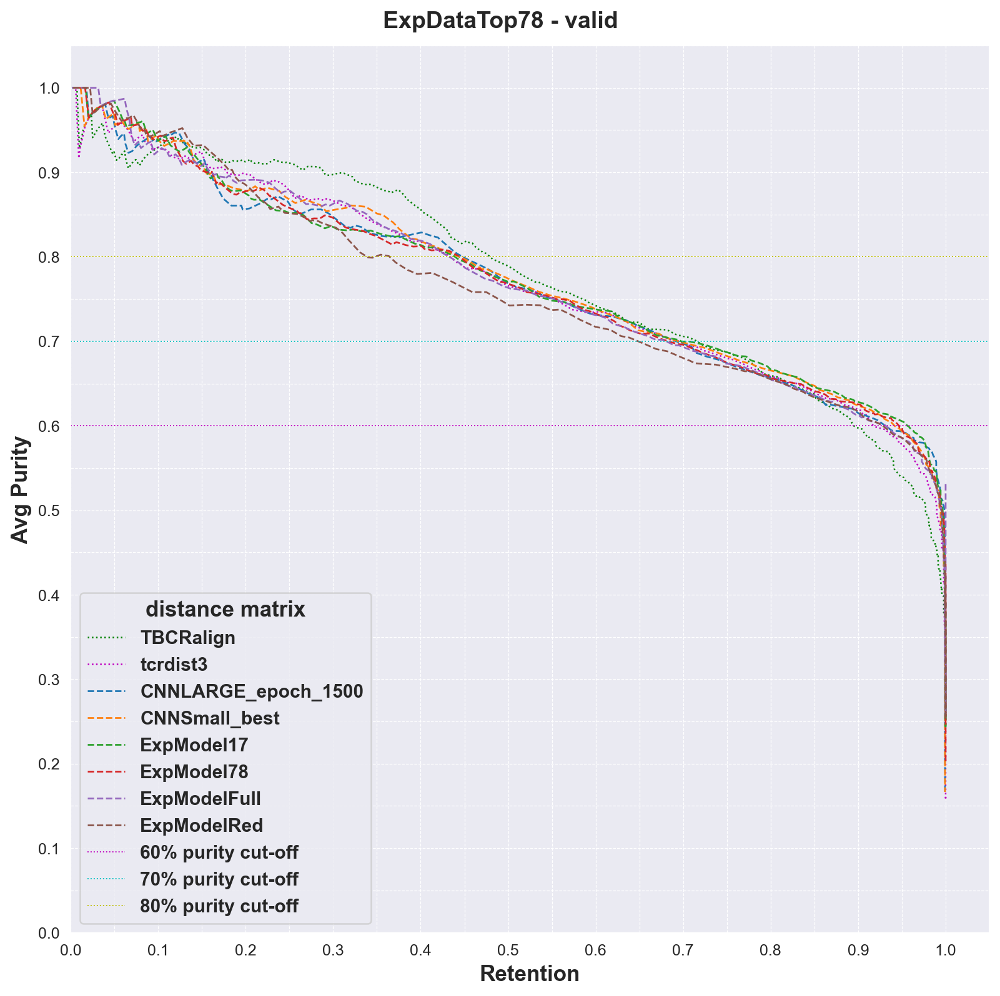

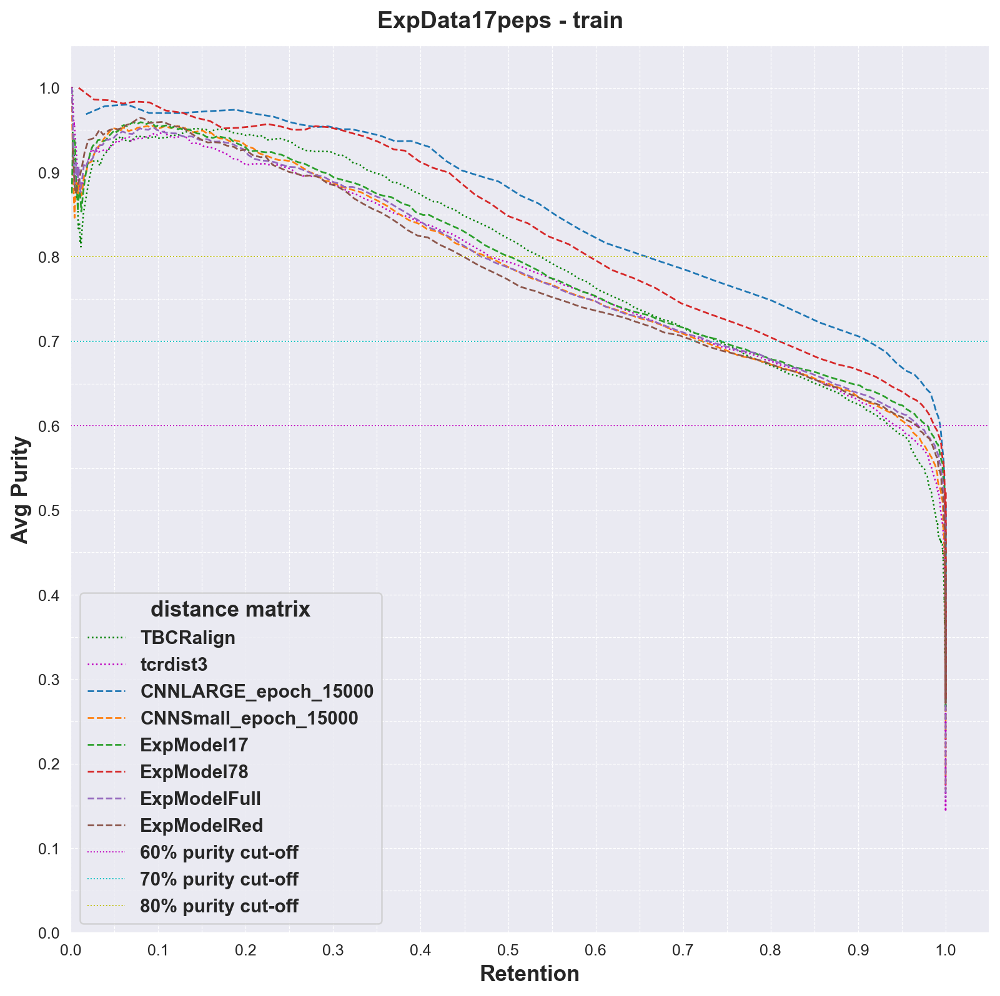

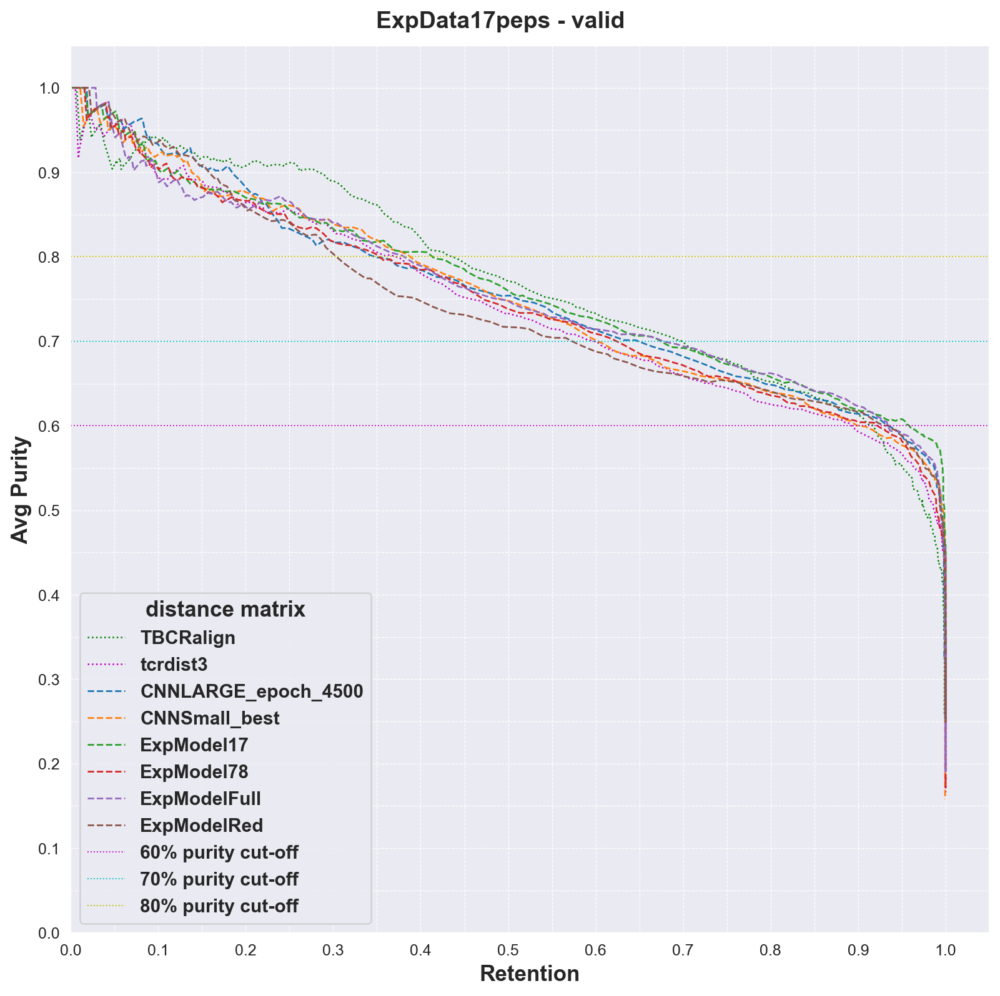

In [111]:
prune_results = {}
savedir = f'../output/240515_IntervalClustering/figs/'
mkdirs(savedir)
for k in ['OldDataTop15', 'OldDataTop20' ,'OldDataNoPrune', 'ExpDataTop78', 'ExpData17peps']:
    prune_results[k] = {}
    for set in ['train', 'valid']:
        prune_results[k][set] = get_best_given_dir(f'../output/240515_IntervalClustering/{k}/', set, k).query('not input_type.str.startswith("_OLD")')
        prune_results[k][set].input_type = prune_results[k][set].input_type.apply(lambda x: x.split('_'+k)[0])
        plot_pipeline_all(prune_results[k][set], f'{k} - {set}', f'{savedir}{k}_{set}', 'tab10')

In [199]:
tr=pd.read_csv('../output/240515_IntervalClustering/train_baselines.csv')
tr.db.unique()

array(['OldDataTop15', 'ExpDataTop78', 'OldDataTop20', 'OldDataNoPrune',
       'ExpData17peps'], dtype=object)

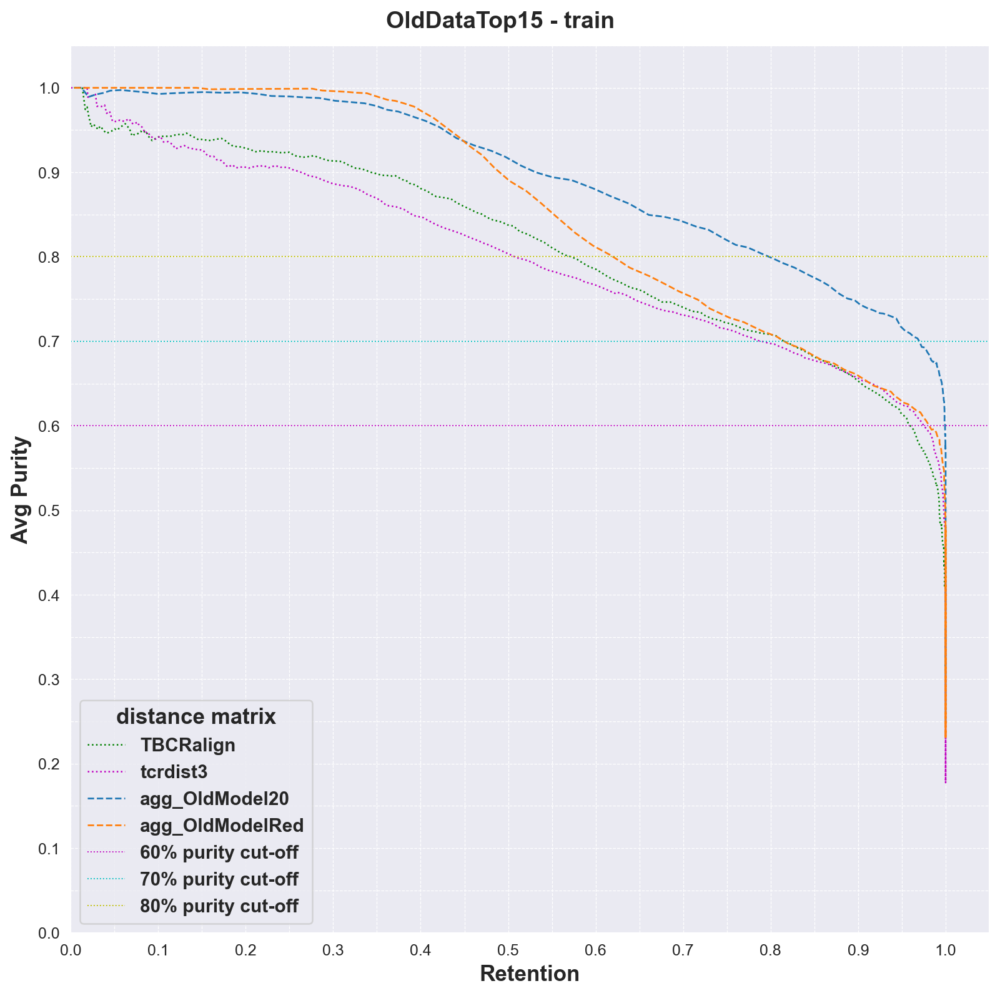

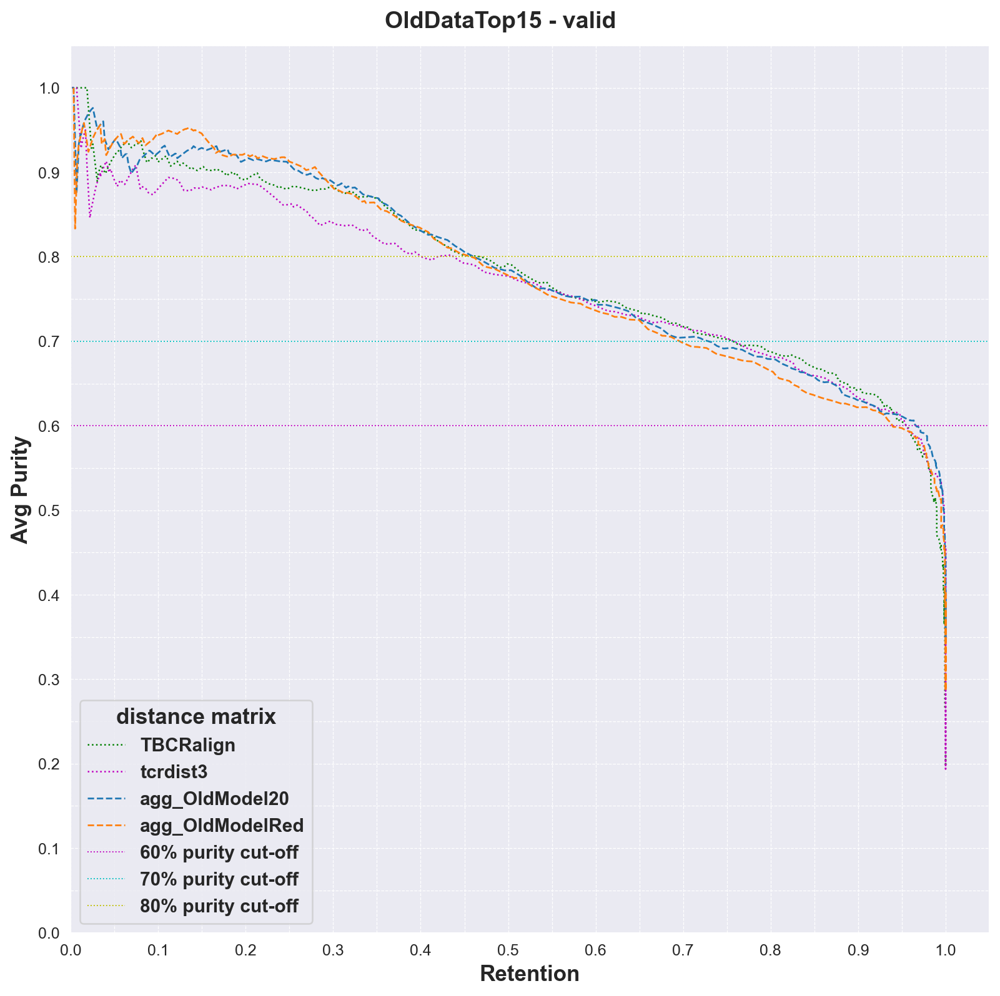

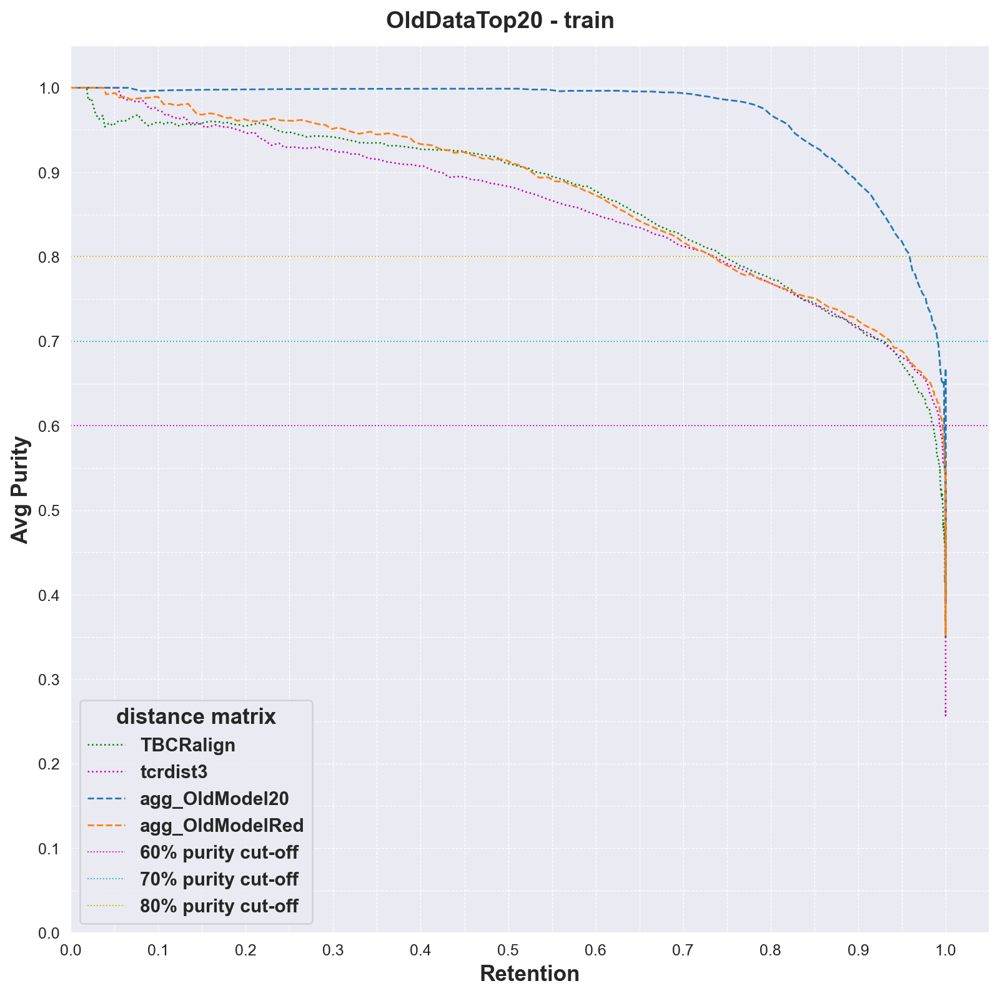

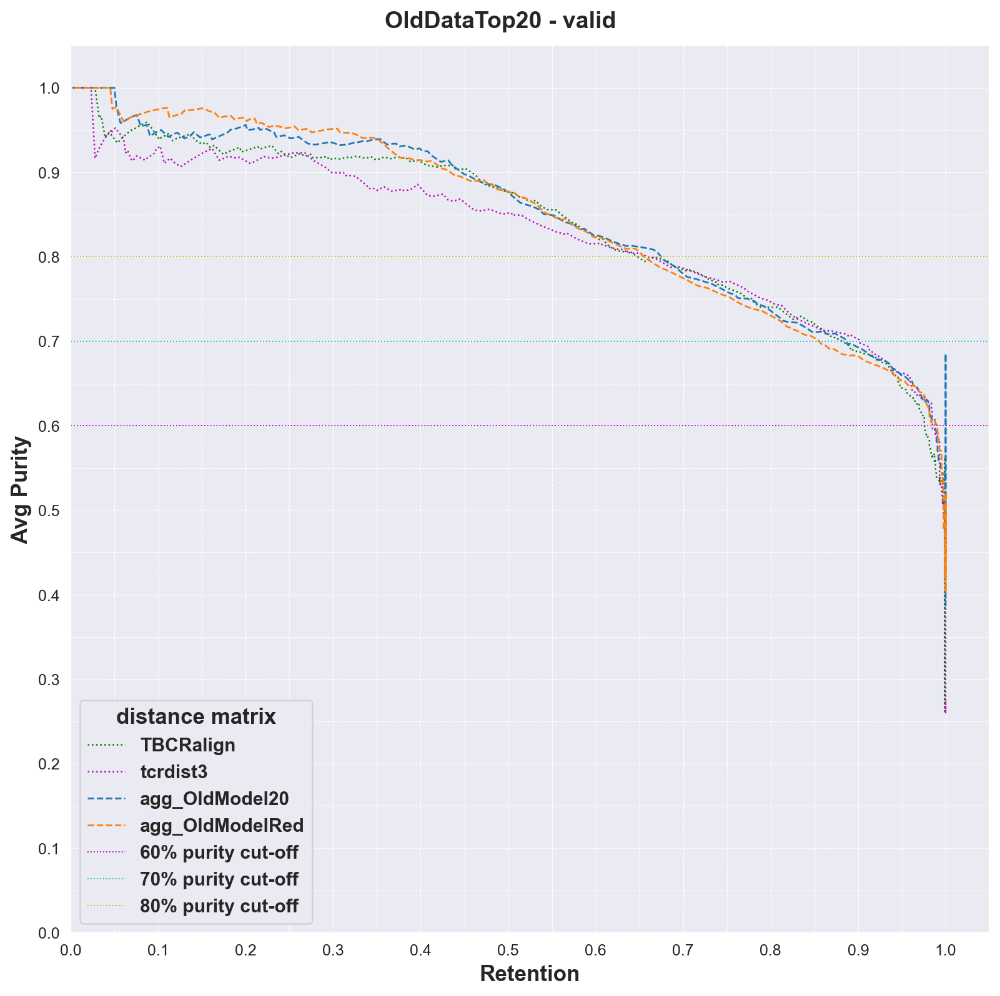

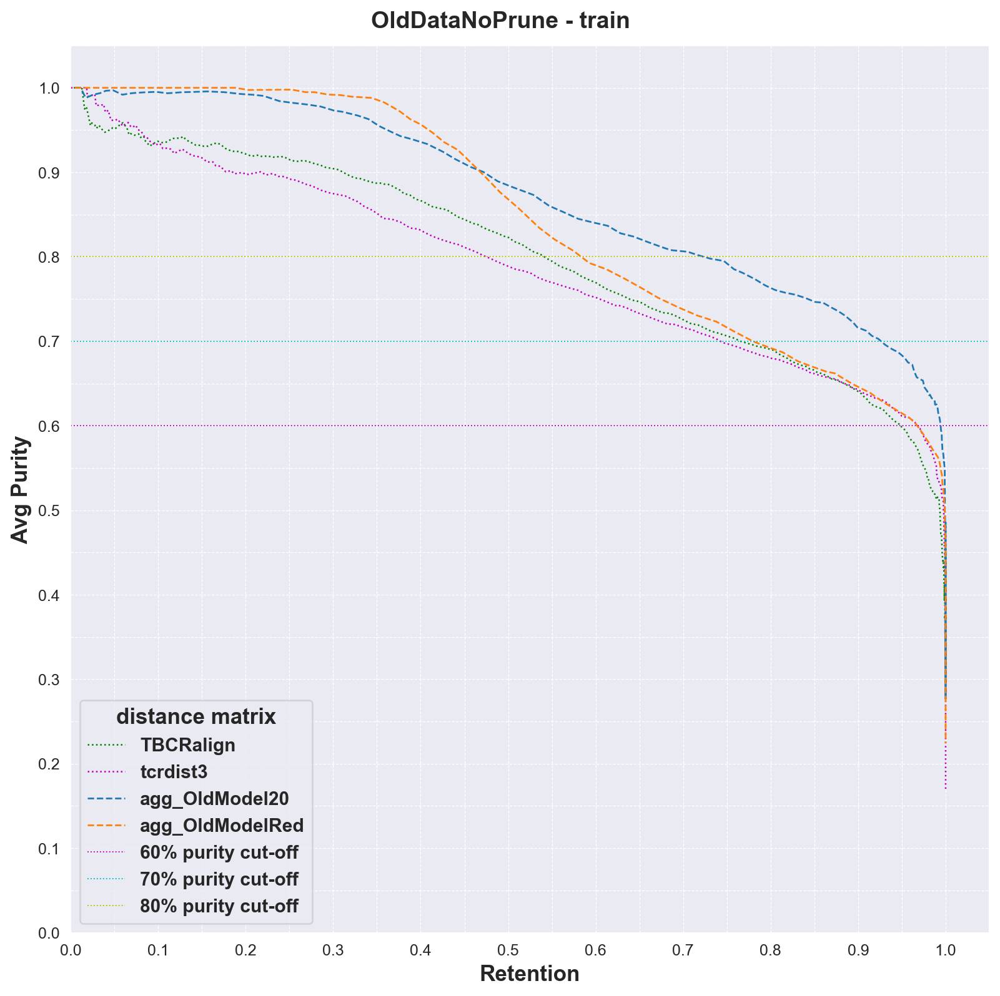

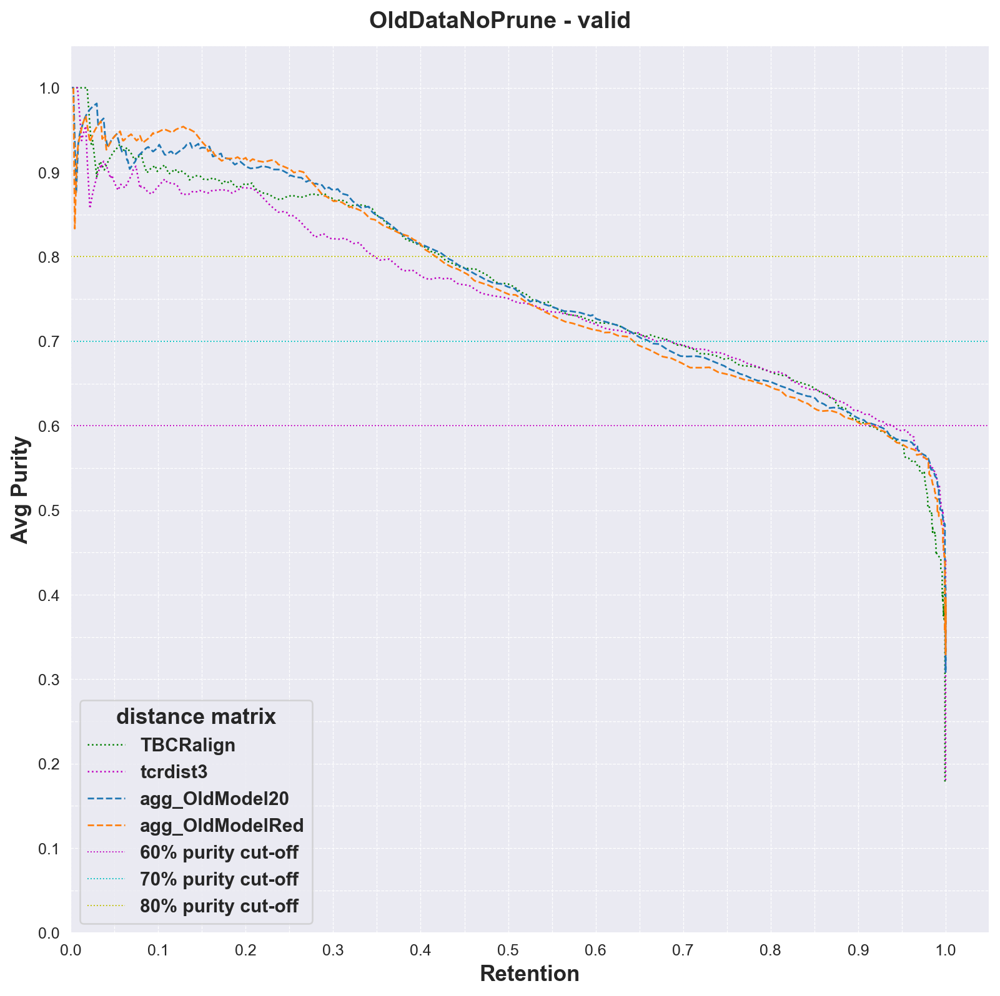

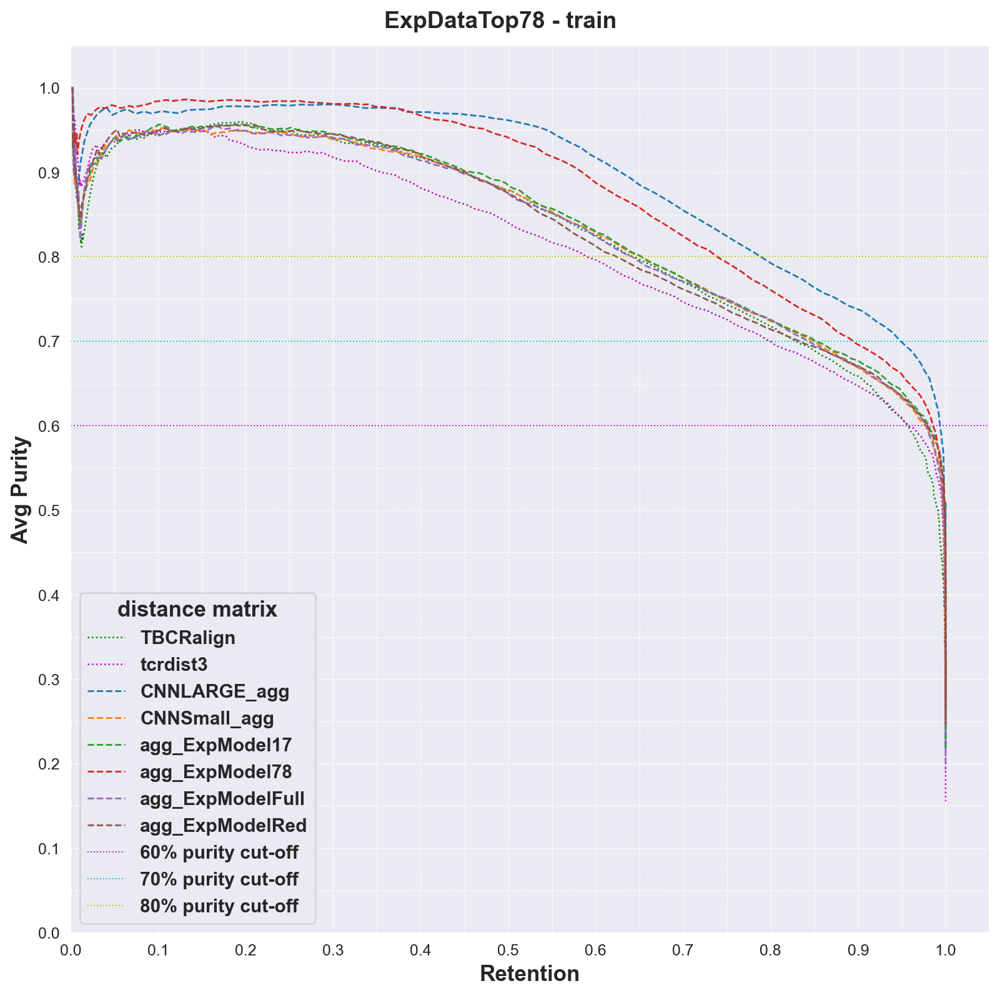

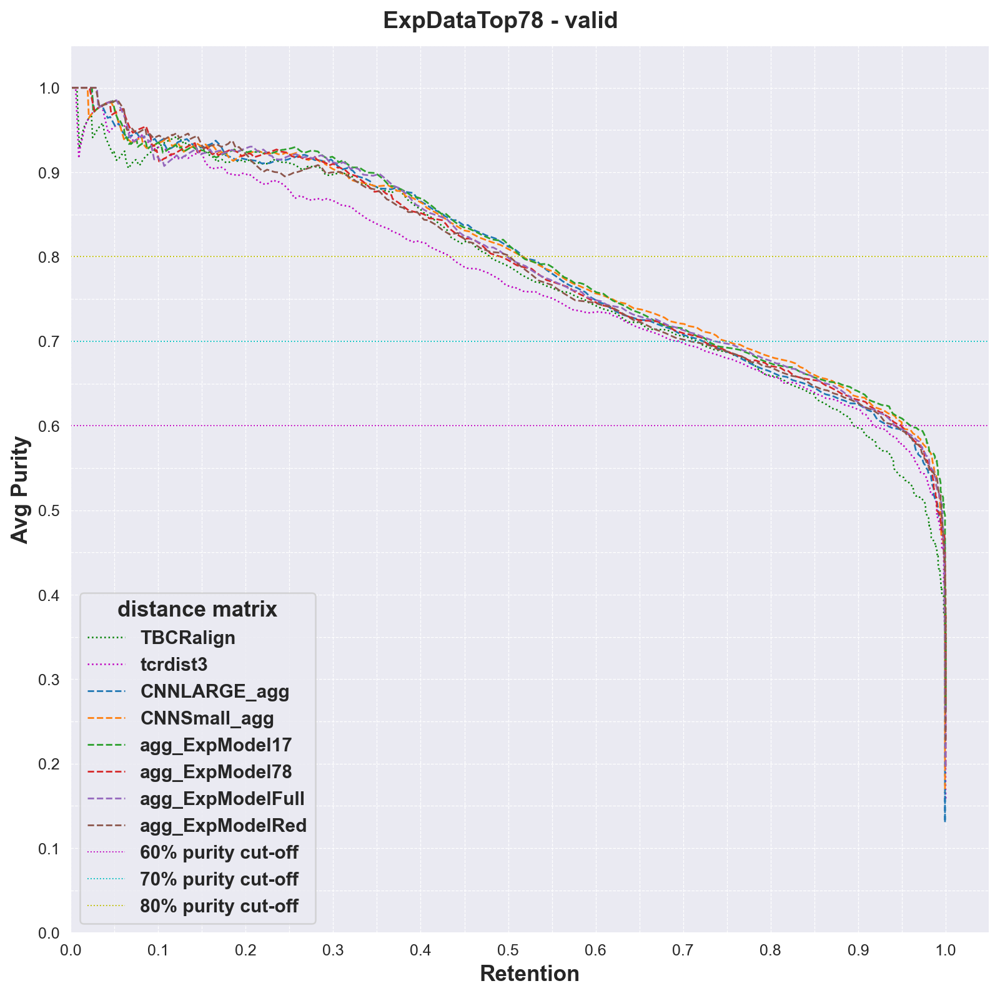

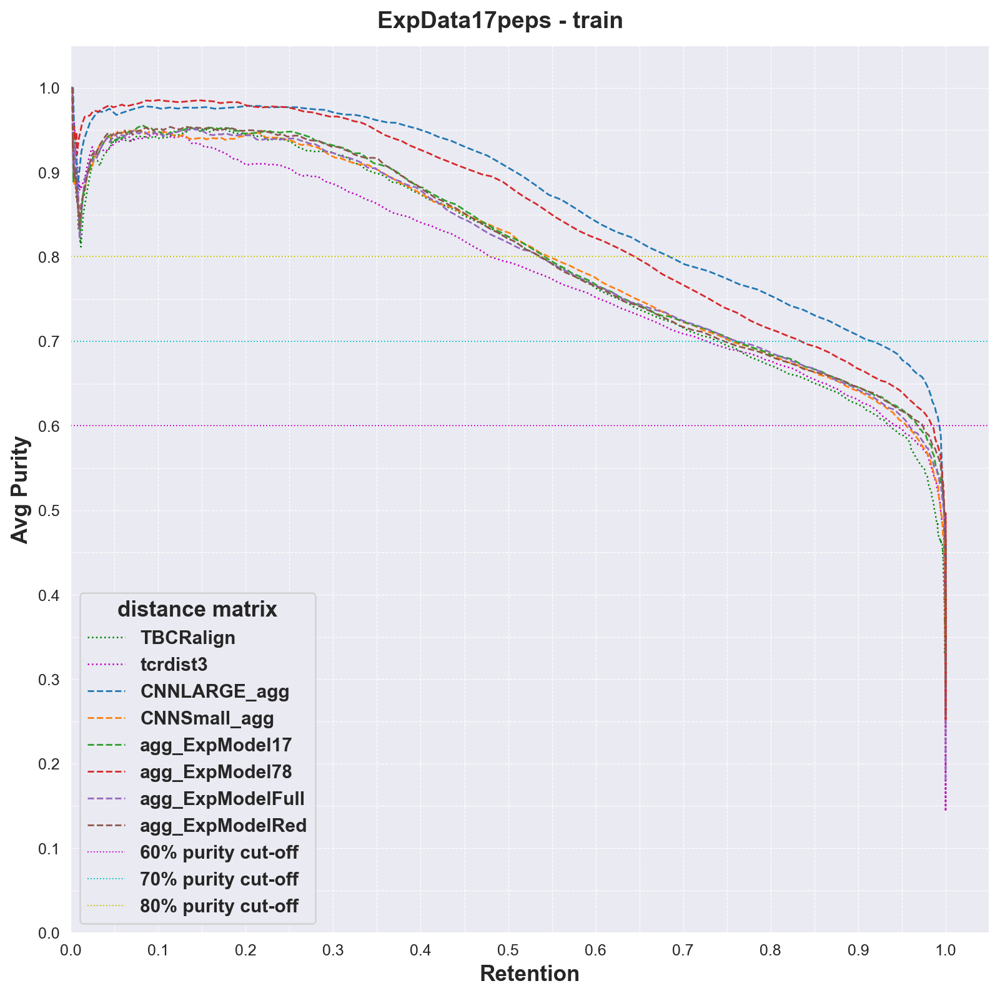

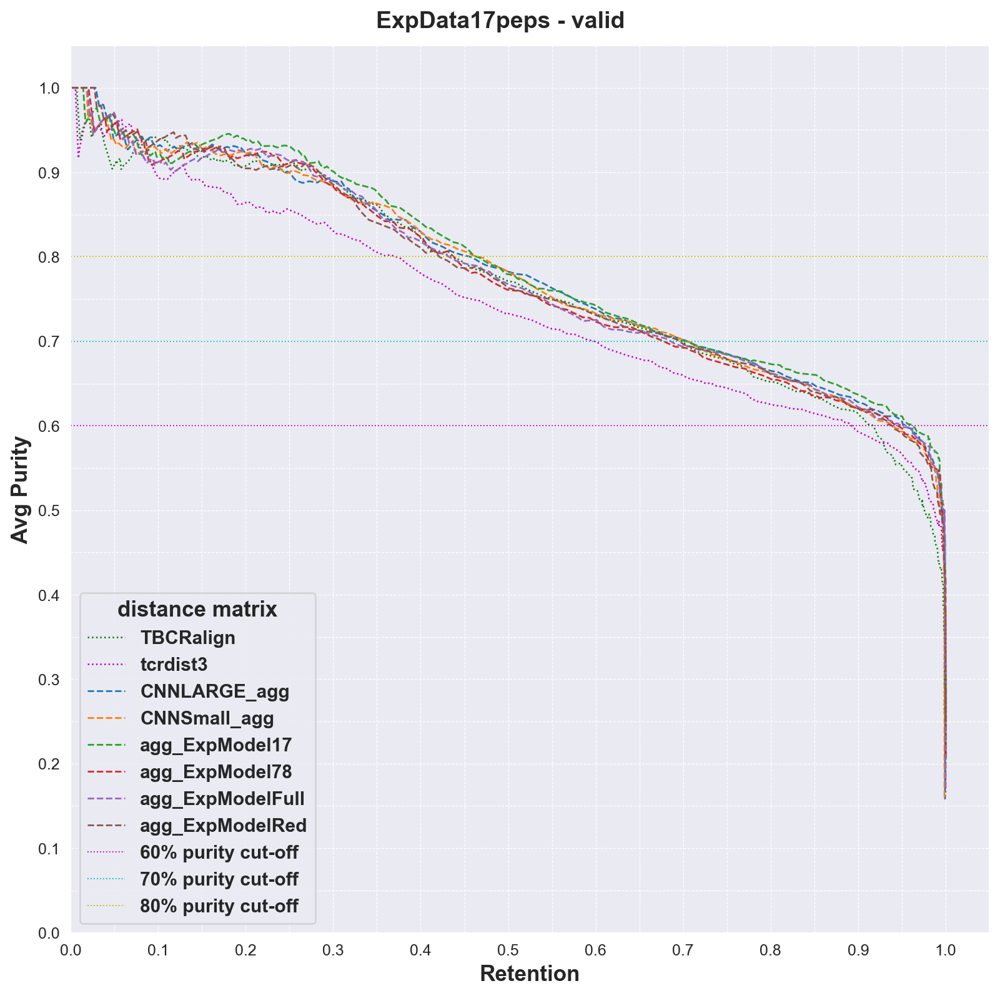

In [115]:
prune_agg_results = {}
savedir = f'../output/240515_IntervalClustering/figs/'
mkdirs(savedir)
for k in ['OldDataTop15', 'OldDataTop20' ,'OldDataNoPrune', 'ExpDataTop78', 'ExpData17peps']:
    prune_agg_results[k] = {}
    for set in ['train', 'valid']:
        prune_agg_results[k][set] = get_agg_given_dir(f'../output/240515_IntervalClustering/{k}/', set, k).query('not input_type.str.startswith("_OLD")')
        prune_agg_results[k][set].input_type = prune_agg_results[k][set].input_type.apply(lambda x: x.split('_'+k)[0])
        plot_pipeline_all(prune_agg_results[k][set], f'{k} - {set}', f'{savedir}AggModels_{k}_{set}', 'tab10')

In [6]:
def get_best_given_dir_tt(maindir, set, idf):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}*.csv') if '_OLD_' not in x]
    names = [x.split('/')[-1].split('_24')[0].replace('TripletTweak','').replace('Expanded','').replace('OldPruned','').replace('Exp17Peps','').replace('ExpData17peps','').replace('OldDataNoPrune','').replace('OldFull','').replace('Old20peps','').replace('OldDataTop20','').lstrip('_') for x in folders]
    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    baselines['name'] = ''
    out = pd.concat([baselines] + [find_best_not_agg(pd.read_csv(x)).assign(name=z) for x,z in zip(folders,names)]).assign(identifier=idf)
    out['input_type'] = out['name']+out['input_type']

    return out
    
def get_agg_given_dir_tt(maindir, set, idf):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}*.csv') if '_OLD_' not in x]
    # names = ['_'.join(x.split('/')[-1].split('_24')[0].split('_')[3:]) for x in folders]
    names = [x.split('/')[-1].split('_24')[0].replace('TripletTweak','').replace('Expanded','').replace('OldPruned','').replace('Exp17Peps','').replace('ExpData17peps','').replace('OldDataNoPrune','').replace('OldFull','').replace('Old20peps','').replace('OldDataTop20','').lstrip('_') for x in folders]
    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    baselines['name'] = ''
    out = pd.concat([baselines] + [find_agg(x).assign(name=z) for x,z in zip(folders,names)]).assign(identifier=idf)
    out['input_type'] = out['name']+out['input_type']
    
    return out
    

In [7]:
def sampler_train_valid_comparison(maindir, name=None, savedir='../output/240516_TripletTweaks_IntervalClustering/figs/'):
    if name is None: name=maindir.rstrip('/').split('/')[-1]
    train_sampler_fn = glob.glob(f'{maindir}/*CDFalse_WUFalse_SamplerTrue_P1N1*/*train*.csv')[0]
    valid_sampler_fn = glob.glob(f'{maindir}/*CDFalse_WUFalse_SamplerTrue_P1N1*/*valid*.csv')[0]
    train_nosampler_fn = glob.glob(f'{maindir}/*CDFalse_WUFalse_SamplerFalse_P1N1*/*train*.csv')[0]
    valid_nosampler_fn = glob.glob(f'{maindir}/*CDFalse_WUFalse_SamplerFalse_P1N1*/*valid*.csv')[0]
    train_baseline = pd.read_csv(train_sampler_fn).query('input_type=="TBCRalign" or input_type=="tcrdist3"')
    valid_baseline = pd.read_csv(valid_sampler_fn).query('input_type=="TBCRalign" or input_type=="tcrdist3"')

    train_sampler = find_best_not_agg(pd.read_csv(train_sampler_fn)).assign(input_type='sampler')
    valid_sampler = find_best_not_agg(pd.read_csv(valid_sampler_fn)).assign(input_type='sampler')
    train_nosampler = find_best_not_agg(pd.read_csv(train_nosampler_fn)).assign(input_type='nosampler')
    valid_nosampler = find_best_not_agg(pd.read_csv(valid_nosampler_fn)).assign(input_type='nosampler')
    train = pd.concat([train_baseline, train_sampler, train_nosampler])
    valid = pd.concat([valid_baseline, valid_sampler, valid_nosampler])
    print(f'\nwtfHERE*******\n\n\n\n{name}\n\n\n\n******WTF')
    print(train_sampler_fn)
    print(valid_sampler_fn)
    print(train_nosampler_fn)
    print(valid_nosampler_fn)
    
    plot_pipeline_all(train, f'Train - {name}', f'{savedir}bestmodel_{name}_samplerComparisonTrain', 'tab10')
    plot_pipeline_all(valid, f'Valid - {name}', f'{savedir}bestmodel_{name}_samplerComparisonValid', 'tab10')                                 
    
    
    

In [8]:
def sampler_cnn_train_valid_comparison(maindir, name=None, savedir='../output/240516_TripletTweaks_IntervalClustering/figs/'):
    if name is None: name=maindir.rstrip('/').split('/')[-1]
    train_sampler_fn = glob.glob(f'{maindir}/*CDFalse_WUFalse_SamplerTrue_P1N1*/*train*.csv')[0]
    valid_sampler_fn = glob.glob(f'{maindir}/*CDFalse_WUFalse_SamplerTrue_P1N1*/*valid*.csv')[0]
    train_nosampler_fn = glob.glob(f'{maindir}/*CDFalse_WUFalse_SamplerFalse_P1N1*/*train*.csv')[0]
    valid_nosampler_fn = glob.glob(f'{maindir}/*CDFalse_WUFalse_SamplerFalse_P1N1*/*valid*.csv')[0]
    cnn_train_large_fn = [x for x in glob.glob(f'{maindir}/*CNNVAE_*/*train*.csv') if 'LARGER' in x][0]
    cnn_train_small_fn = [x for x in glob.glob(f'{maindir}/*CNNVAE_*/*train*.csv') if 'Small' in x][0]
    
    train_baseline = pd.read_csv(train_sampler_fn).query('input_type=="TBCRalign" or input_type=="tcrdist3"')
    valid_baseline = pd.read_csv(valid_sampler_fn).query('input_type=="TBCRalign" or input_type=="tcrdist3"')

    train_sampler = find_best_not_agg(pd.read_csv(train_sampler_fn)).assign(input_type='sampler')
    valid_sampler = find_best_not_agg(pd.read_csv(valid_sampler_fn)).assign(input_type='sampler')
    train_nosampler = find_best_not_agg(pd.read_csv(train_nosampler_fn)).assign(input_type='nosampler')
    valid_nosampler = find_best_not_agg(pd.read_csv(valid_nosampler_fn)).assign(input_type='nosampler')
    train = pd.concat([train_baseline, train_sampler, train_nosampler])
    valid = pd.concat([valid_baseline, valid_sampler, valid_nosampler])
    print(f'\nwtfHERE*******\n\n\n\n{name}\n\n\n\n******WTF')
    print(train_sampler_fn)
    print(valid_sampler_fn)
    print(train_nosampler_fn)
    print(valid_nosampler_fn)
    
    plot_pipeline_all(train, f'Train - {name}', f'{savedir}bestmodel_{name}_samplerComparisonTrain', 'tab10')
    plot_pipeline_all(valid, f'Valid - {name}', f'{savedir}bestmodel_{name}_samplerComparisonValid', 'tab10')                                 
    
    
    


wtfHERE*******



Old20peps



******WTF
../output/240516_TripletTweaks_IntervalClustering/Old20peps/CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_old_pruned_noswap_20peps_240516_1334_None/Old20peps_TripletTweak_OldPruned_CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_old_pruned_noswap_20peps_240516_1334_None_train_results.csv
../output/240516_TripletTweaks_IntervalClustering/Old20peps/CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_old_pruned_noswap_20peps_240516_1334_None/Old20peps_TripletTweak_OldPruned_CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_old_pruned_noswap_20peps_240516_1334_None_valid_results.csv
../output/240516_TripletTweaks_IntervalClustering/Old20peps/CDFalse_WUFalse_SamplerFalse_P1N1_240507_nettcr_old_pruned_noswap_20peps_240516_1528_None/Old20peps_TripletTweak_OldPruned_CDFalse_WUFalse_SamplerFalse_P1N1_240507_nettcr_old_pruned_noswap_20peps_240516_1528_None_train_results.csv
../output/240516_TripletTweaks_IntervalClustering/Old20peps/CDFalse_WUFalse_SamplerFalse_

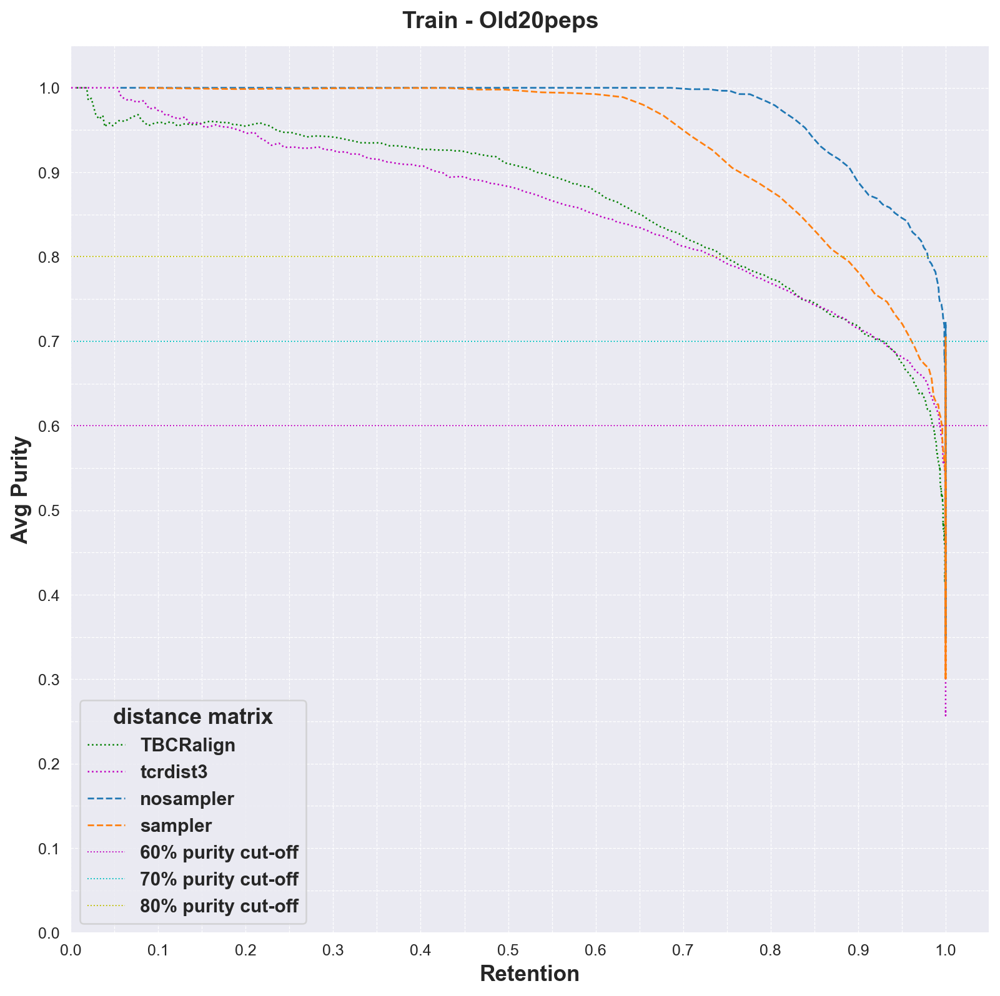

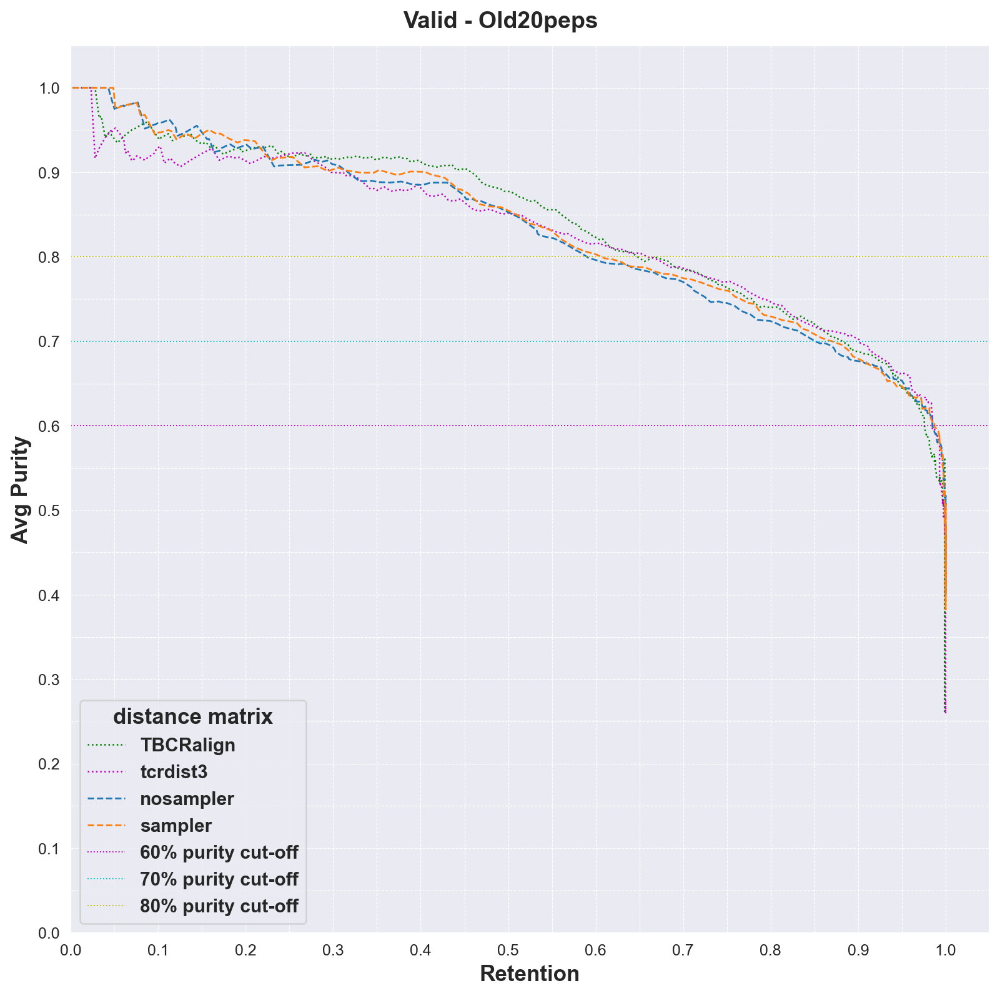

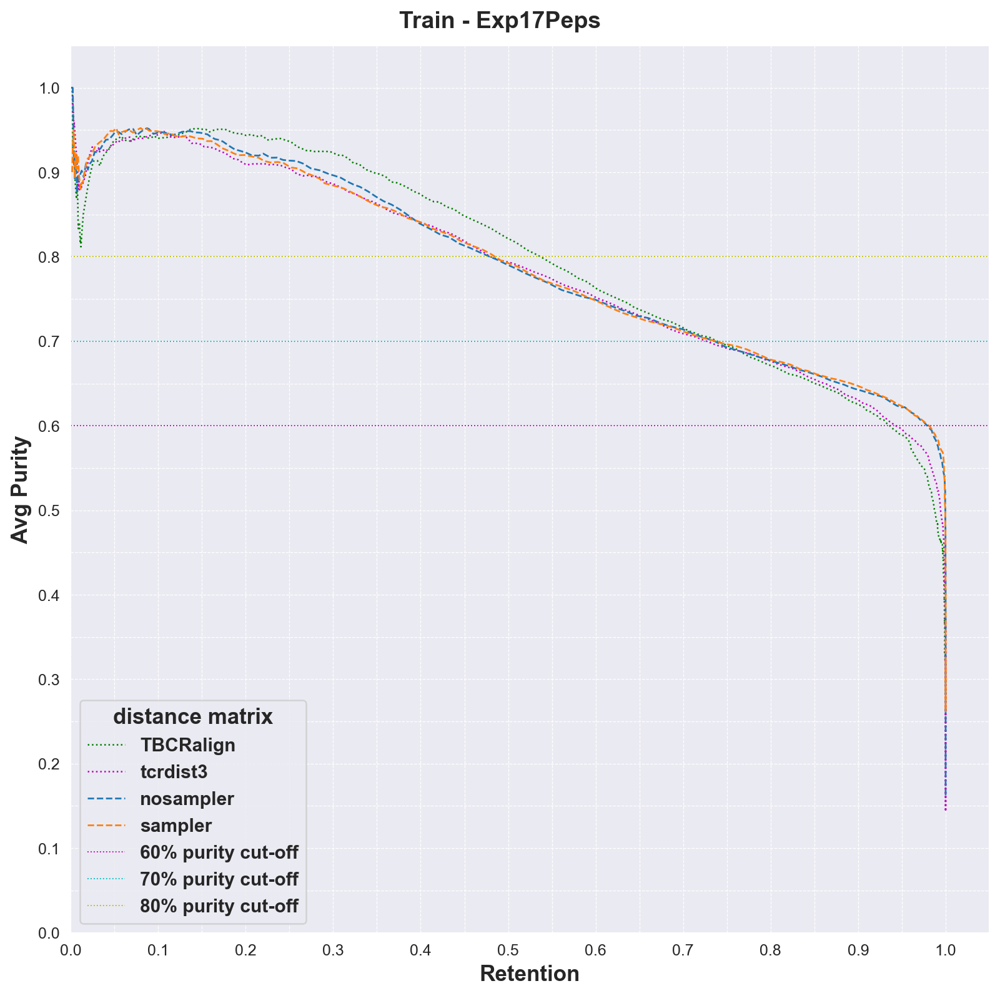

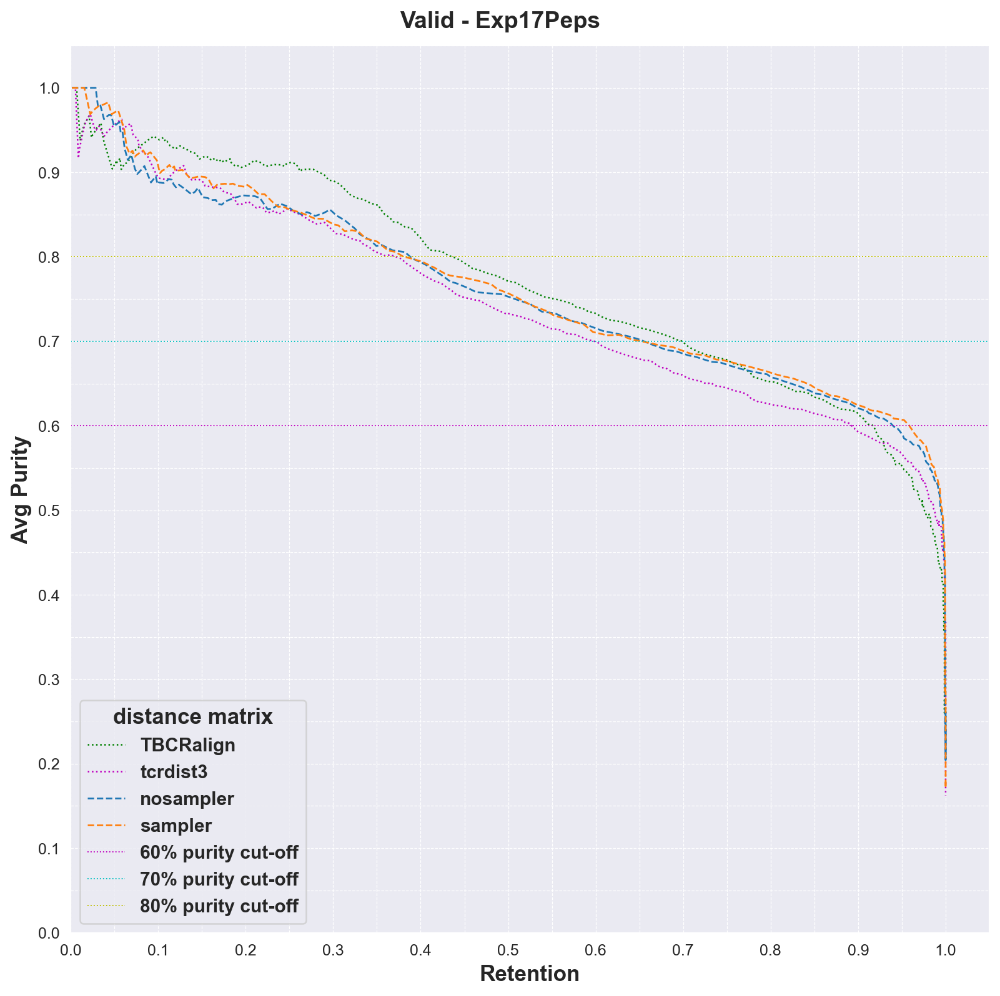

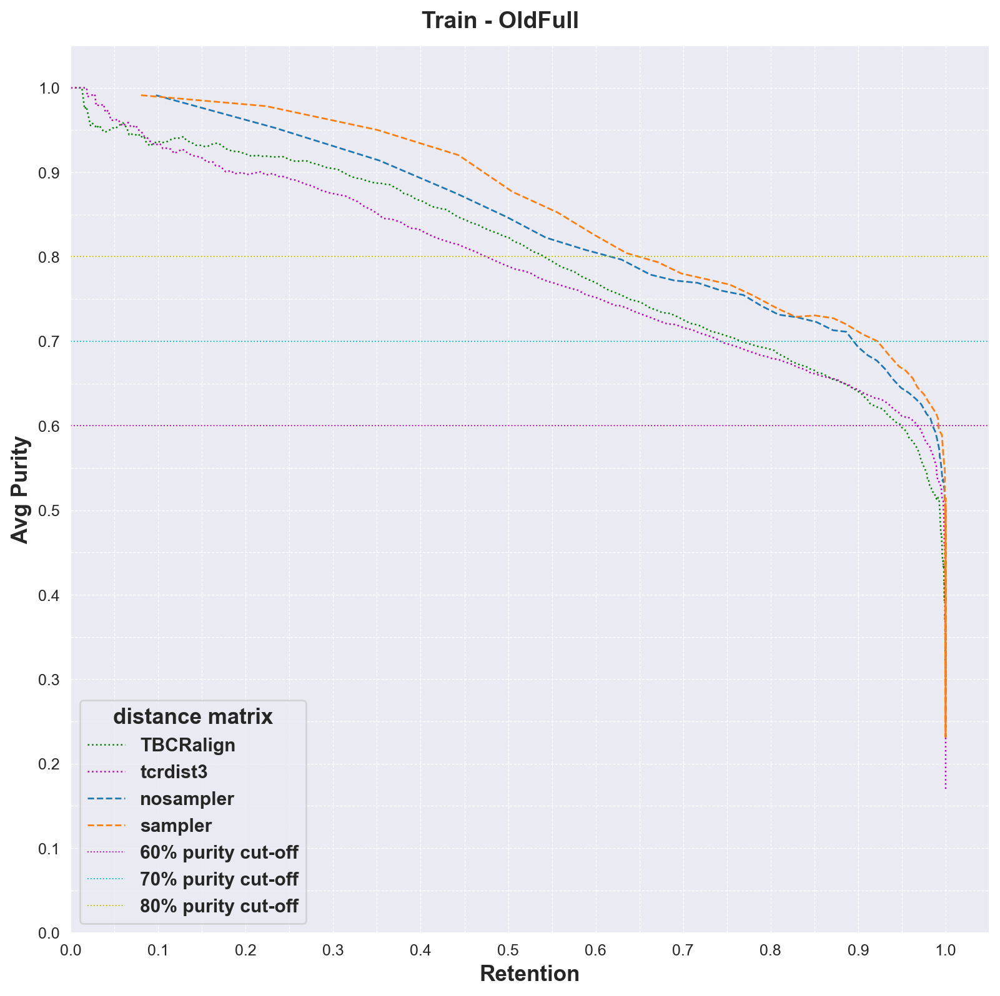

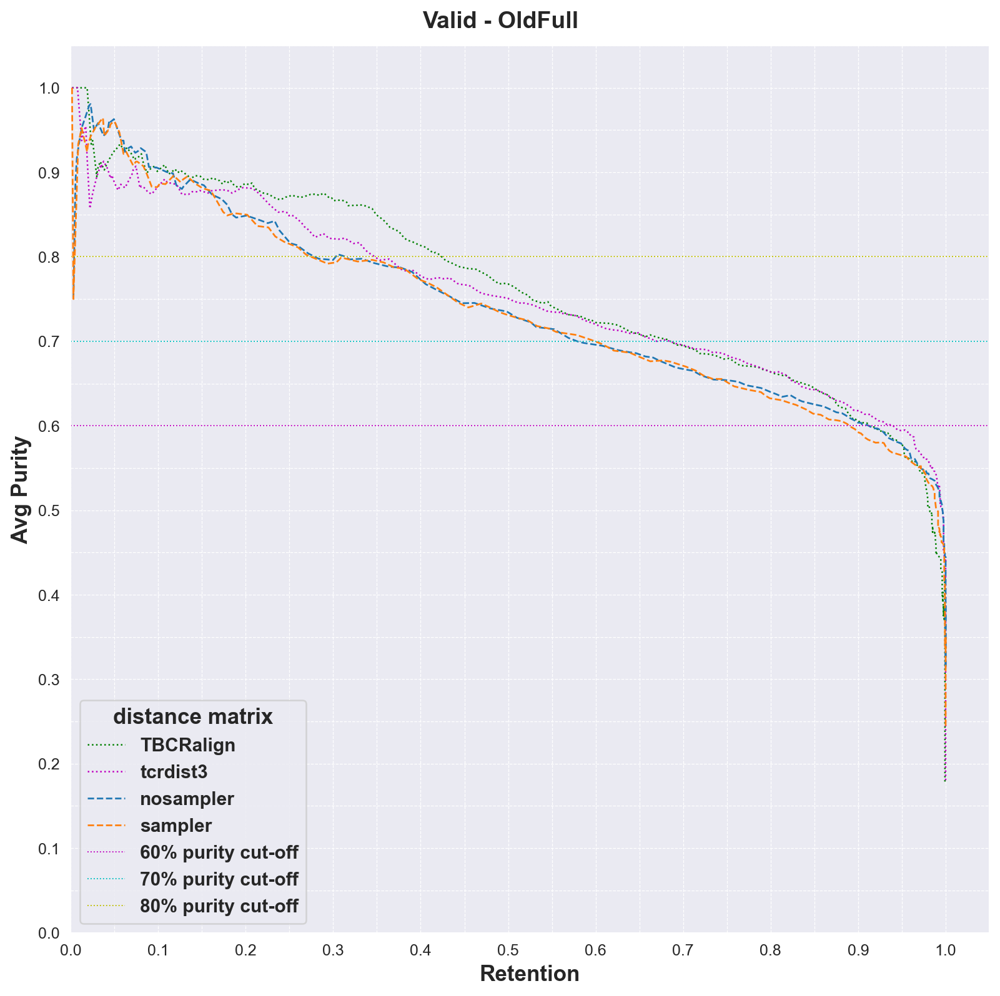

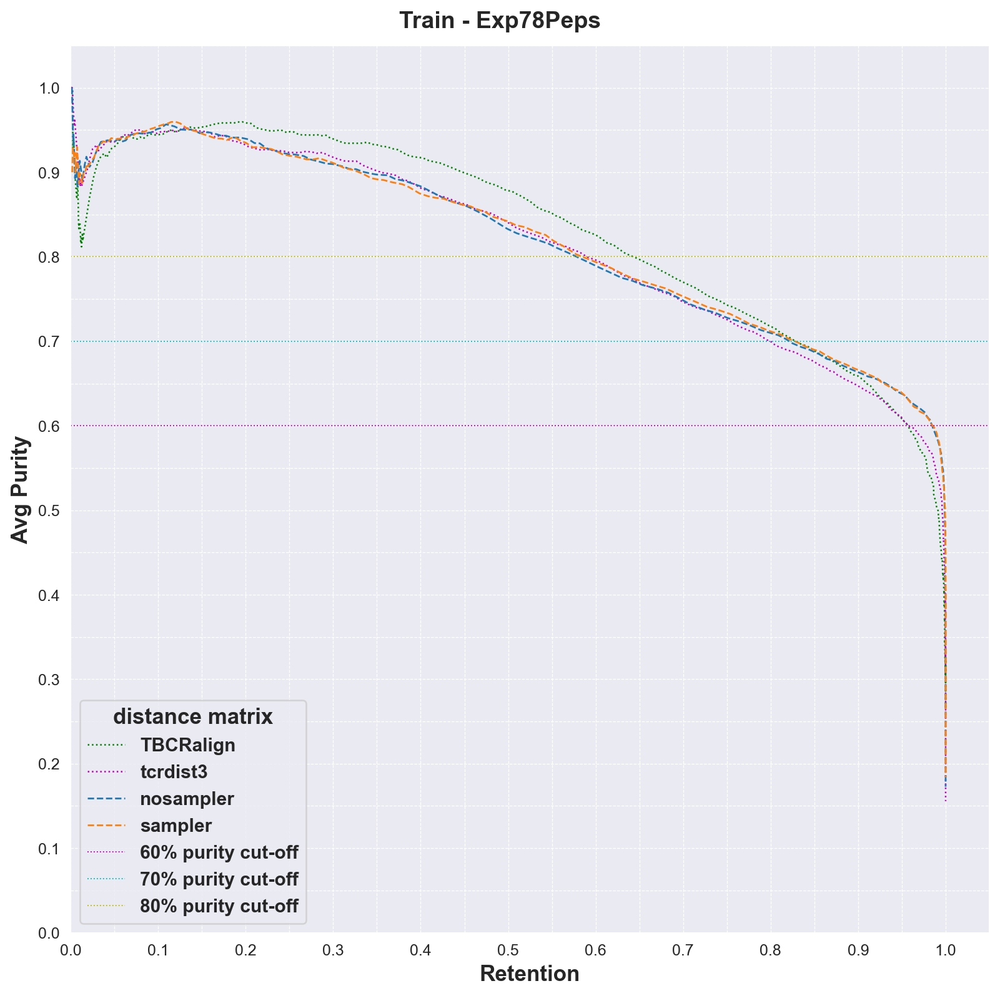

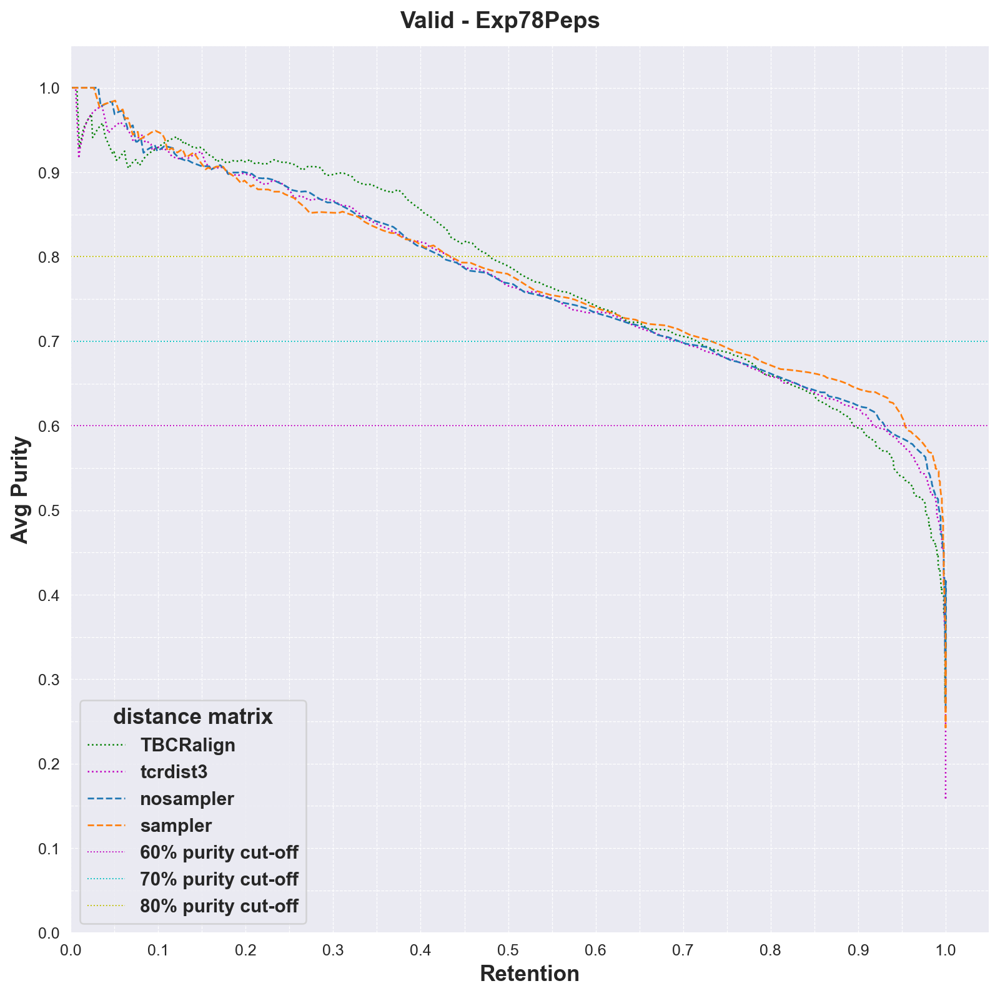

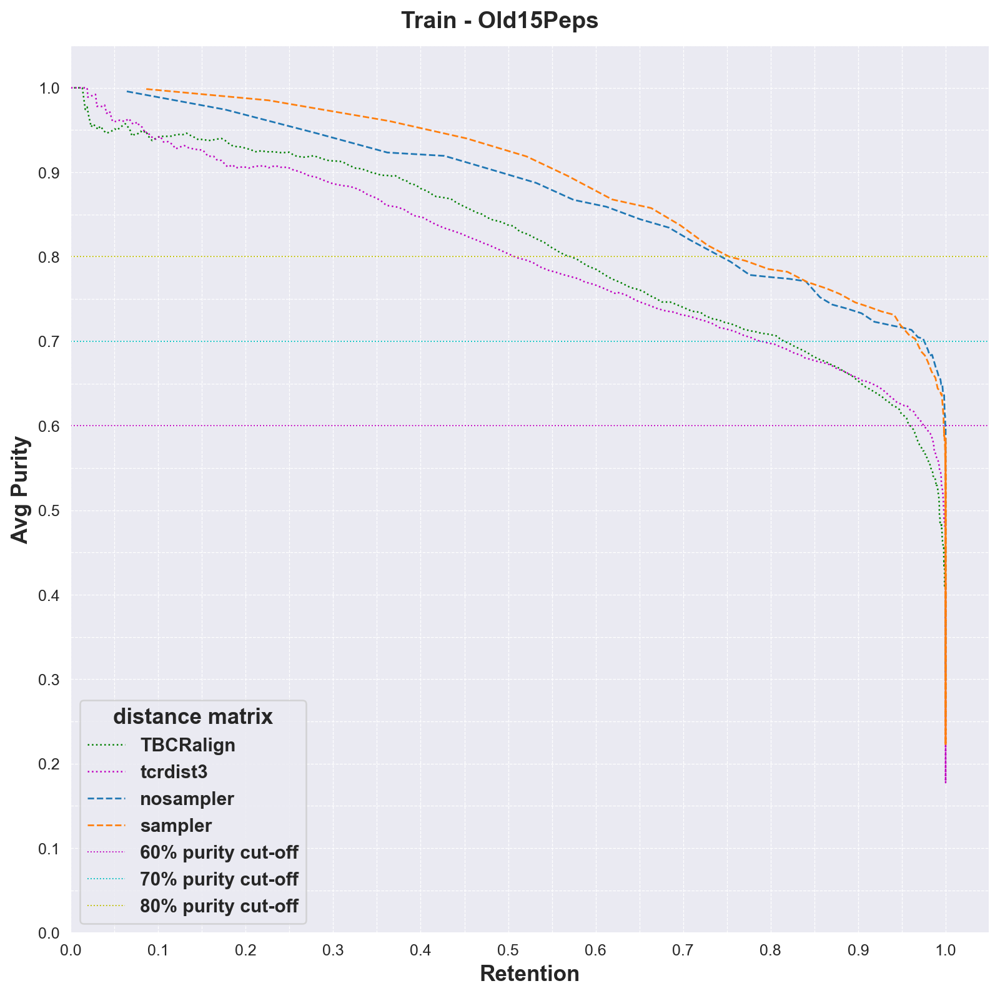

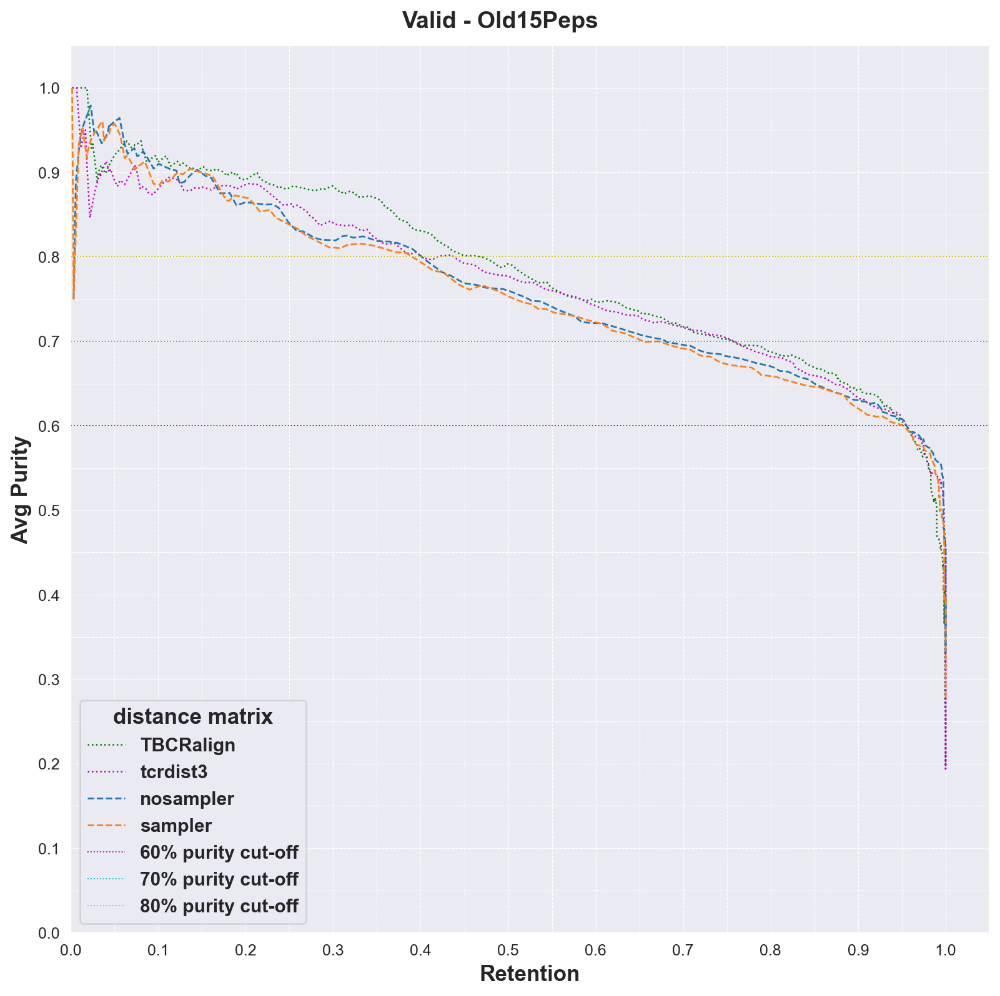

In [153]:
for x in glob.glob('../output/240516_TripletTweaks_IntervalClustering/*/'):
    if 'fig' in x:continue
    sampler_train_valid_comparison(x)

In [124]:
train_baseline = pd.read_csv('../output/240516_TripletTweaks_IntervalClustering/Exp78Peps/CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None/Exp78Peps_TripletTweak_Expanded_CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None_train_results.csv').query('input_type=="TBCRalign" or input_type=="tcrdist3"')
valid_baseline = pd.read_csv('../output/240516_TripletTweaks_IntervalClustering/Exp78Peps/CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None/Exp78Peps_TripletTweak_Expanded_CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None_valid_results.csv').query('input_type=="TBCRalign" or input_type=="tcrdist3"')
train_sampler = find_best_not_agg(pd.read_csv('../output/240516_TripletTweaks_IntervalClustering/Exp78Peps/CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None/Exp78Peps_TripletTweak_Expanded_CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None_train_results.csv')).assign(input_type='sampler')
valid_sampler = find_best_not_agg(pd.read_csv('../output/240516_TripletTweaks_IntervalClustering/Exp78Peps/CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None/Exp78Peps_TripletTweak_Expanded_CDFalse_WUFalse_SamplerTrue_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None_valid_results.csv')).assign(input_type='sampler')

train_nosampler = find_best_not_agg(pd.read_csv('../output/240516_TripletTweaks_IntervalClustering/Exp78Peps/CDFalse_WUFalse_SamplerFalse_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None/Exp78Peps_TripletTweak_Expanded_CDFalse_WUFalse_SamplerFalse_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None_train_results.csv')).assign(input_type='nosampler')
valid_nosampler = find_best_not_agg(pd.read_csv('../output/240516_TripletTweaks_IntervalClustering/Exp78Peps/CDFalse_WUFalse_SamplerFalse_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None/Exp78Peps_TripletTweak_Expanded_CDFalse_WUFalse_SamplerFalse_P1N1_240507_nettcr_exp_pruned_noswap_78peps_240516_1334_None_valid_results.csv')).assign(input_type='nosampler')

savedir = f'../output/240516_TripletTweaks_IntervalClustering/figs/'
mkdirs(savedir)
train = pd.concat([train_baseline, train_sampler, train_nosampler])
valid = pd.concat([valid_baseline, valid_sampler, valid_nosampler])

plot_pipeline_all(train, f'Train - Exp78Peps', f'{savedir}bestmodel_samplerComparisonTrain', 'tab10')
plot_pipeline_all(valid, f'Valid - Exp78Peps', f'{savedir}bestmodel_samplerComparisonValid', 'tab10')                                 

In [196]:
xd = get_best_given_dir_tt('../output/240516_TripletTweaks_IntervalClustering/Exp17Peps/', 'valid', 'Exp17').query(query)

['TBCRalign' 'tcrdist3' 'CNNVAE_78peps_LARGERepoch_20000'
 'CDTrue_WUTrue_SamplerTrue_P0N1epoch_20000'
 'CDFalse_WUFalse_SamplerFalse_P0N1epoch_22500'
 'CDTrue_WUFalse_SamplerTrue_P0N1epoch_17500'
 'CDTrue_WUTrue_SamplerFalse_P1N0epoch_22500'
 'CDFalse_WUTrue_SamplerFalse_P1N1epoch_22500'
 'CDFalse_WUFalse_SamplerFalse_P1N1epoch_10000'
 'CDFalse_WUTrue_SamplerFalse_P0N1epoch_12500'
 'CDTrue_WUFalse_SamplerTrue_P1N1epoch_12500'
 'CDTrue_WUFalse_SamplerFalse_P1N0epoch_22500'
 'CDTrue_WUTrue_SamplerTrue_P1N1epoch_7500'
 'CDFalse_WUFalse_SamplerTrue_P1N0epoch_2500'
 'CDFalse_WUTrue_SamplerTrue_P1N0epoch_25000'
 'CDFalse_WUTrue_SamplerTrue_P0N1epoch_25000'
 'CDFalse_WUFalse_SamplerTrue_P0N1epoch_20000'
 'CNNVAE_78peps_Smallerepoch_7500'
 'CDFalse_WUTrue_SamplerFalse_P1N0epoch_25000'
 'CDTrue_WUFalse_SamplerFalse_P0N1epoch_22500'
 'CDTrue_WUTrue_SamplerFalse_P1N1epoch_12500'
 'CNNVAE_ExpAll_Smallerepoch_2500'
 'CDTrue_WUFalse_SamplerTrue_P1N0epoch_17500'
 'CDFalse_WUFalse_SamplerFalse_P1N0ep

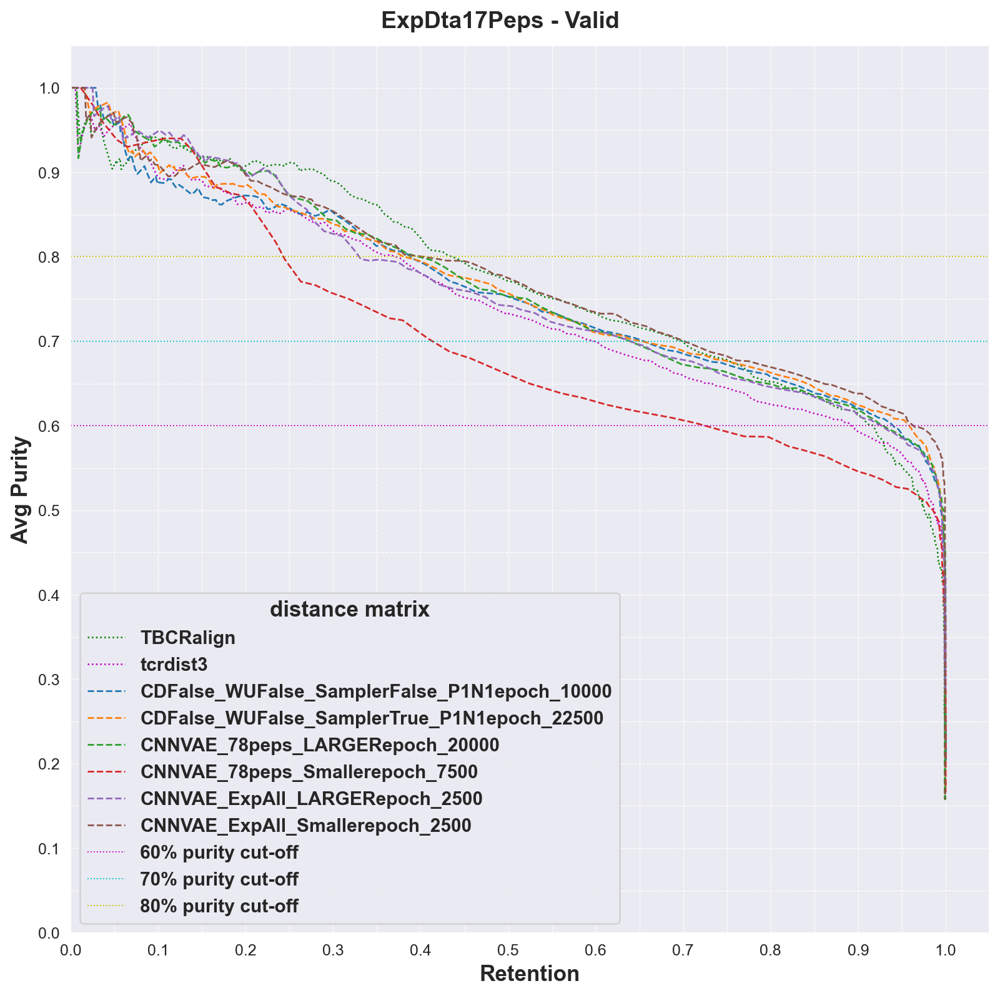

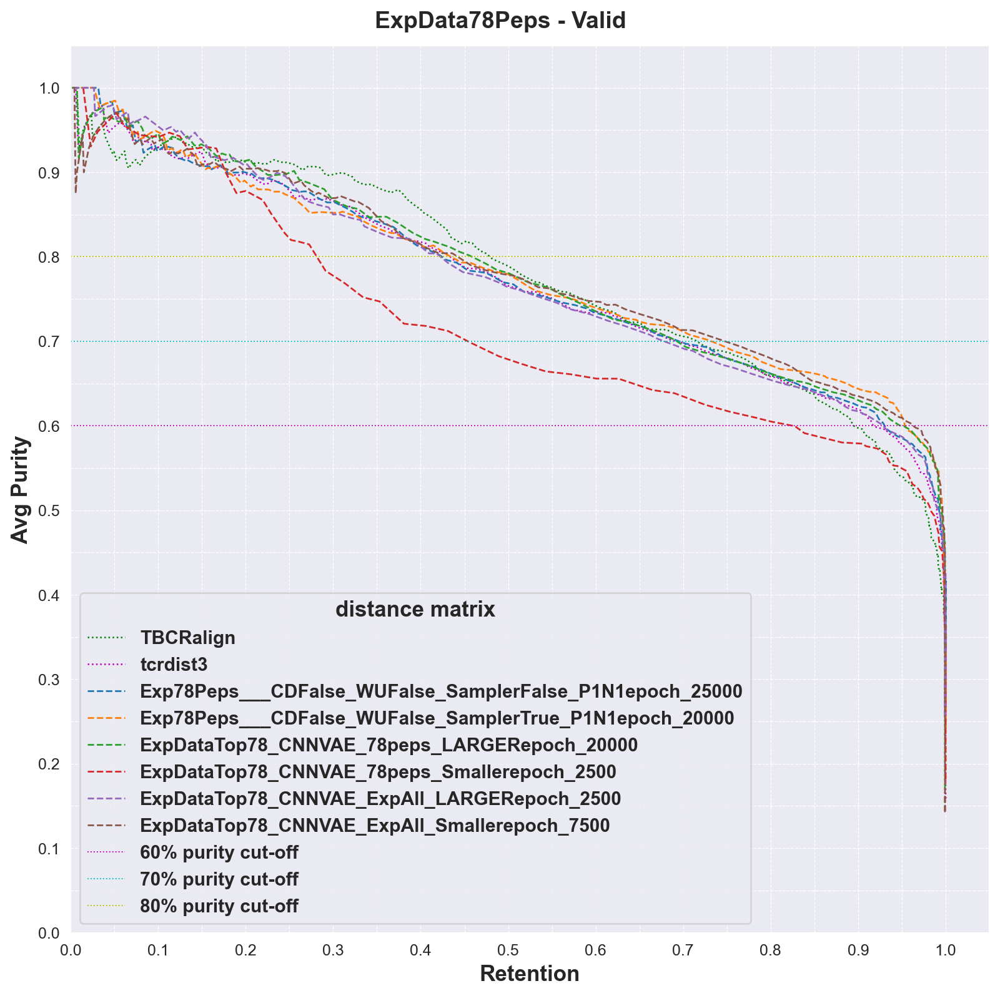

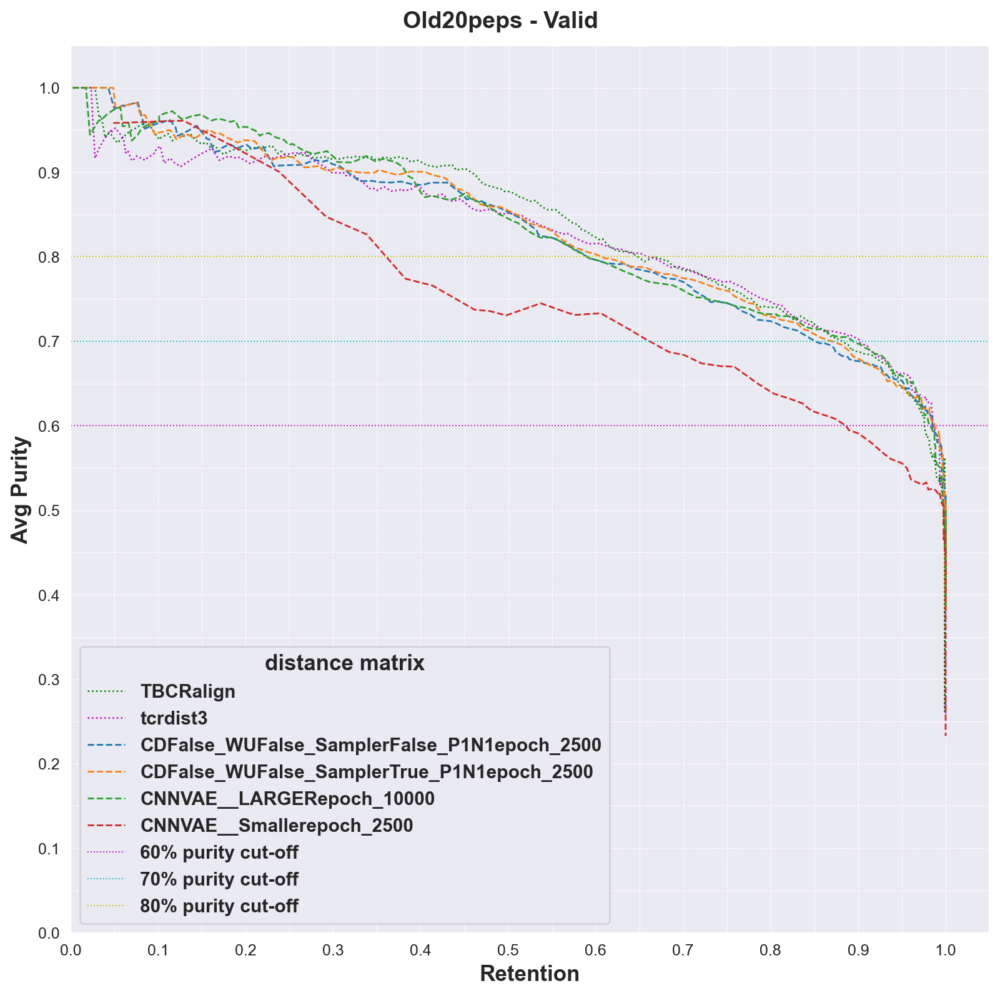

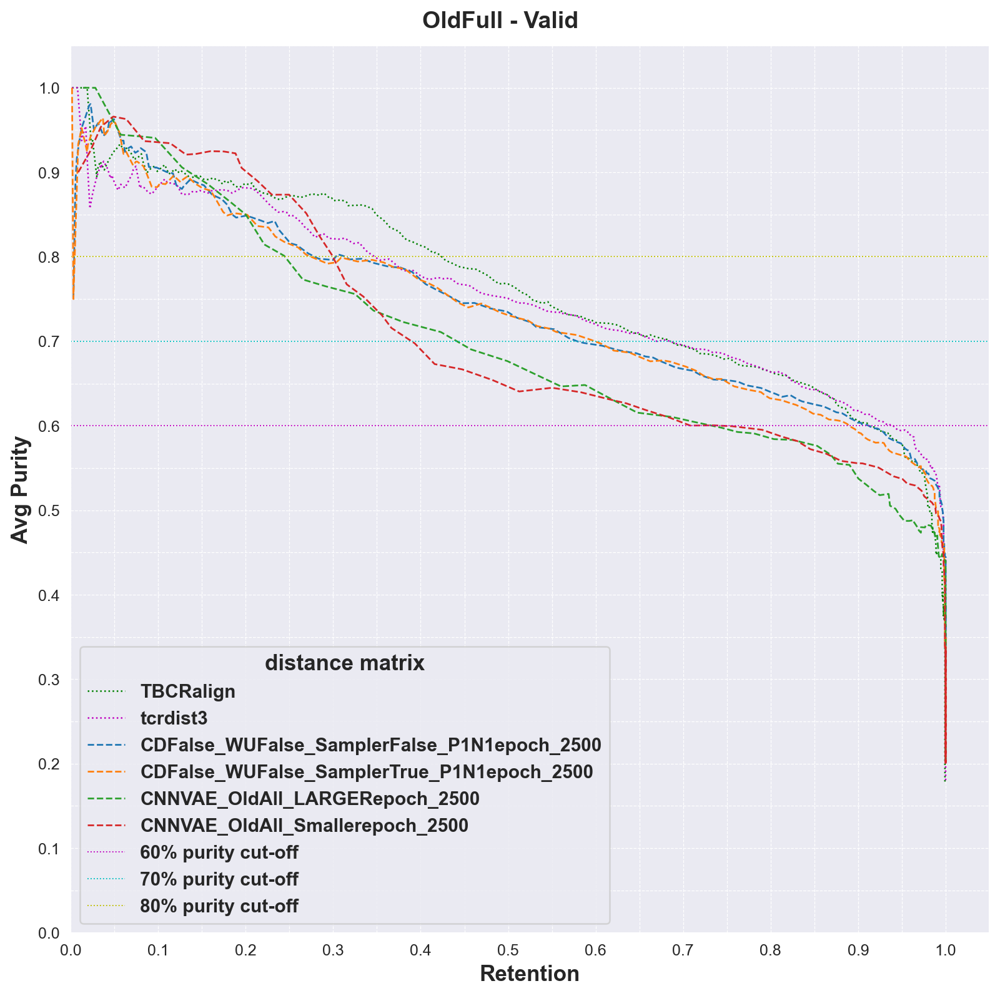

In [434]:
query = 'not name.str.contains("WUTrue") and not name.str.contains("P0") and not name.str.contains("N0") and not name.str.contains("CDTrue")'
plot_pipeline_all(get_best_given_dir_tt('../output/240516_TripletTweaks_IntervalClustering/Exp17Peps/', 'valid', 'Exp17').query(query), 'ExpDta17Peps - Valid', '../output/240516_TripletTweaks_IntervalClustering/figs/TTComparison_best_Exp17peps', 'tab10')
plot_pipeline_all(get_best_given_dir_tt('../output/240516_TripletTweaks_IntervalClustering/Exp78Peps/', 'valid', 'Exp78').query(query), 'ExpData78Peps - Valid', '../output/240516_TripletTweaks_IntervalClustering/figs/TTComparison_best_Exp78peps', 'tab10')
plot_pipeline_all(get_best_given_dir_tt('../output/240516_TripletTweaks_IntervalClustering/Old20peps/', 'valid', 'Old20peps').query(query), 'Old20peps - Valid', '../output/240516_TripletTweaks_IntervalClustering/figs/TTComparison_best_Old20peps', 'tab10')
plot_pipeline_all(get_best_given_dir_tt('../output/240516_TripletTweaks_IntervalClustering/OldFull/', 'valid', 'OldFull').query(query), 'OldFull - Valid', '../output/240516_TripletTweaks_IntervalClustering/figs/TTComparison_best_OldFull', 'tab10')

['TBCRalign' 'tcrdist3' 'CNNVAE_78peps_LARGERagg'
 'CDFalse_WUFalse_SamplerFalse_P1N1agg' 'CNNVAE_78peps_Smalleragg'
 'CNNVAE_ExpAll_Smalleragg' 'CDFalse_WUFalse_SamplerTrue_P1N1agg'
 'CNNVAE_ExpAll_LARGERagg']
['TBCRalign' 'tcrdist3' 'ExpDataTop78_CNNVAE_ExpAll_Smalleragg'
 'ExpDataTop78_CNNVAE_ExpAll_LARGERagg'
 'Exp78Peps___CDFalse_WUFalse_SamplerFalse_P1N1agg'
 'ExpDataTop78_CNNVAE_78peps_Smalleragg'
 'ExpDataTop78_CNNVAE_78peps_LARGERagg'
 'Exp78Peps___CDFalse_WUFalse_SamplerTrue_P1N1agg']
['TBCRalign' 'tcrdist3' 'CDFalse_WUFalse_SamplerTrue_P1N1agg'
 'CNNVAE__Smalleragg' 'CNNVAE__LARGERagg'
 'CDFalse_WUFalse_SamplerFalse_P1N1agg']
['TBCRalign' 'tcrdist3' 'CNNVAE_OldAll_Smalleragg'
 'CDFalse_WUFalse_SamplerFalse_P1N1agg'
 'CDFalse_WUFalse_SamplerTrue_P1N1agg' 'CNNVAE_OldAll_LARGERagg']


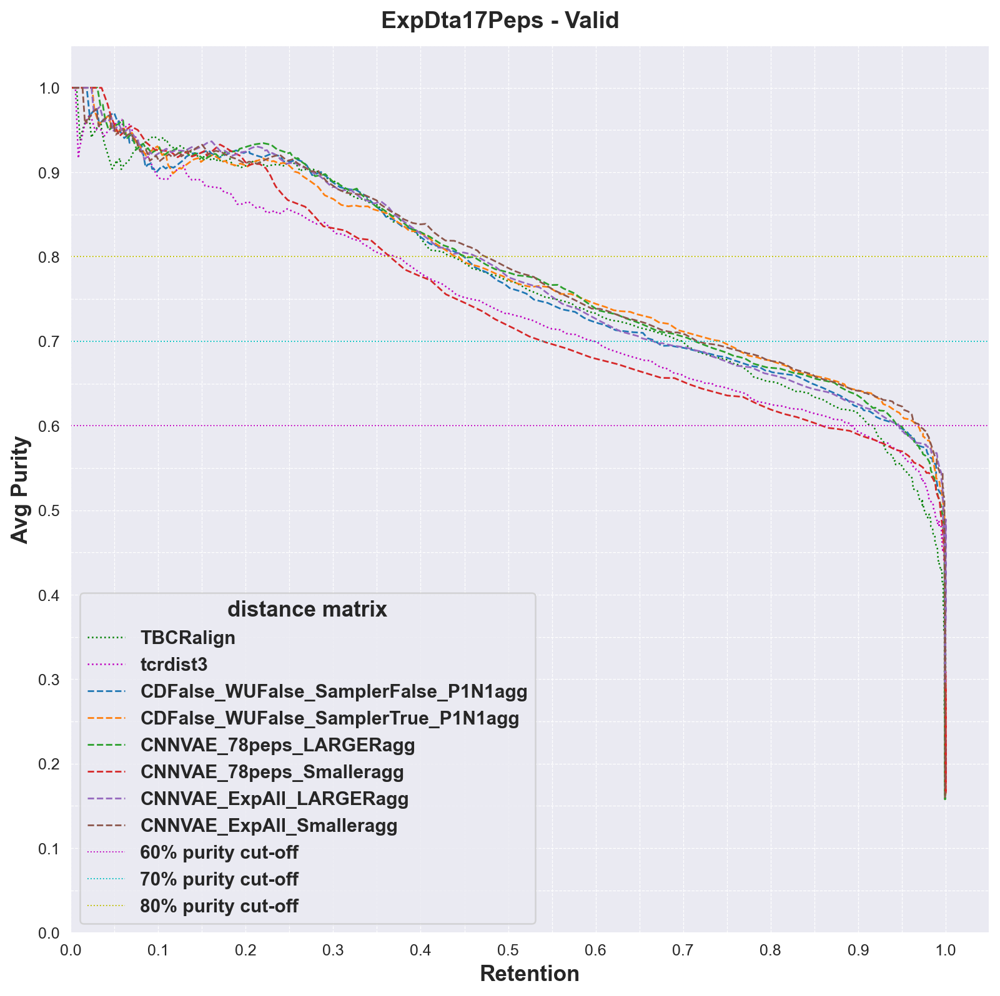

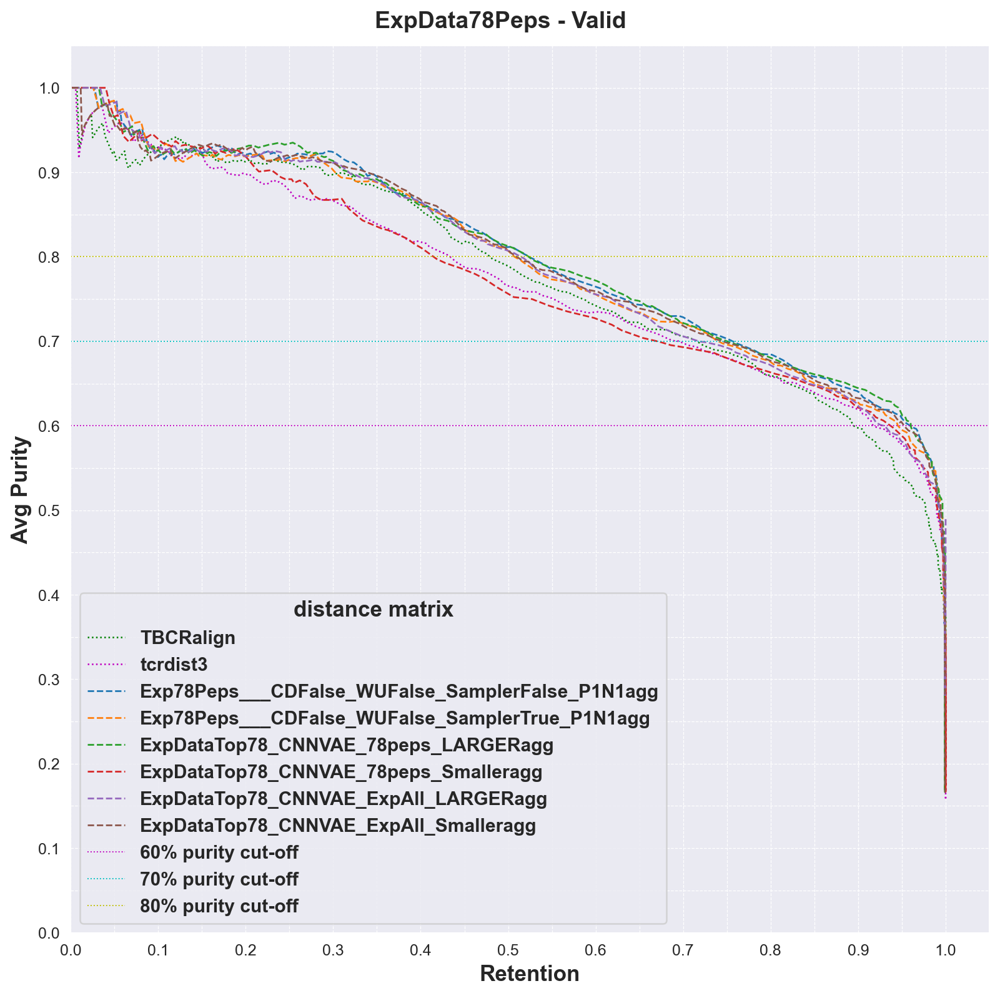

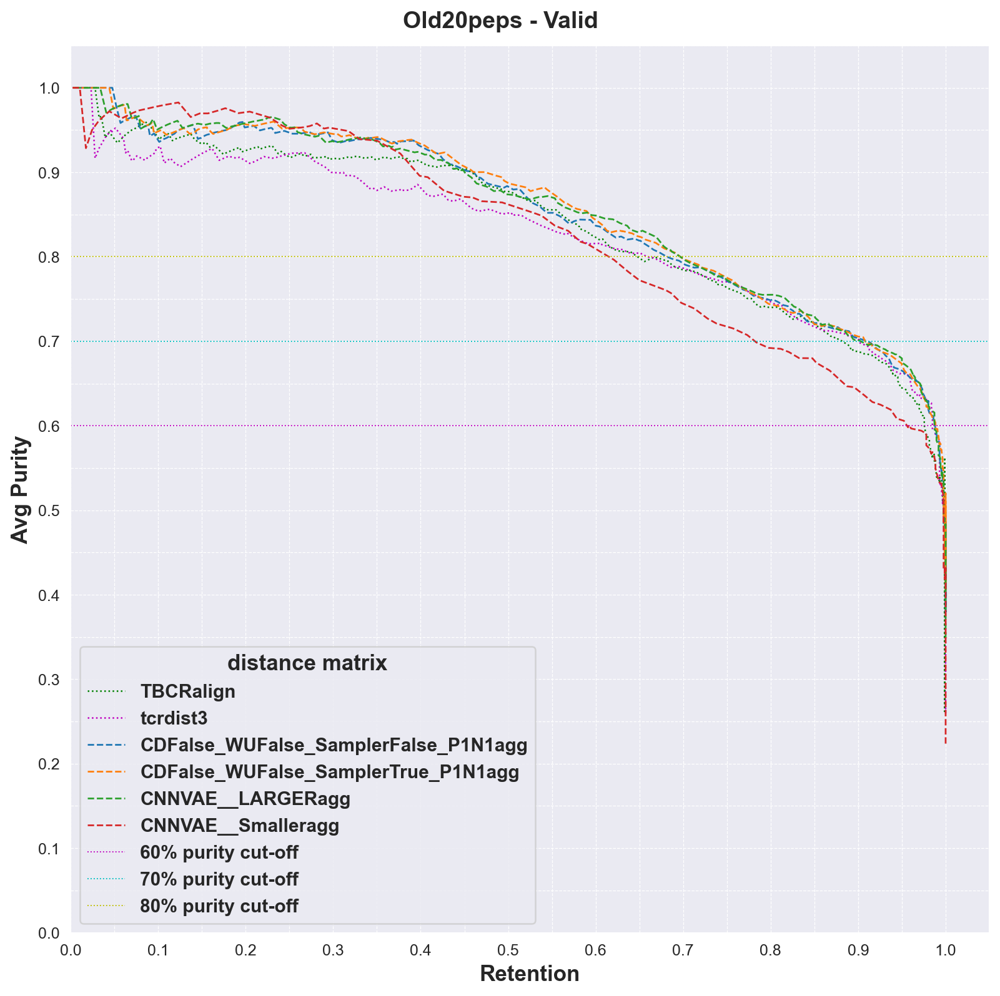

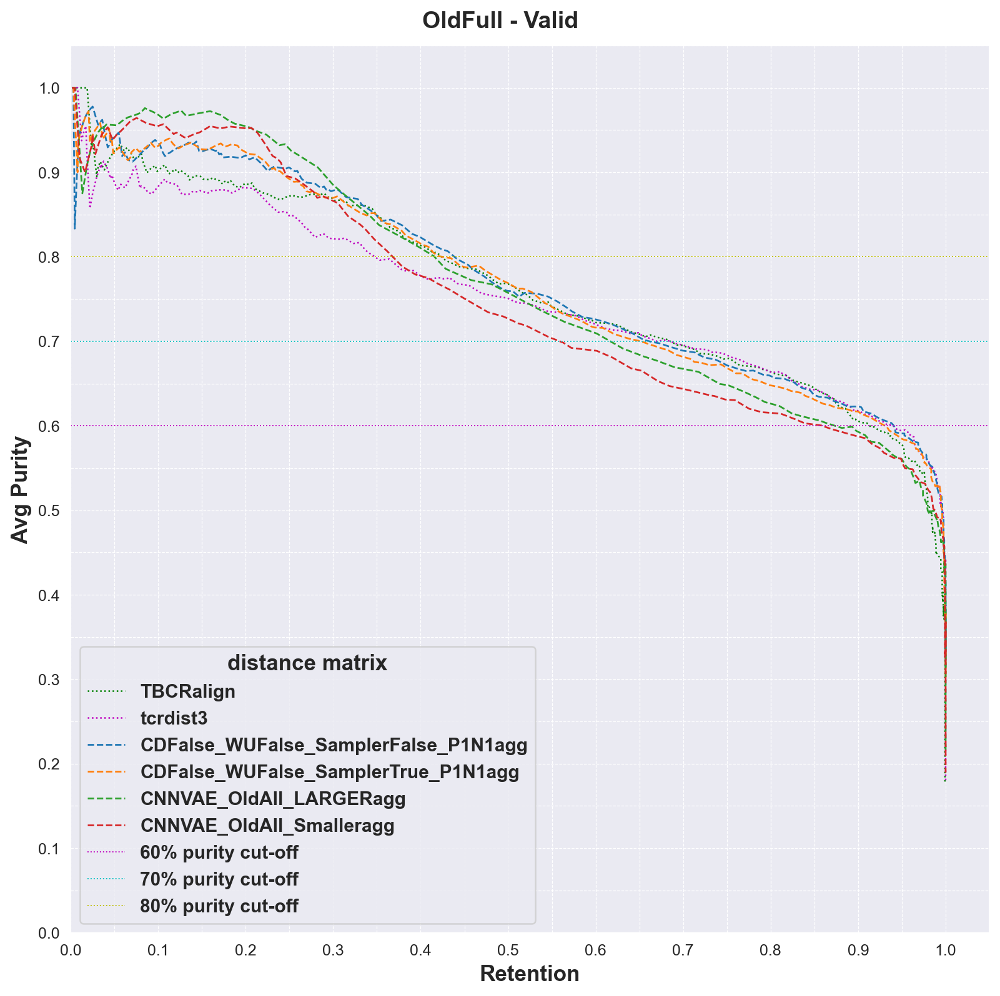

In [438]:
query = 'not name.str.contains("WUTrue") and not name.str.contains("P0") and not name.str.contains("N0") and not name.str.contains("CDTrue")'
a = get_agg_given_dir_tt('../output/240516_TripletTweaks_IntervalClustering/Exp17Peps/', 'valid', 'Exp17').query(query)
print(a.input_type.unique())
plot_pipeline_all(a, 'ExpDta17Peps - Valid', '../output/240516_TripletTweaks_IntervalClustering/figs/TTComparison_agg_Exp17peps', 'tab10')
b = get_agg_given_dir_tt('../output/240516_TripletTweaks_IntervalClustering/Exp78Peps/', 'valid', 'Exp78').query(query)
print(b.input_type.unique())
plot_pipeline_all(b, 'ExpData78Peps - Valid', '../output/240516_TripletTweaks_IntervalClustering/figs/TTComparison_agg_Exp78peps', 'tab10')
c = get_agg_given_dir_tt('../output/240516_TripletTweaks_IntervalClustering/Old20peps/', 'valid', 'Old20peps').query(query)
print(c.input_type.unique())
plot_pipeline_all(c, 'Old20peps - Valid', '../output/240516_TripletTweaks_IntervalClustering/figs/TTComparison_agg_Old20peps', 'tab10')
d = get_agg_given_dir_tt('../output/240516_TripletTweaks_IntervalClustering/OldFull/', 'valid', 'OldFull').query(query)
print(d.input_type.unique())
plot_pipeline_all(d, 'OldFull - Valid', '../output/240516_TripletTweaks_IntervalClustering/figs/TTComparison_agg_OldFull', 'tab10')

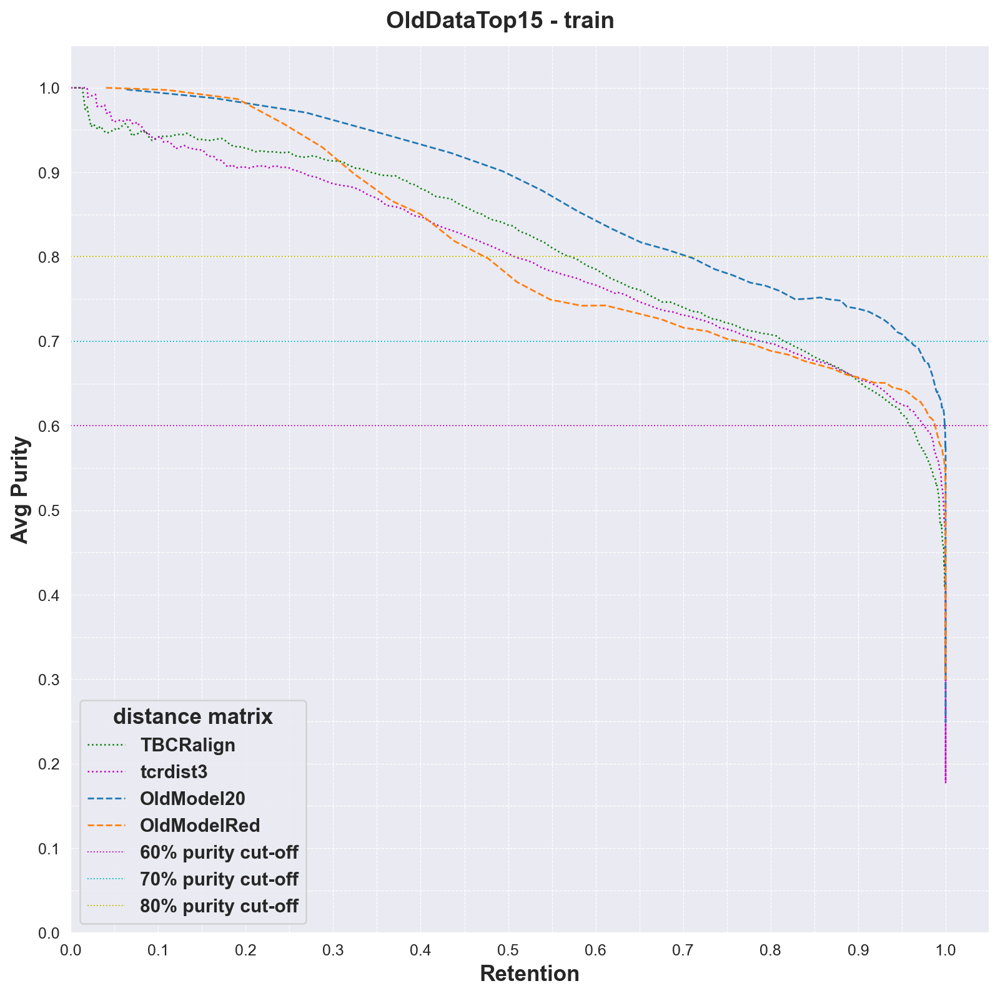

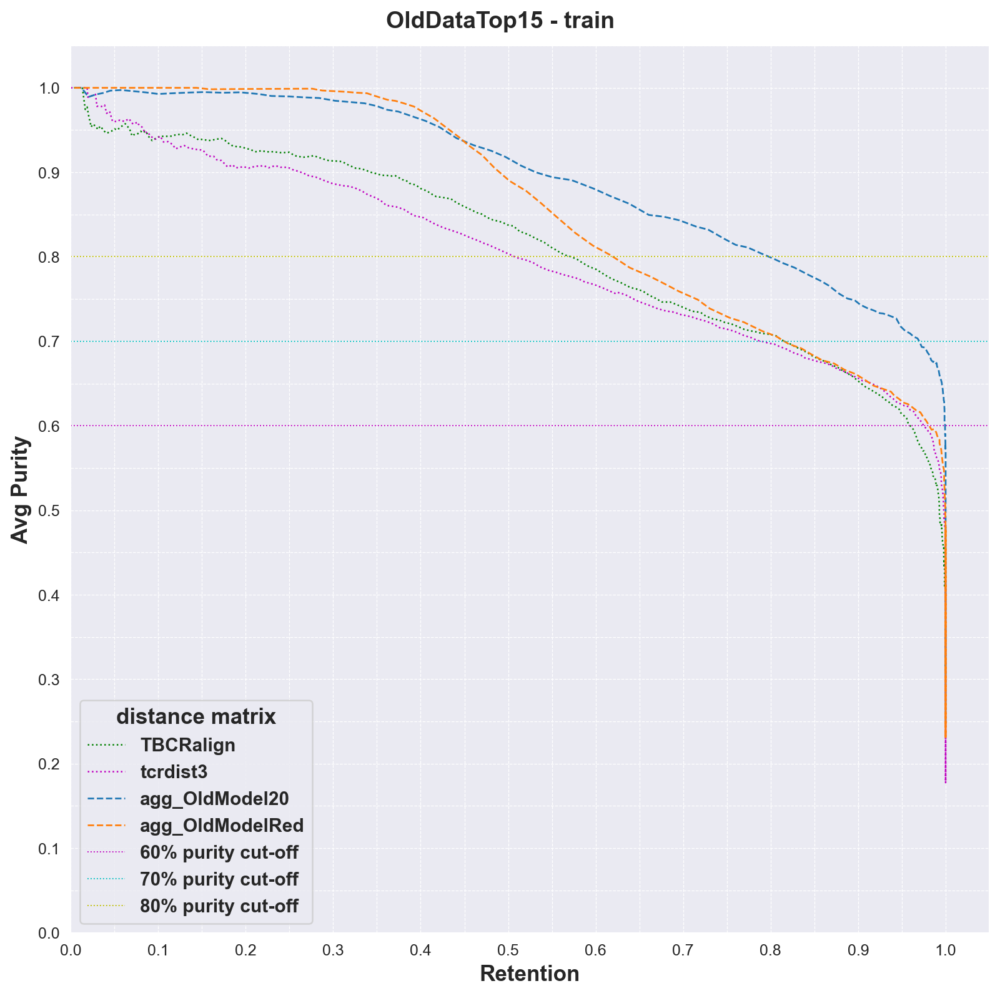

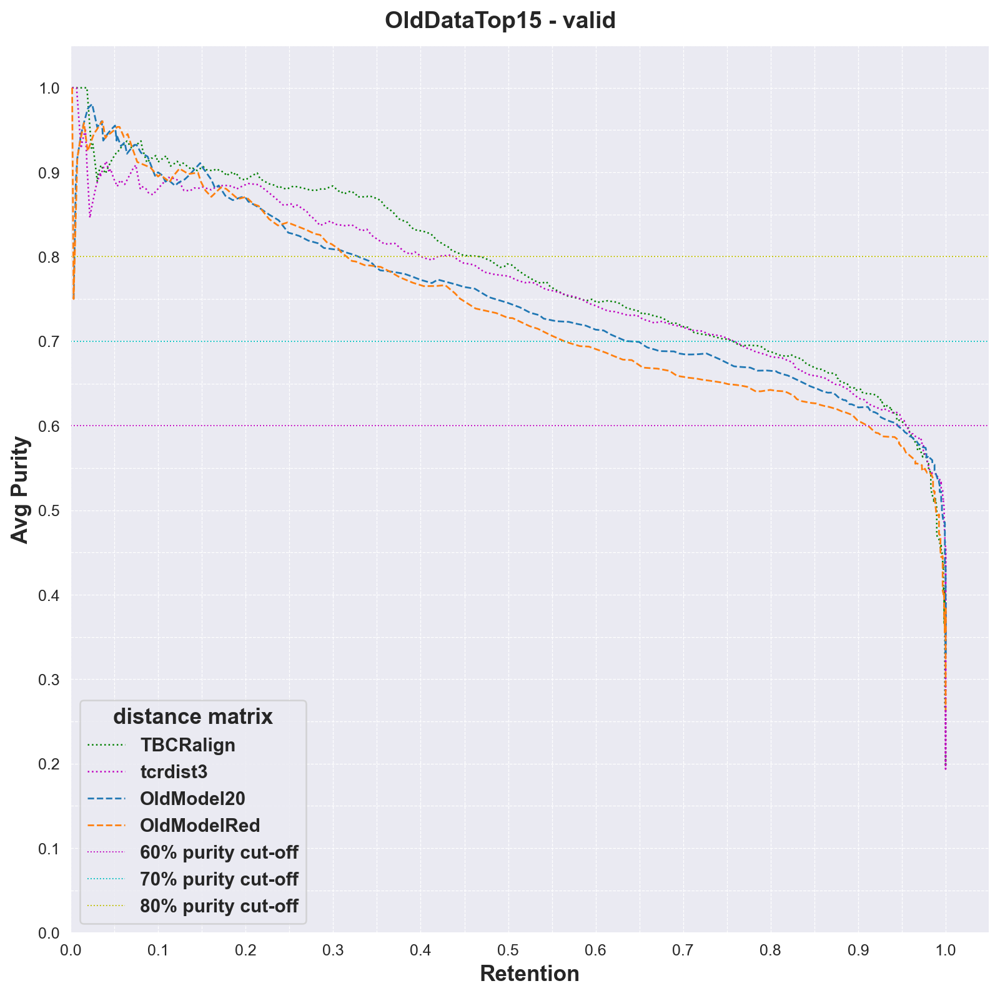

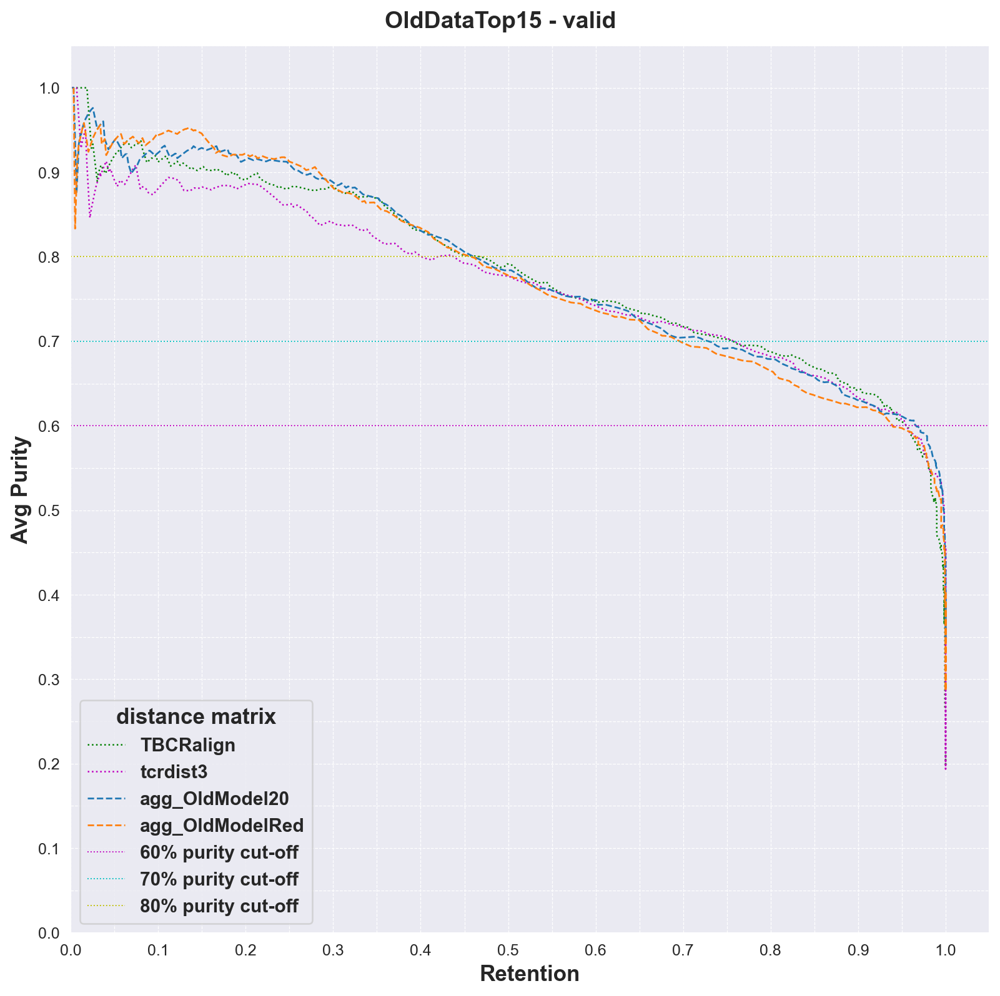

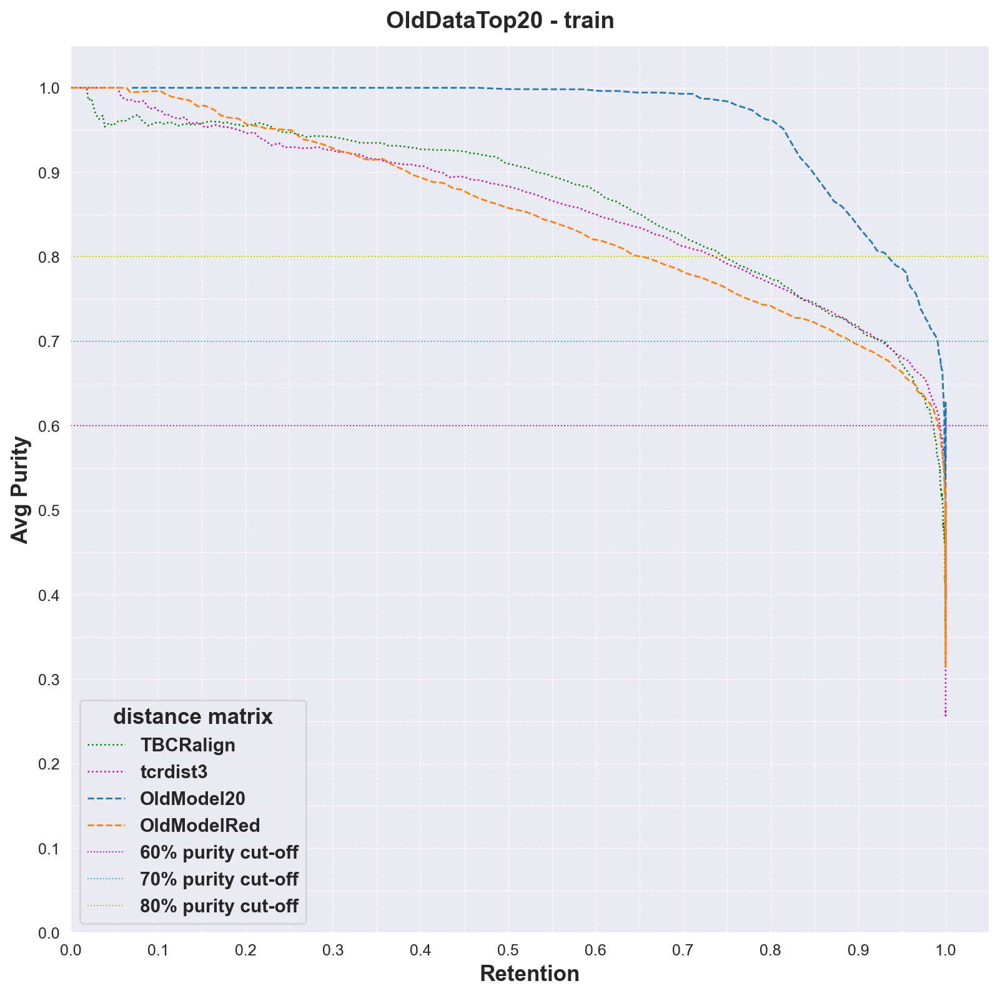

...

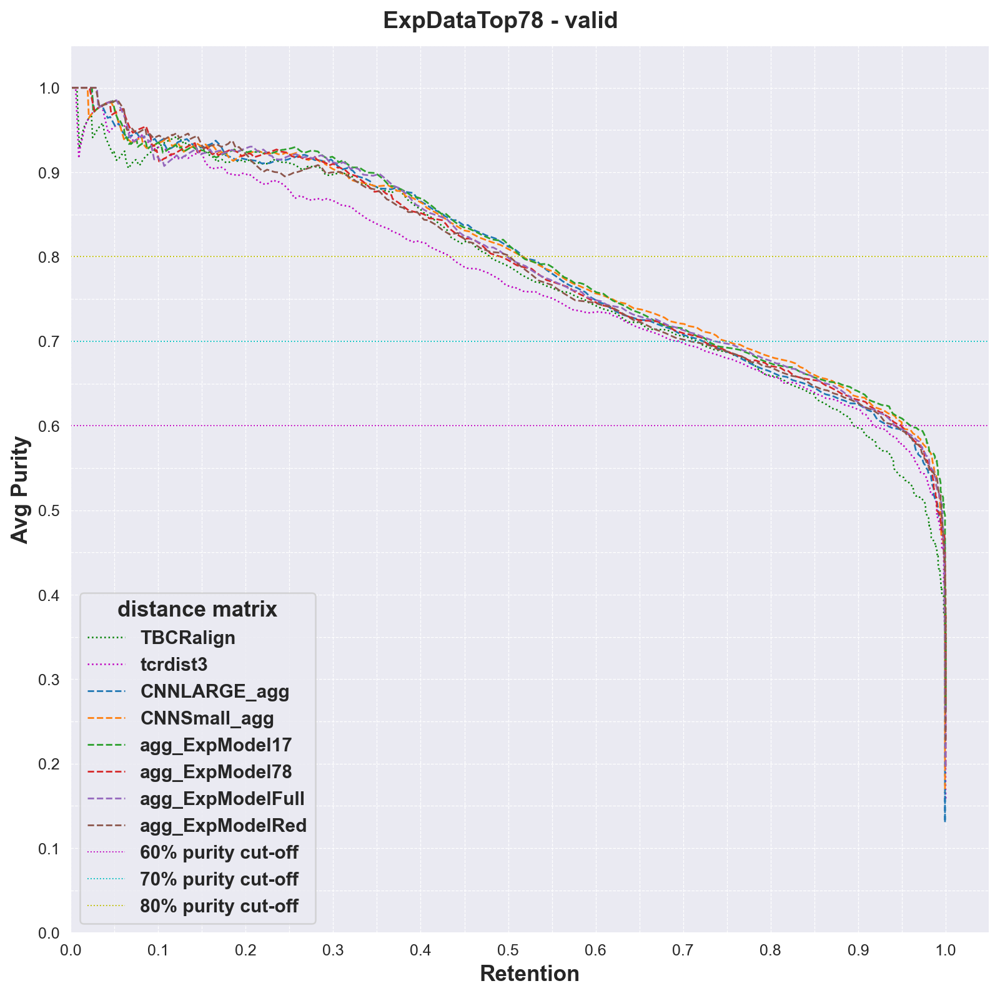

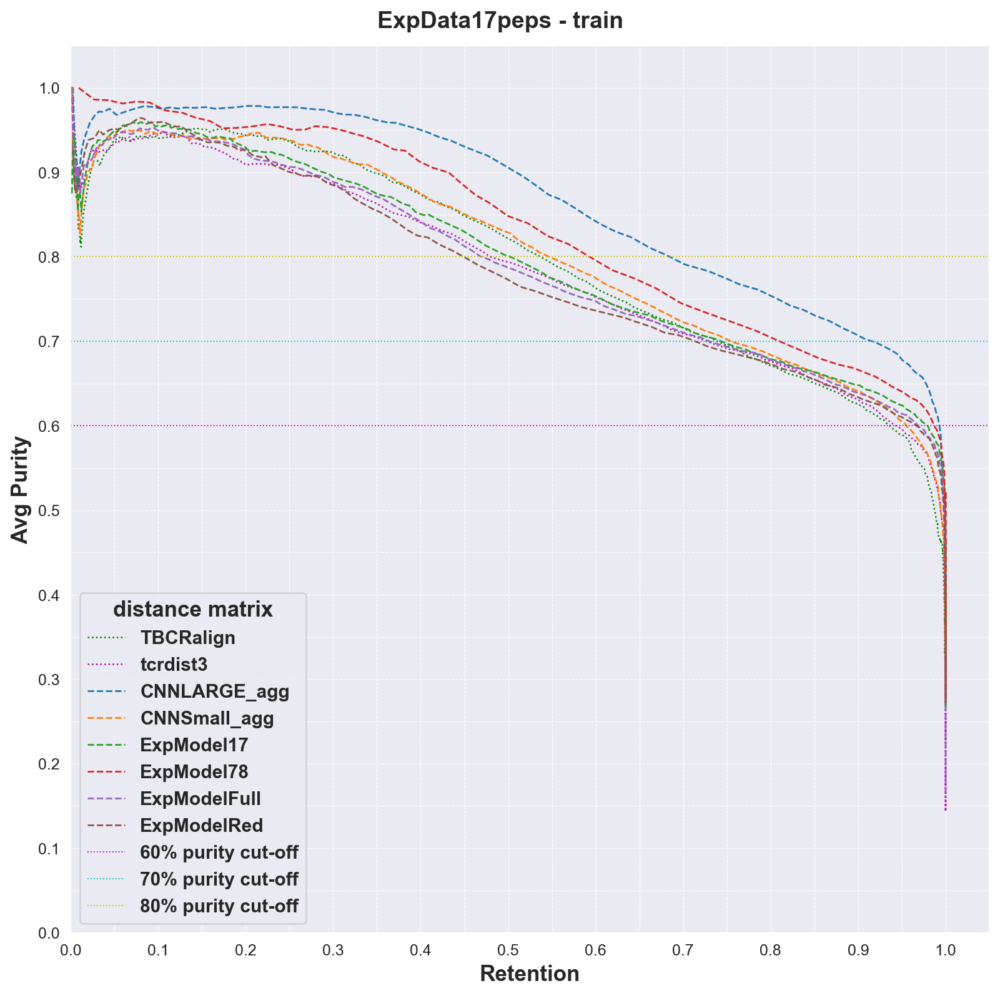

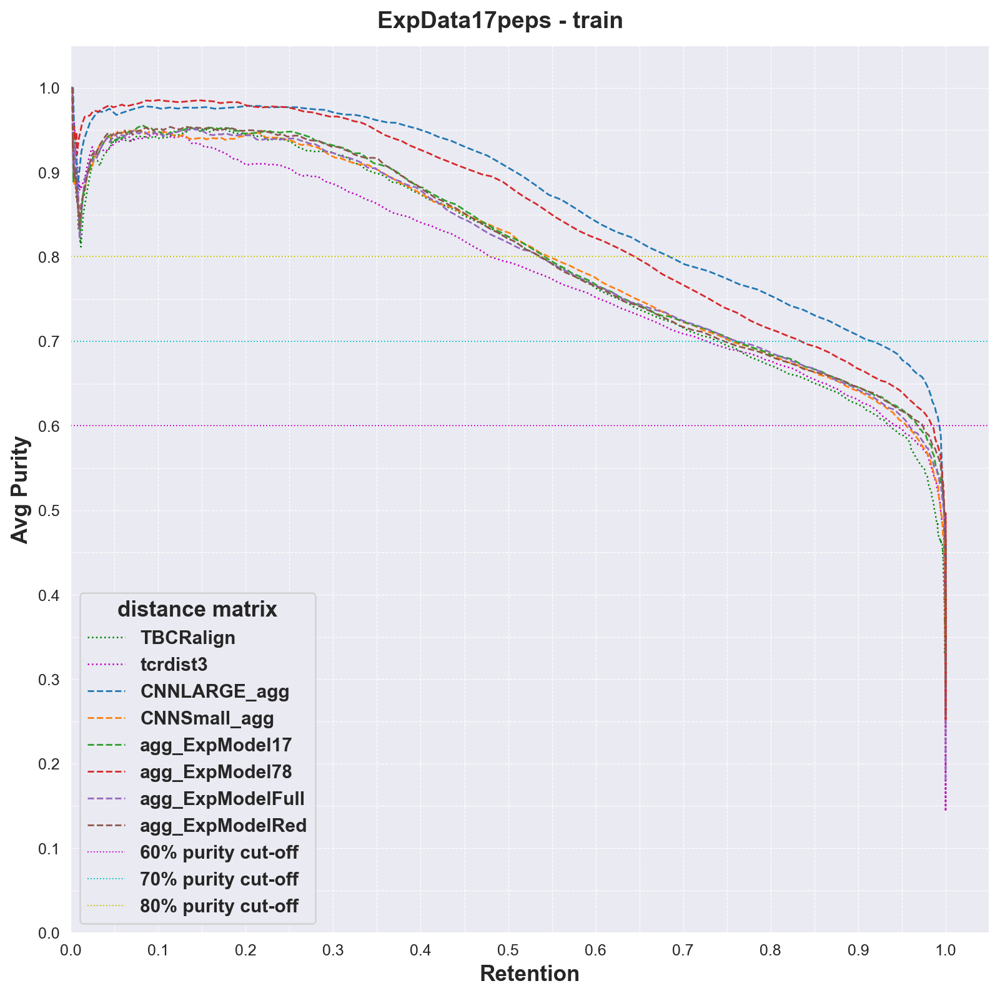

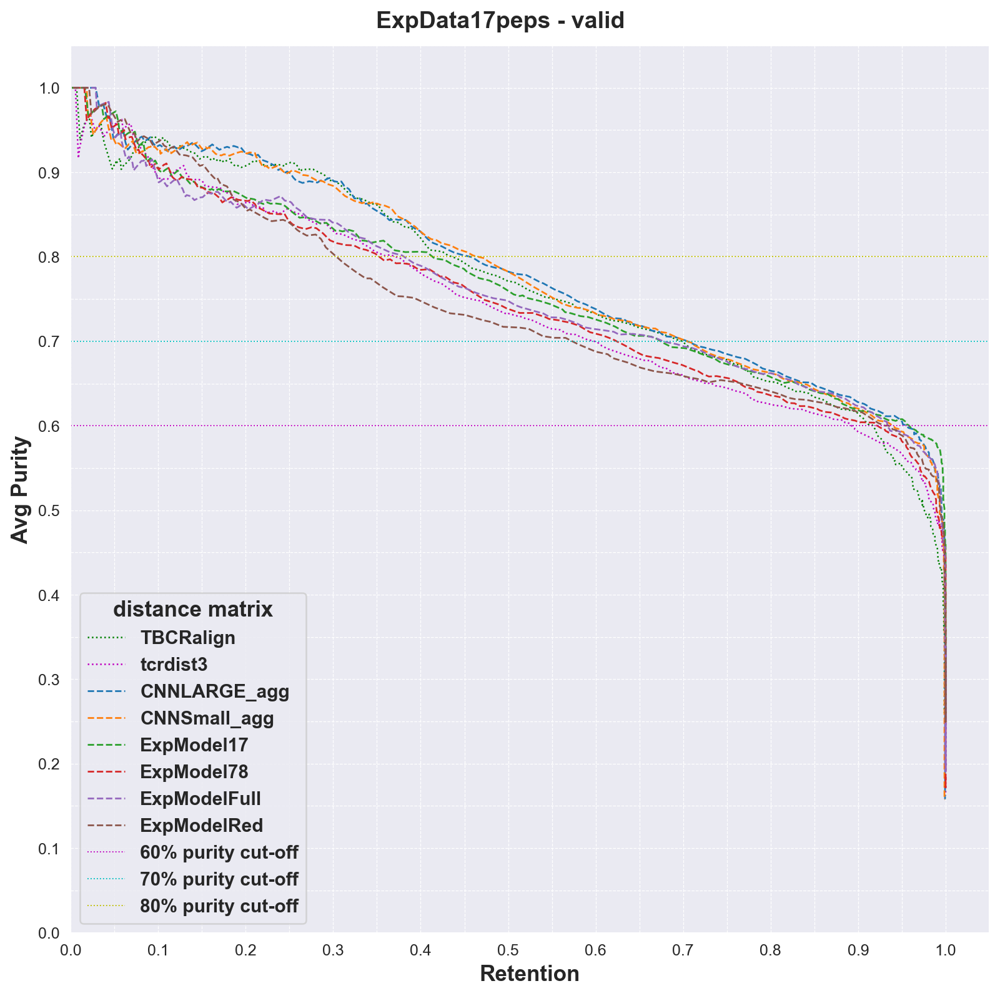

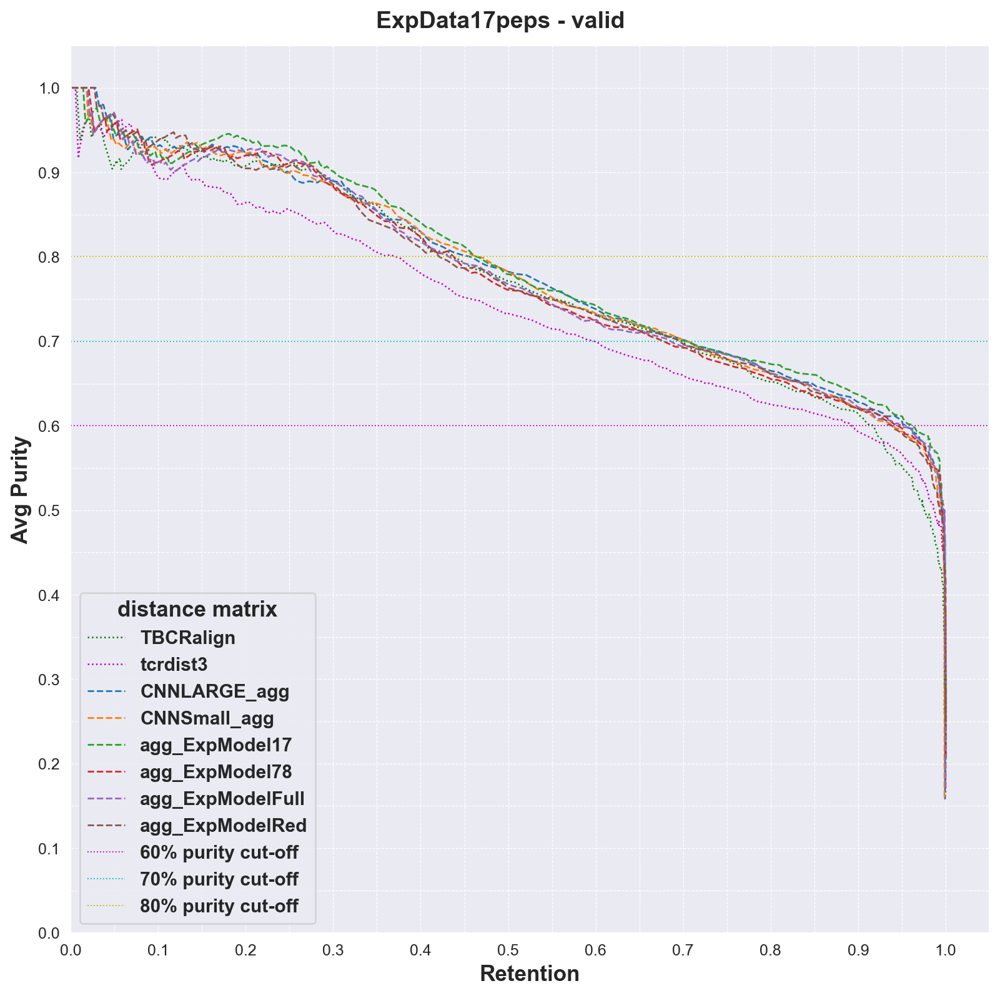

In [432]:
tt_results = {}
tt_agg_results = {}
savedir = f'../output/240516_TripletTweaks_IntervalClustering/figs/'
mkdirs(savedir)
for k in ['OldDataTop15', 'OldDataTop20' ,'OldDataNoPrune', 'ExpDataTop78', 'ExpData17peps']:
    tt_agg_results[k] = {}
    tt_results[k] = {}
    for set in ['train', 'valid']:
        tt_results[k][set] = get_best_given_dir(f'../output/240515_IntervalClustering/{k}/', set, k).query('not input_type.str.startswith("_OLD")')
        tt_results[k][set].input_type = tt_results[k][set].input_type.apply(lambda x: x.split('_'+k)[0])
        plot_pipeline_all(tt_results[k][set], f'{k} - {set}', f'{savedir}{k}_{set}', 'tab10')

        tt_agg_results[k][set] = get_agg_given_dir(f'../output/240515_IntervalClustering/{k}/', set, k).query('not input_type.str.startswith("_OLD")')
        tt_agg_results[k][set].input_type = tt_agg_results[k][set].input_type.apply(lambda x: x.split('_'+k)[0])
        plot_pipeline_all(tt_agg_results[k][set], f'{k} - {set}', f'{savedir}AggModels_{k}_{set}', 'tab10')


## Old Data

# Diagnostic Round 2 results

In [14]:
from src.cluster_utils import get_all_rpauc, plot_pipeline_all

def get_best_given_dir_diag2(maindir, set, idf='', filters=None):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}_results*.csv') if '_OLD_' not in x]
    files = {x.split('/')[-1].split('_24')[0]\
             .replace('RedoHP_','').replace('_train_','').replace('CNNVAE','Conv')\
             .replace('OldPruned','').replace('ExpDataTop78','').replace('latent','ld').replace('kld','kl')\
             .replace('ExpData17peps','').replace('OldDataNoPrune','').replace('_KFold_0','')\
             .replace('ExpAll_','').replace('OldAll_','').replace('OldDataTop15','').replace('OldDataTop20','').lstrip('_').rstrip('_'): x for x in folders}
    if filters is not None:
        files = {key: value for key, value in files.items() if any(keyword in key for keyword in filters)}

    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    baselines['name'] = ''
    out = pd.concat([baselines] + [find_best_not_agg(pd.read_csv(path)).assign(name=name) for name, path in files.items()]).assign(identifier=idf)
    out['epoch'] = out['input_type']
    out['input_type'] = out.apply(lambda x: x['name']+'_'+x['input_type'] if x['name']!='' else x['input_type'], axis=1)#['name']+'_'+out['input_type']
    out['name'] = out.apply(lambda x: x['input_type'] if 'TBCR' in x['name'] or 'tcrdist' in x['name'] else x['name'], axis=1)
    return out[[x for x in out.columns if not 'Unnamed' in x]]
    
def get_agg_given_dir_diag2(maindir, set, idf='', filters=None):
    folders = [x for x in glob.glob(f'{maindir}/*/*{set}_results*.csv') if '_OLD_' not in x]
    files = {x.split('/')[-1].split('_24')[0]\
             .replace('RedoHP_','').replace('_train_','').replace('CNNVAE','Conv')\
             .replace('OldPruned','').replace('ExpDataTop78','').replace('latent','ld').replace('kld','kl')\
             .replace('ExpData17peps','').replace('OldDataNoPrune','').replace('_KFold_0','')\
             .replace('ExpAll_','').replace('OldAll_','').replace('OldDataTop15','').replace('OldDataTop20','').lstrip('_').rstrip('_'): x for x in folders}
    if filters is not None:
        files = {key: value for key, value in files.items() if any(keyword in key for keyword in filters)}

    baselines = pd.read_csv(folders[0]).query('input_type.str.contains("TBCR") or input_type.str.contains("tcrdist")')
    baselines['name'] = ''
    out = pd.concat([baselines] + [find_agg(path).assign(name=name) for name, path in files.items()]).assign(identifier=idf)
    out['input_type'] = out.apply(lambda x: x['name']+'_'+x['input_type'] if x['name']!='' else x['input_type'], axis=1)#['name']+'_'+out['input_type']
    out['name'] = out.apply(lambda x: x['input_type'] if 'TBCR' in x['name'] or 'tcrdist' in x['name'] else x['name'], axis=1)
    
    return out[[x for x in out.columns if not 'Unnamed' in x]]

def get_rpcurve_stats(maindir, set, which, idf='', filters=None):
    res = get_agg_given_dir_diag2(maindir, set, idf, None) if which=='agg' else get_best_given_dir_diag2(maindir, set, idf, None)
    # stupid for loop
    out = []
    for k in res.input_type.unique():
        tmp = res.query('input_type==@k')
        out.append(get_all_rpauc(tmp['retention'].values[1:-1], tmp['mean_purity'].values[1:-1], tmp['input_type'].unique()[0], tmp['name'].unique()[0]))
    return pd.DataFrame(out).sort_values('p70_r35_auc',ascending=False)

In [10]:
for dm in glob.glob('../output/240527_DiagnosticRound2/clustering/*/'):
    if 'fig' in dm: continue
    print(dm)
    display(get_rpcurve_stats(dm, 'valid', 'best').head(5))

../output/240527_DiagnosticRound2/clustering/OldDataTop15/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
2,Conv_ld_100_kl_1e-1_epoch_12000,Conv_ld_100_kl_1e-1,0.786656,0.662782,0.782167,0.418534,0.349873,0.221543
10,Conv_ld_100_kl_1e-2_checkpoint_best,Conv_ld_100_kl_1e-2,0.786575,0.646305,0.773331,0.414636,0.331269,0.210602
7,Conv_ld_100_kl_1e-3_epoch_12000,Conv_ld_100_kl_1e-3,0.783952,0.637777,0.771675,0.412763,0.320226,0.199229
0,TBCRalign,,0.783009,0.623918,0.758619,0.399348,0.305377,0.182949
1,tcrdist3,,0.768810,0.613332,0.742675,0.395082,0.301310,0.188138


../output/240527_DiagnosticRound2/clustering/ExpDataTop78/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
13,Conv_ld_100_kl_1e-3_epoch_20000,Conv_ld_100_kl_1e-3,0.785278,0.625800,0.766044,0.400576,0.304470,0.169483
4,Conv_ld_256_kl_1e-2_epoch_6000,Conv_ld_256_kl_1e-2,0.799326,0.634313,0.780964,0.409319,0.300001,0.182333
8,Conv_ld_100_kl_1e-1_epoch_12000,Conv_ld_100_kl_1e-1,0.777707,0.609728,0.752341,0.395988,0.293242,0.167979
2,Conv_ld_100_kl_1e-2_epoch_20000,Conv_ld_100_kl_1e-2,0.776446,0.603857,0.750665,0.389297,0.287418,0.159765
0,TBCRalign,,0.779058,0.604448,0.721915,0.356108,0.282388,0.155421


../output/240527_DiagnosticRound2/clustering/OldDataTop20/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
10,Conv_ld_100_kl_1e-1_epoch_14000,Conv_ld_100_kl_1e-1,0.849648,0.815888,0.848405,0.469844,0.488482,0.350606
4,Conv_ld_100_kl_1e-2_epoch_20000,Conv_ld_100_kl_1e-2,0.846059,0.802499,0.842901,0.466339,0.473189,0.340032
11,Conv_ld_100_kl_1e-3_epoch_16000,Conv_ld_100_kl_1e-3,0.846439,0.799707,0.844061,0.468387,0.464833,0.334831
14,Conv_ld_256_kl_1e-2_epoch_1500,Conv_ld_256_kl_1e-2,0.853473,0.787909,0.850098,0.465438,0.453747,0.313147
5,Conv_ld_50_kl_1e-3_epoch_16000,Conv_ld_50_kl_1e-3,0.839799,0.783734,0.838432,0.461536,0.451280,0.320452


../output/240527_DiagnosticRound2/clustering/OldDataNoPrune/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
11,Conv_ld_100_kl_1e-1_epoch_12000,Conv_ld_100_kl_1e-1,0.770695,0.575283,0.760299,0.404505,0.263705,0.141310
13,Conv_ld_100_kl_1e-3_epoch_8000,Conv_ld_100_kl_1e-3,0.762826,0.571144,0.736368,0.388969,0.253970,0.140391
12,Conv_ld_100_kl_1e-2_epoch_6000,Conv_ld_100_kl_1e-2,0.762531,0.561034,0.737176,0.385503,0.250521,0.130602
0,TBCRalign,,0.764088,0.564179,0.715940,0.361881,0.248413,0.132167
1,tcrdist3,,0.753222,0.550815,0.718234,0.374837,0.245765,0.127085


../output/240527_DiagnosticRound2/clustering/ExpData17peps/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
0,TBCRalign,,0.771539,0.586093,0.726871,0.362365,0.265450,0.139934
2,Conv_ld_256_kl_1e-2_epoch_6000,Conv_ld_256_kl_1e-2,0.776897,0.562592,0.754702,0.387194,0.241828,0.116324
13,Conv_ld_100_kl_1e-1_epoch_20000,Conv_ld_100_kl_1e-1,0.764313,0.551407,0.733465,0.380596,0.236147,0.119985
4,Conv_ld_100_kl_1e-2_epoch_20000,Conv_ld_100_kl_1e-2,0.760982,0.550160,0.719474,0.366783,0.234699,0.120218
8,Conv_ld_100_kl_1e-3_epoch_18000,Conv_ld_100_kl_1e-3,0.761914,0.534100,0.734676,0.370054,0.222683,0.100749


In [11]:
for dm in glob.glob('../output/240527_DiagnosticRound2/clustering/*/'):
    if 'fig' in dm: continue
    print(dm)
    display(get_rpcurve_stats(dm, 'valid', 'agg').head(5))

../output/240527_DiagnosticRound2/clustering/OldDataTop15/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
7,Conv_ld_100_kl_1e-3_agg,Conv_ld_100_kl_1e-3,0.794143,0.658558,0.781766,0.419908,0.337825,0.212918
2,Conv_ld_100_kl_1e-1_agg,Conv_ld_100_kl_1e-1,0.793104,0.656863,0.782461,0.424046,0.336591,0.211780
10,Conv_ld_100_kl_1e-2_agg,Conv_ld_100_kl_1e-2,0.791085,0.633064,0.777640,0.416513,0.315690,0.183152
0,TBCRalign,,0.783009,0.623918,0.758619,0.399348,0.305377,0.182949
8,VAE_ld_50_kl_1e-1_agg,VAE_ld_50_kl_1e-1,0.790377,0.622226,0.773683,0.406484,0.303490,0.169476


../output/240527_DiagnosticRound2/clustering/ExpDataTop78/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
2,Conv_ld_100_kl_1e-2_agg,Conv_ld_100_kl_1e-2,0.799369,0.643388,0.770551,0.400505,0.317230,0.186146
13,Conv_ld_100_kl_1e-3_agg,Conv_ld_100_kl_1e-3,0.797548,0.637178,0.768830,0.401602,0.312050,0.181626
4,Conv_ld_256_kl_1e-2_agg_epoch_6000,Conv_ld_256_kl_1e-2,0.800985,0.633231,0.779783,0.404354,0.300962,0.178171
5,VAE_ld_100_kl_1e-2_agg,VAE_ld_100_kl_1e-2,0.795793,0.627745,0.768956,0.401544,0.300048,0.175297
10,VAE_ld_50_kl_1e-2_agg,VAE_ld_50_kl_1e-2,0.786289,0.615402,0.750331,0.377686,0.291039,0.167621


../output/240527_DiagnosticRound2/clustering/OldDataTop20/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
10,Conv_ld_100_kl_1e-1_agg,Conv_ld_100_kl_1e-1,0.853169,0.815511,0.848794,0.464904,0.481472,0.347629
5,Conv_ld_50_kl_1e-3_agg,Conv_ld_50_kl_1e-3,0.855103,0.806532,0.853285,0.469911,0.475726,0.338144
4,Conv_ld_100_kl_1e-2_agg,Conv_ld_100_kl_1e-2,0.856843,0.806025,0.855053,0.474522,0.474075,0.333064
2,VAE_ld_50_kl_1e-1_agg,VAE_ld_50_kl_1e-1,0.856290,0.801691,0.853830,0.477384,0.470302,0.331200
14,Conv_ld_256_kl_1e-2_agg_epoch_1500,Conv_ld_256_kl_1e-2,0.858127,0.803965,0.852990,0.470916,0.469522,0.331487


../output/240527_DiagnosticRound2/clustering/OldDataNoPrune/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
13,Conv_ld_100_kl_1e-3_agg,Conv_ld_100_kl_1e-3,0.775189,0.571998,0.751851,0.392212,0.255728,0.126918
11,Conv_ld_100_kl_1e-1_agg,Conv_ld_100_kl_1e-1,0.775804,0.573465,0.753407,0.396079,0.251432,0.135645
0,TBCRalign,,0.764088,0.564179,0.715940,0.361881,0.248413,0.132167
6,Conv_ld_50_kl_1e-2_agg,Conv_ld_50_kl_1e-2,0.772325,0.562488,0.742171,0.383772,0.246997,0.127094
1,tcrdist3,,0.753222,0.550815,0.718234,0.374837,0.245765,0.127085


../output/240527_DiagnosticRound2/clustering/ExpData17peps/


,input_type,name,total_auc,p70_auc,p60_auc,p60_r40_auc,p70_r35_auc,p70_r50_auc
2,Conv_ld_256_kl_1e-2_agg_epoch_6000,Conv_ld_256_kl_1e-2,0.788961,0.613299,0.765552,0.394368,0.289759,0.164206
8,Conv_ld_100_kl_1e-3_agg,Conv_ld_100_kl_1e-3,0.788562,0.606159,0.763679,0.401782,0.284897,0.156666
0,TBCRalign,,0.771539,0.586093,0.726871,0.362365,0.265450,0.139934
4,Conv_ld_100_kl_1e-2_agg,Conv_ld_100_kl_1e-2,0.781942,0.583918,0.753635,0.384110,0.264256,0.136587
10,VAE_ld_100_kl_1e-2_agg,VAE_ld_100_kl_1e-2,0.774199,0.574833,0.740737,0.379963,0.254296,0.136456


## Overfitting comparison (train // valid for LD50 vs LD100, various KLD and datasets and CNN vs lin everytime)

In [12]:
maindir = '../output/240527_DiagnosticRound2/clustering/'
savedir = maindir+'figs/'
%rm -r $savedir
datasets = [x.split('/')[-2].replace('/','') for x in glob.glob('../output/240527_DiagnosticRound2/clustering/*/') if 'figs' not in x]
mkdirs(savedir)

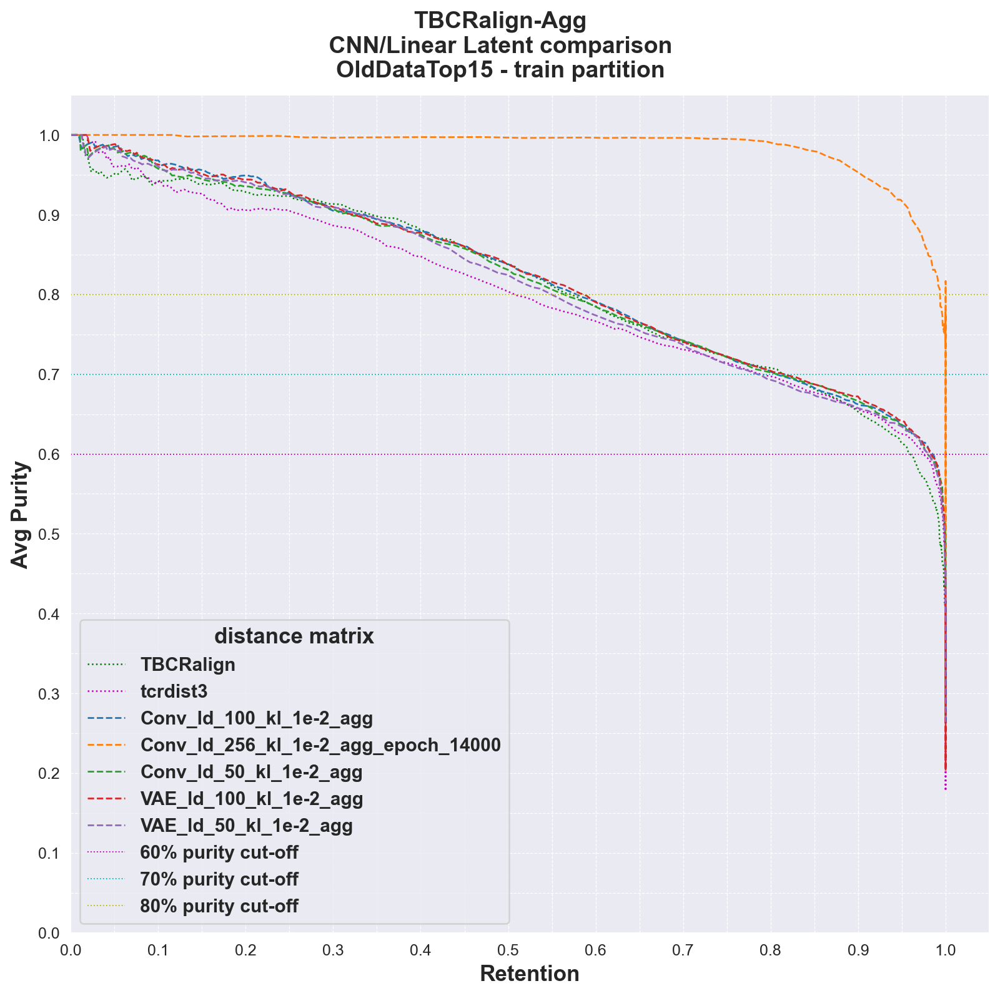

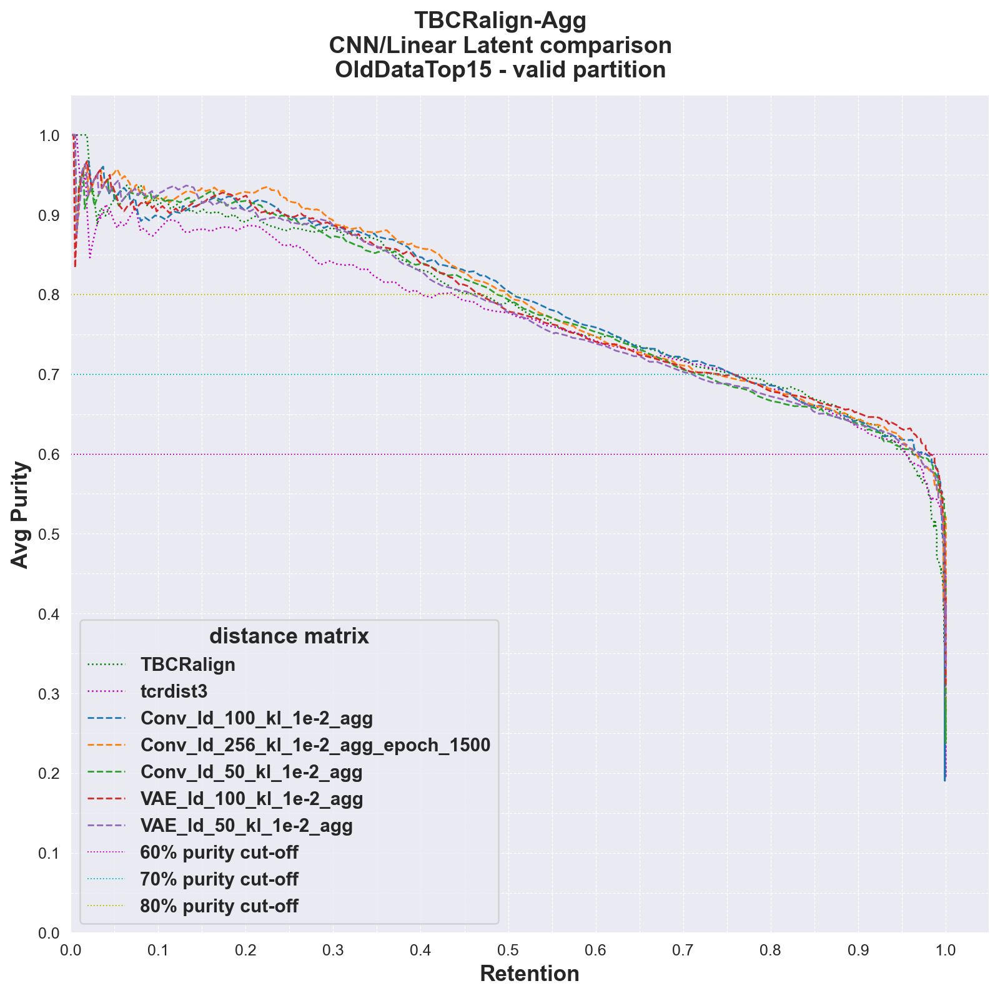

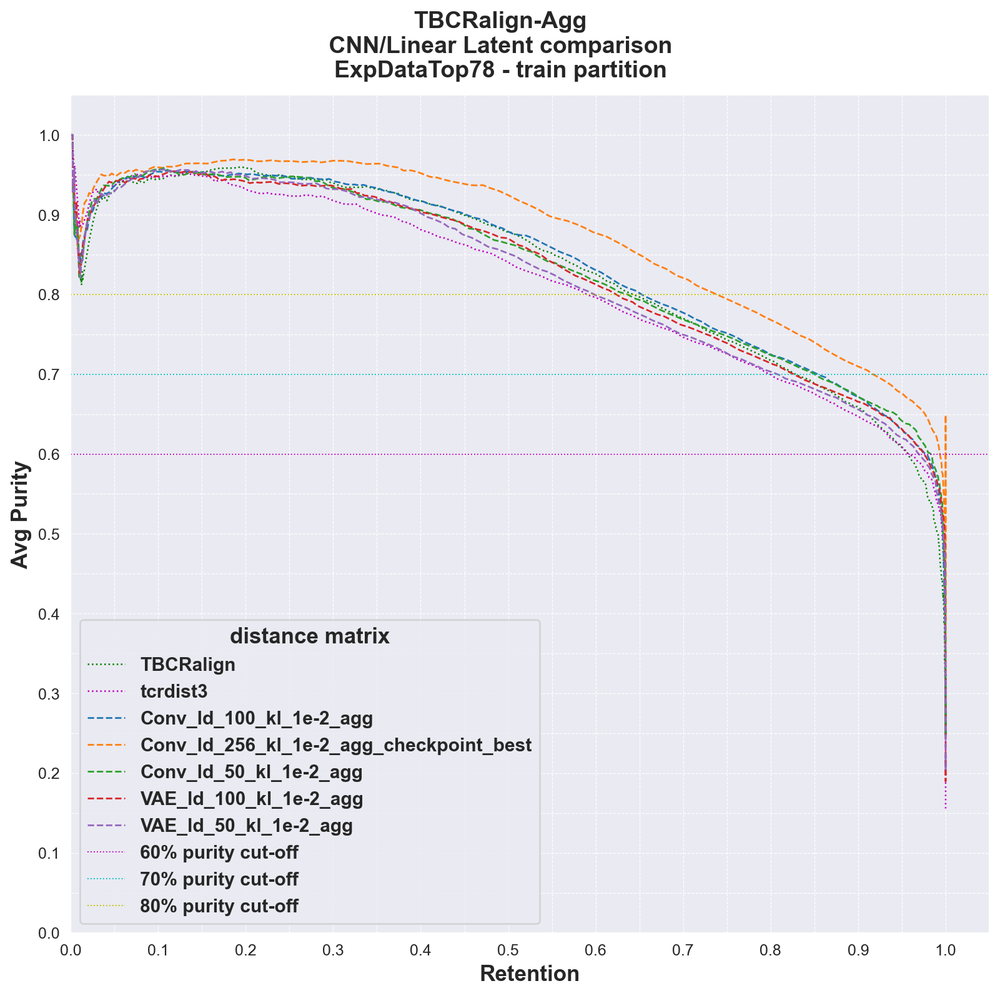

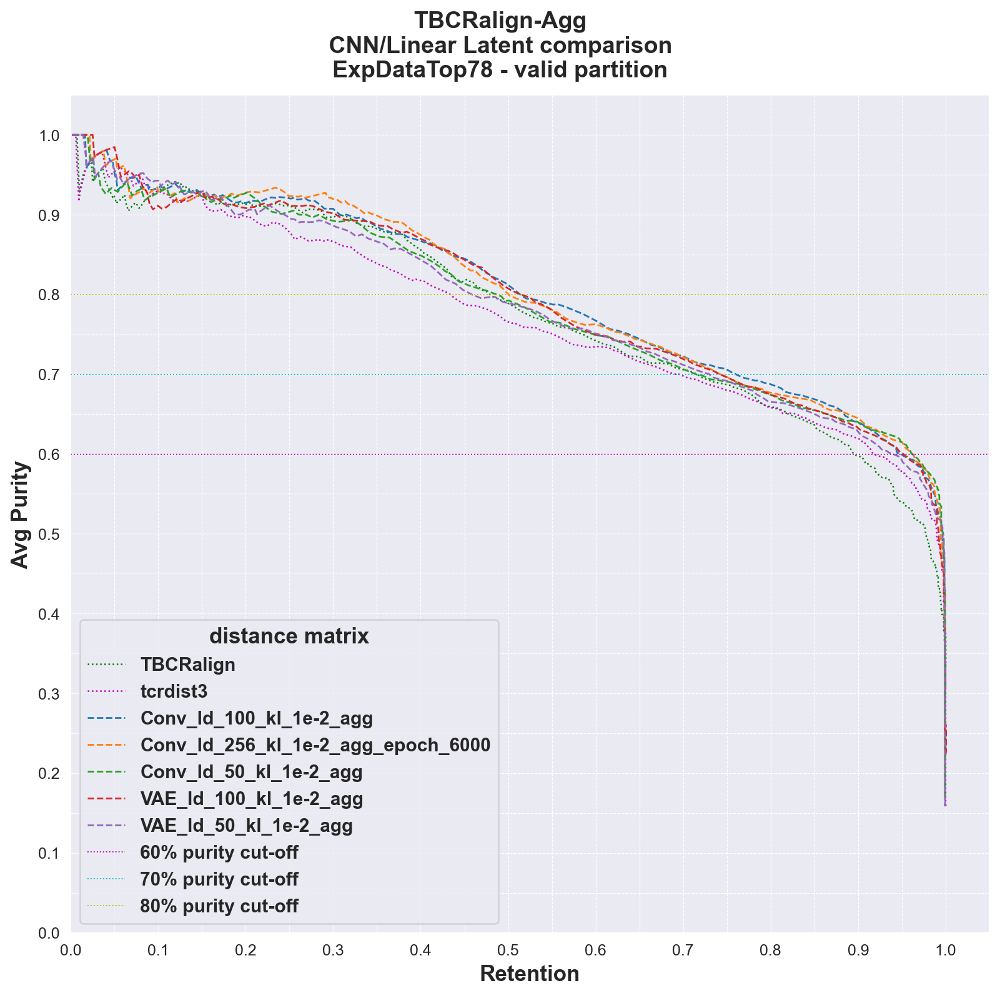

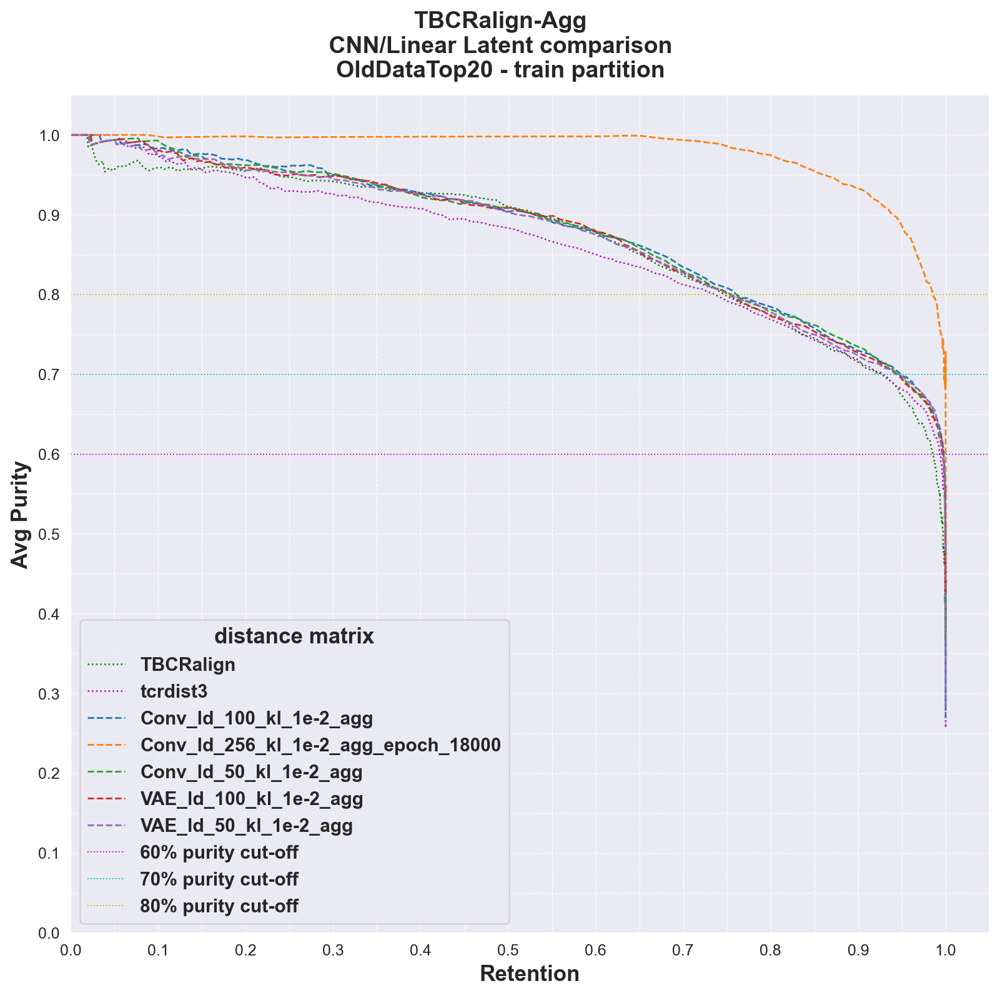

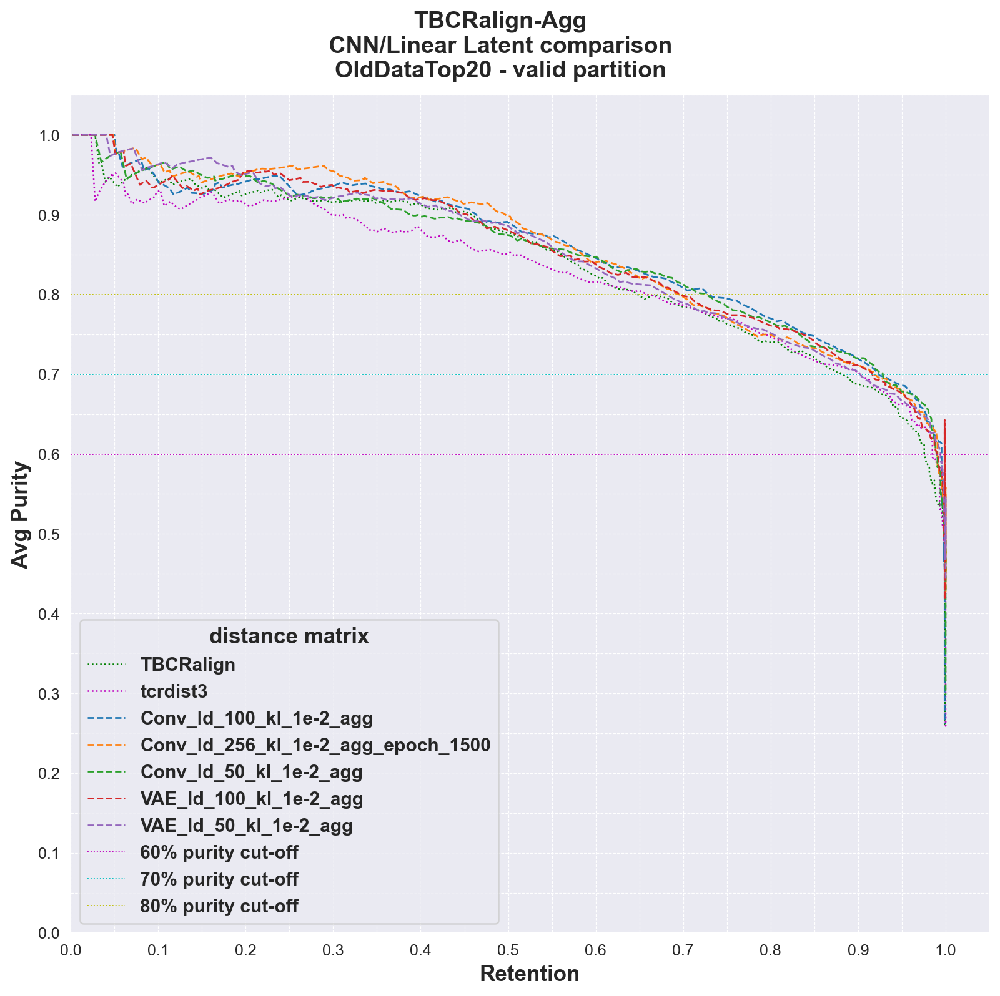

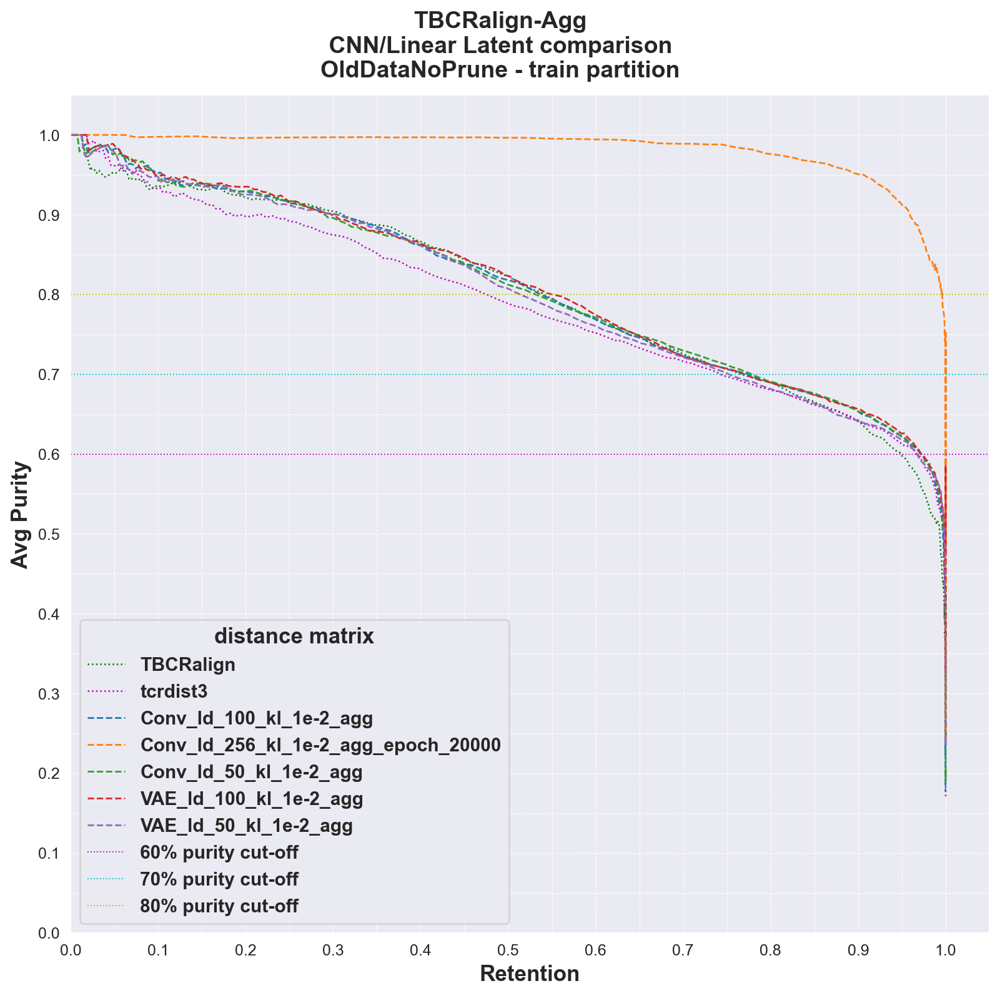

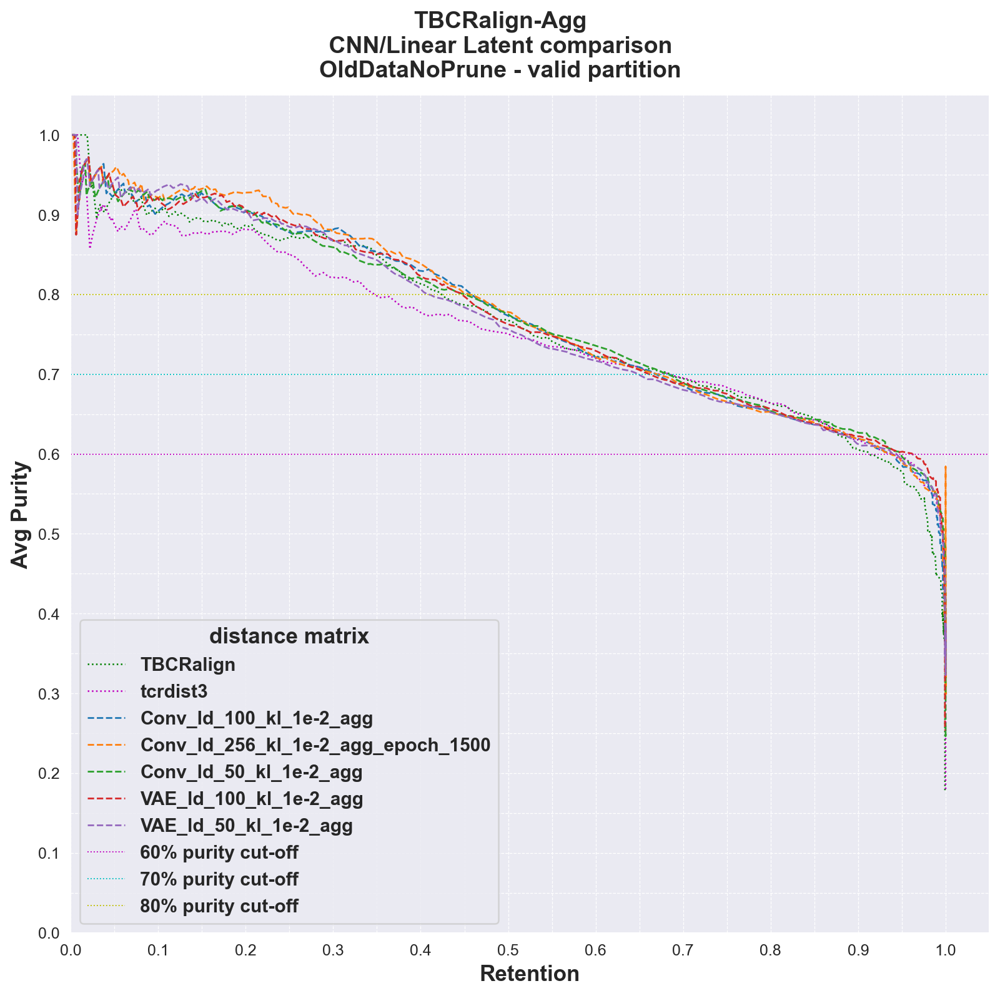

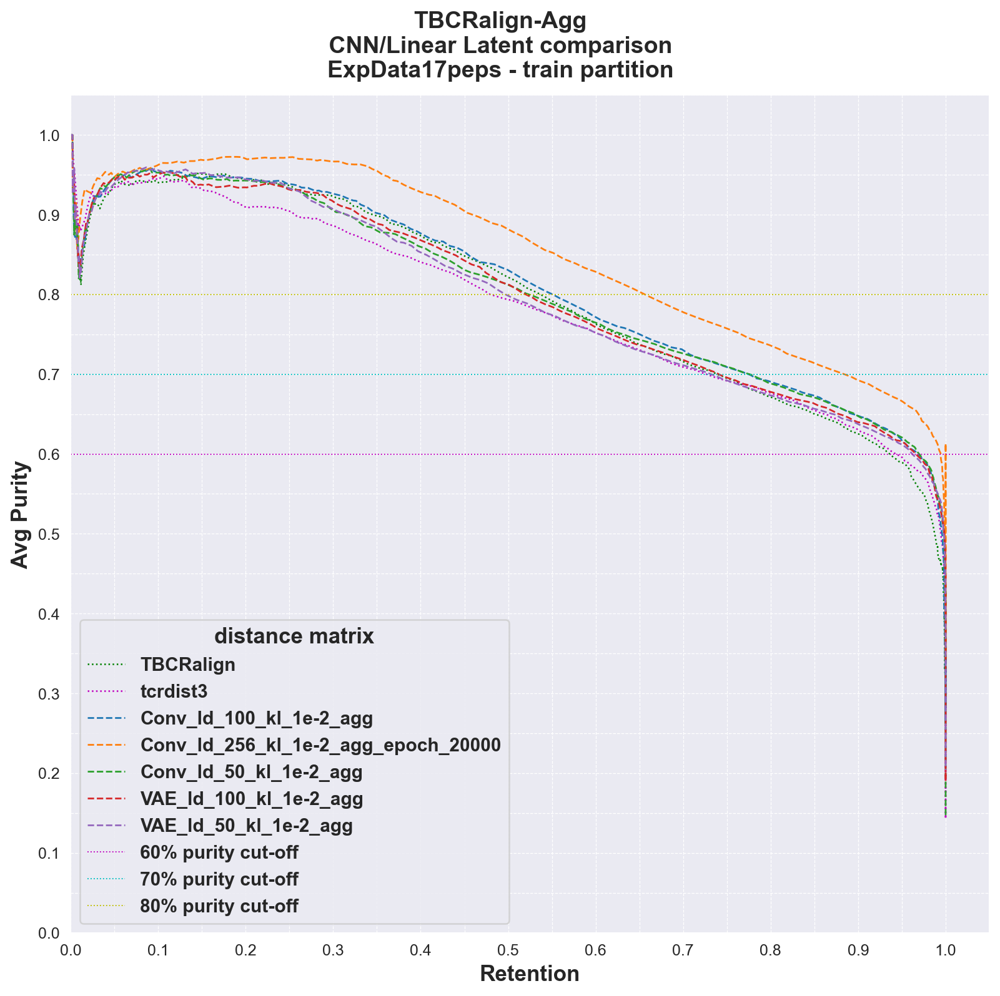

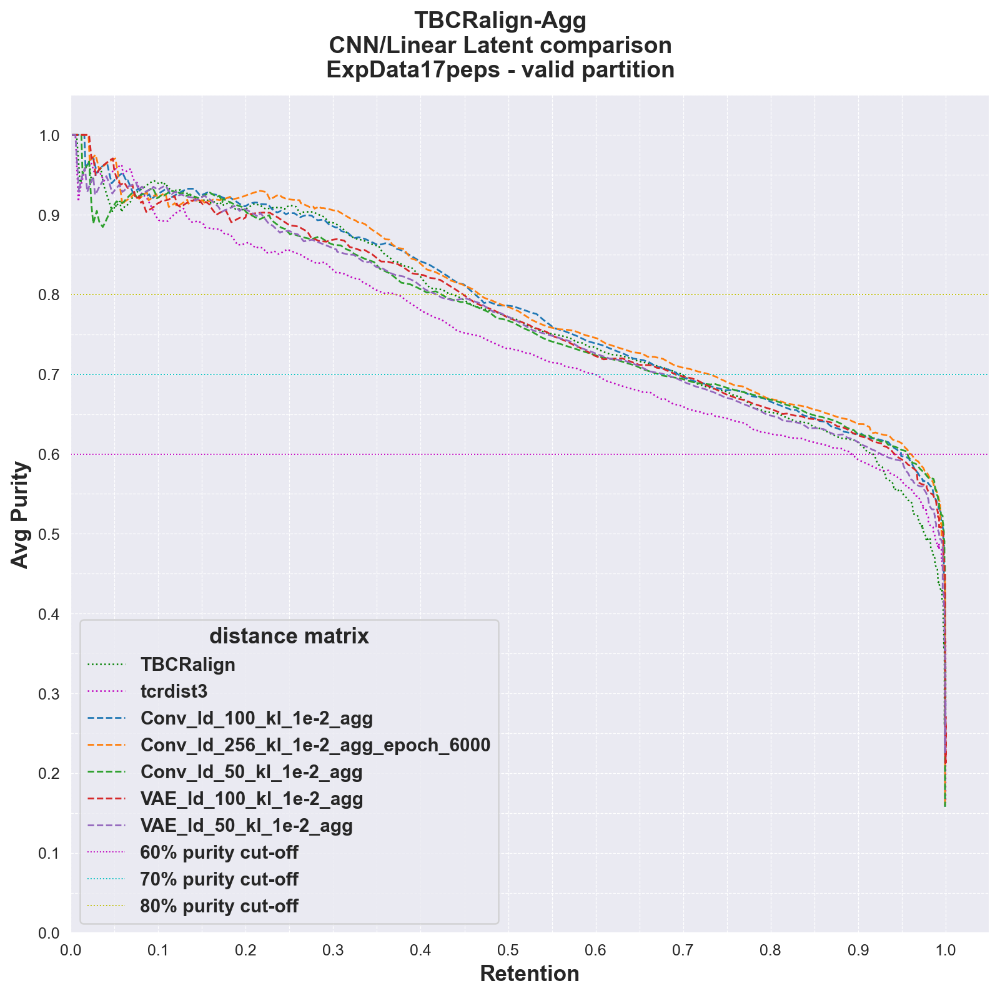

In [16]:
# First compare overffiting of LD 50 vs 100, choose the usual KLD (1e-2), CNN vs Lin
for dataset in datasets:
    train = get_agg_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'train', filters=['1e-2']) 
    valid = get_agg_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'valid', filters=['1e-2']) 
    order = ['TBCRalign', 'tcrdist3'] + sorted([x for x in valid.name.unique() if len(x)!=0])
    plot_pipeline_all(train, f'TBCRalign-Agg\n CNN/Linear Latent comparison \n{dataset} - train partition', f'{savedir}agg_overfit_comparisons_KL1e-2_{dataset}_train', 'tab10')
    plot_pipeline_all(valid, f'TBCRalign-Agg\n CNN/Linear Latent comparison \n{dataset} - valid partition', f'{savedir}agg_overfit_comparisons_KL1e-2_{dataset}_valid', 'tab10')

## Comparisons of KLDs for VAE vs CNN, with Latent dim = 100

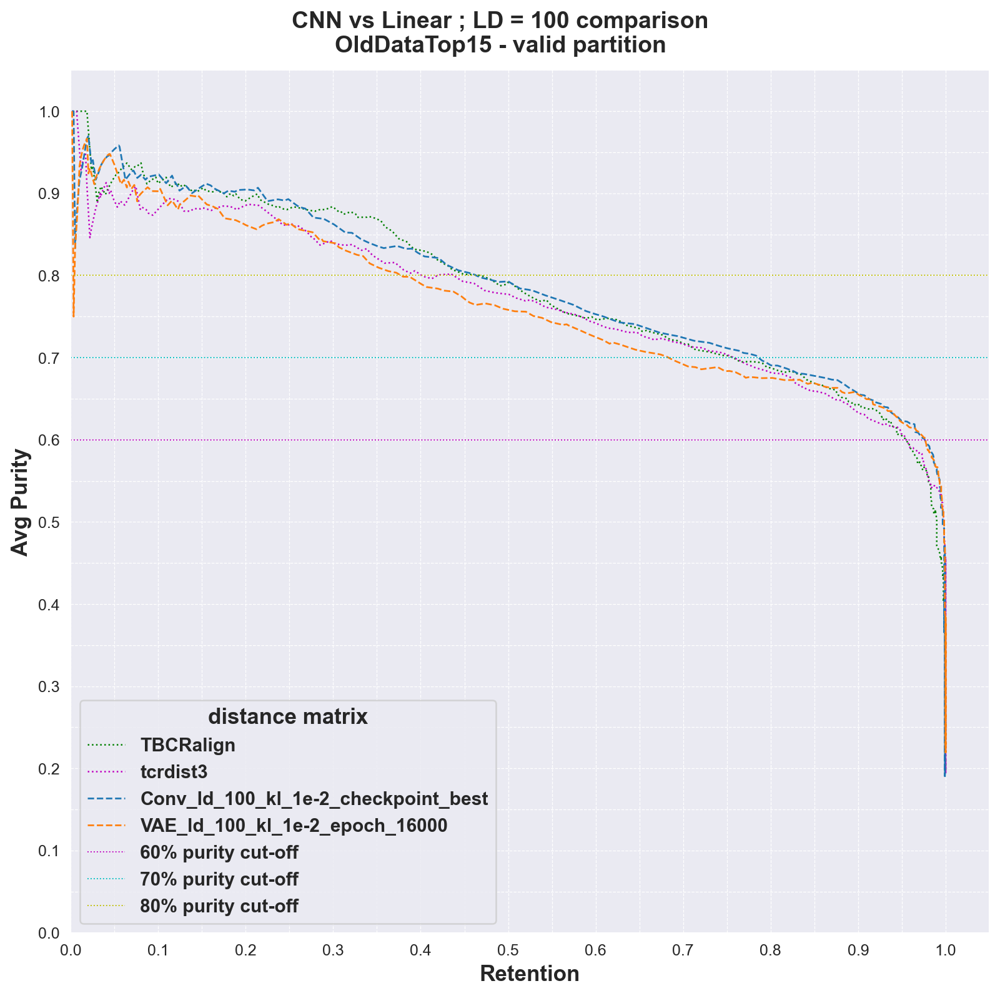

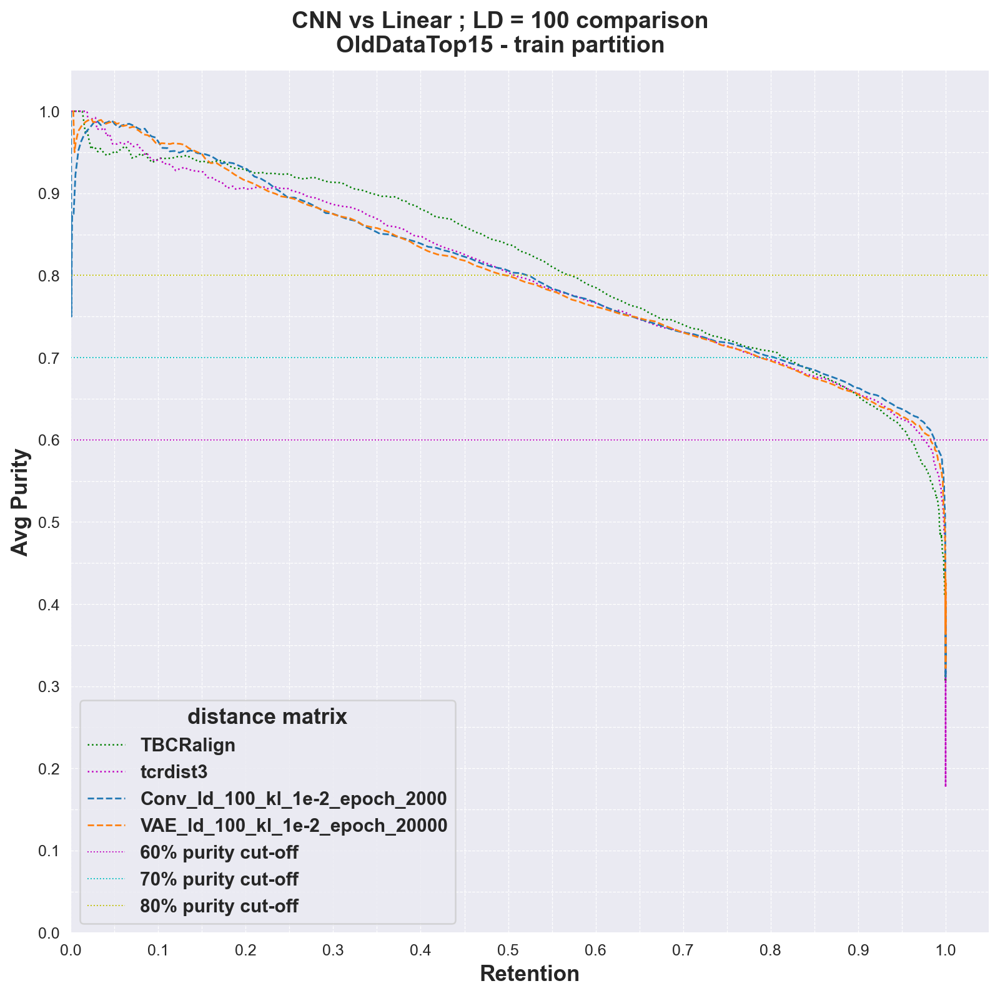

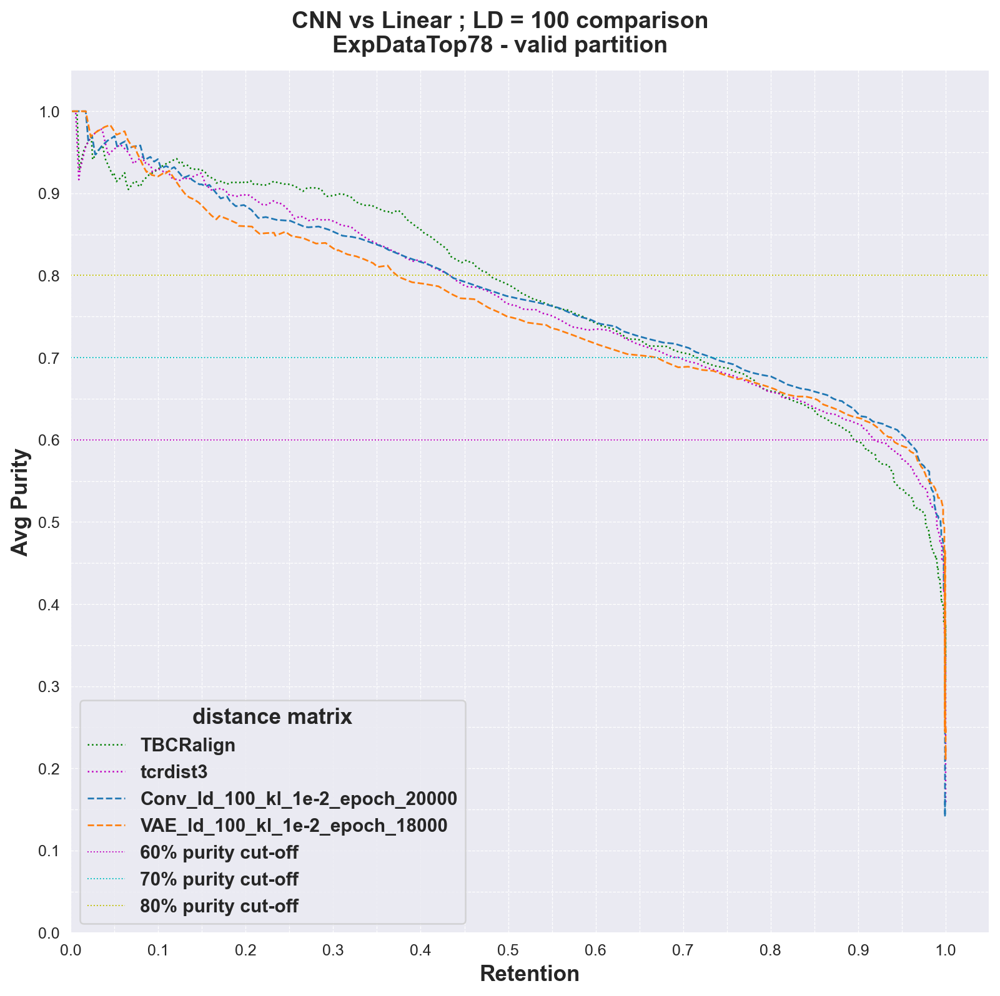

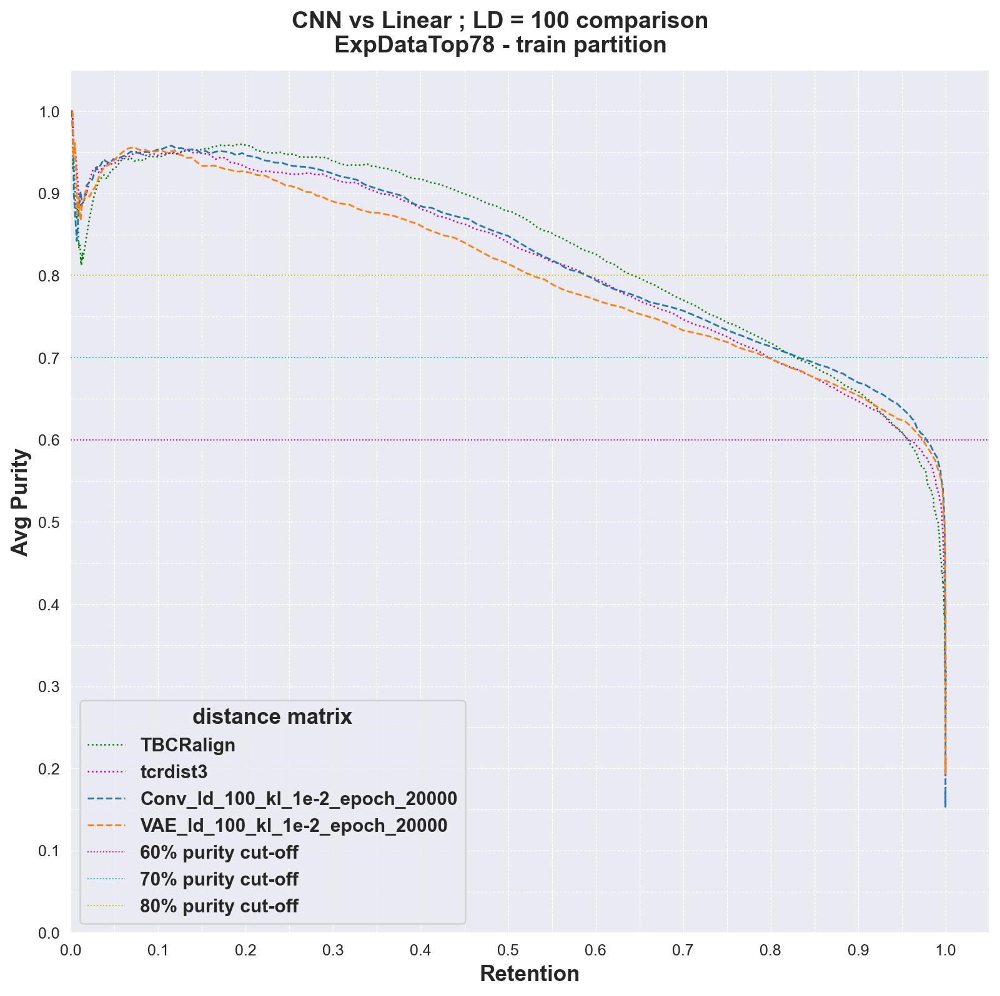

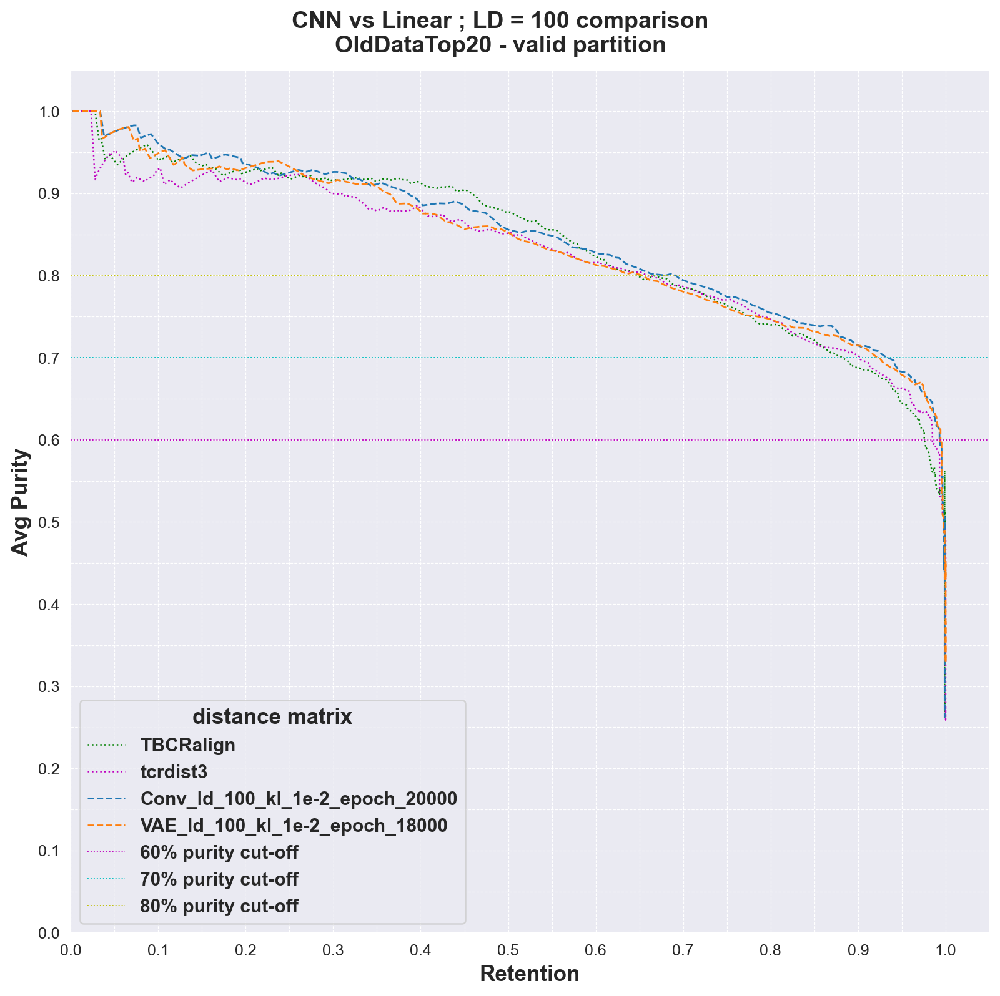

...

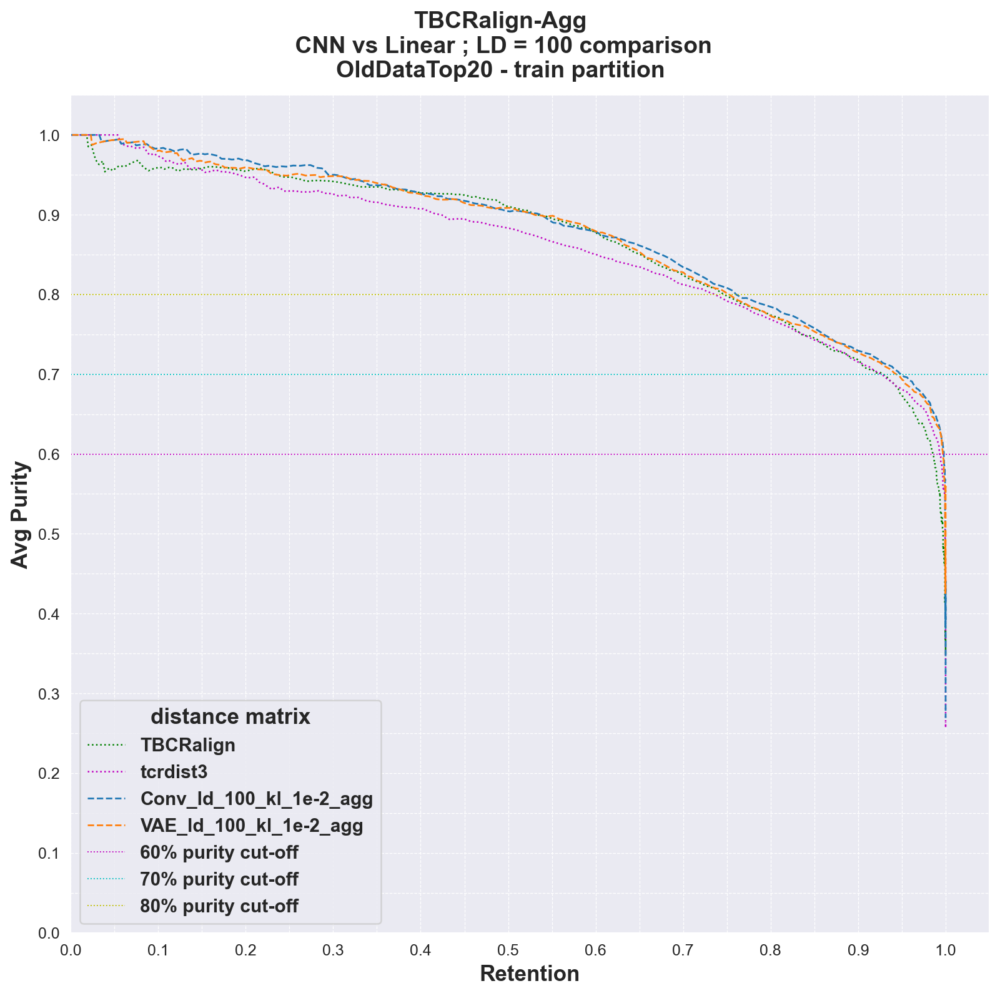

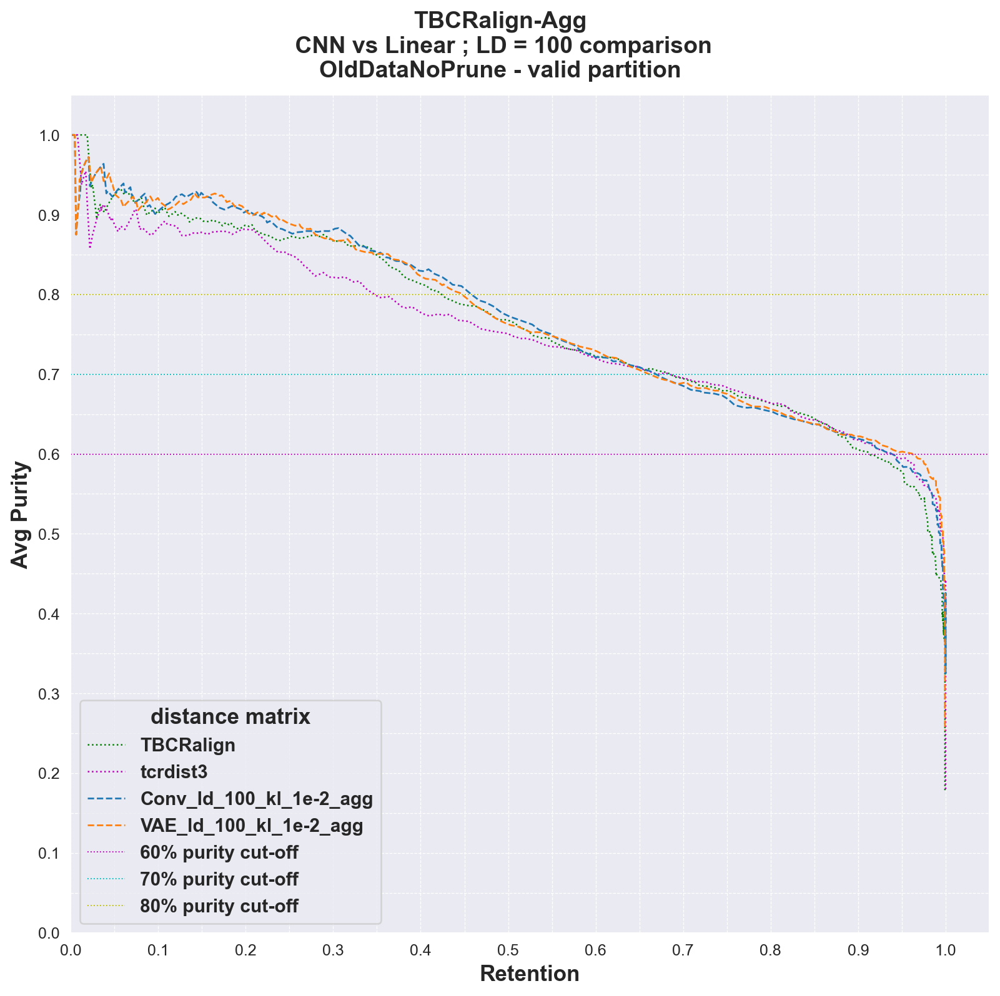

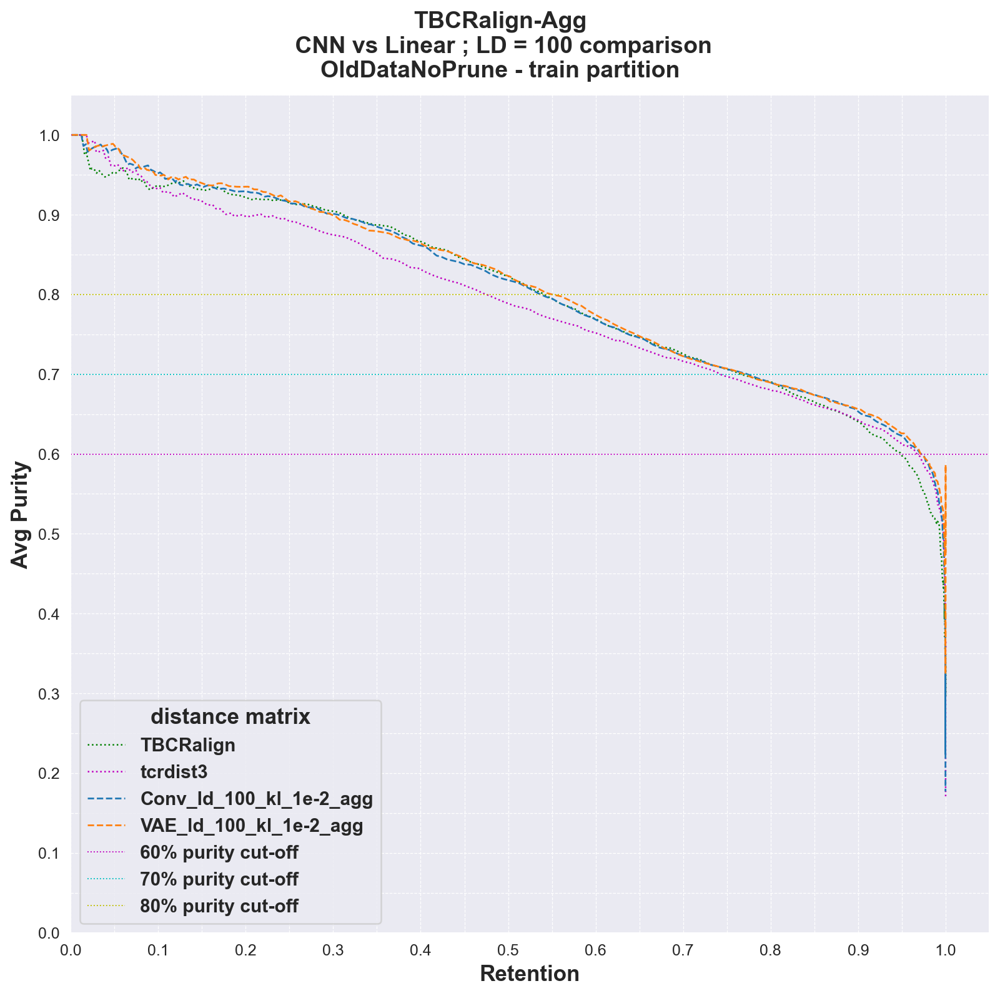

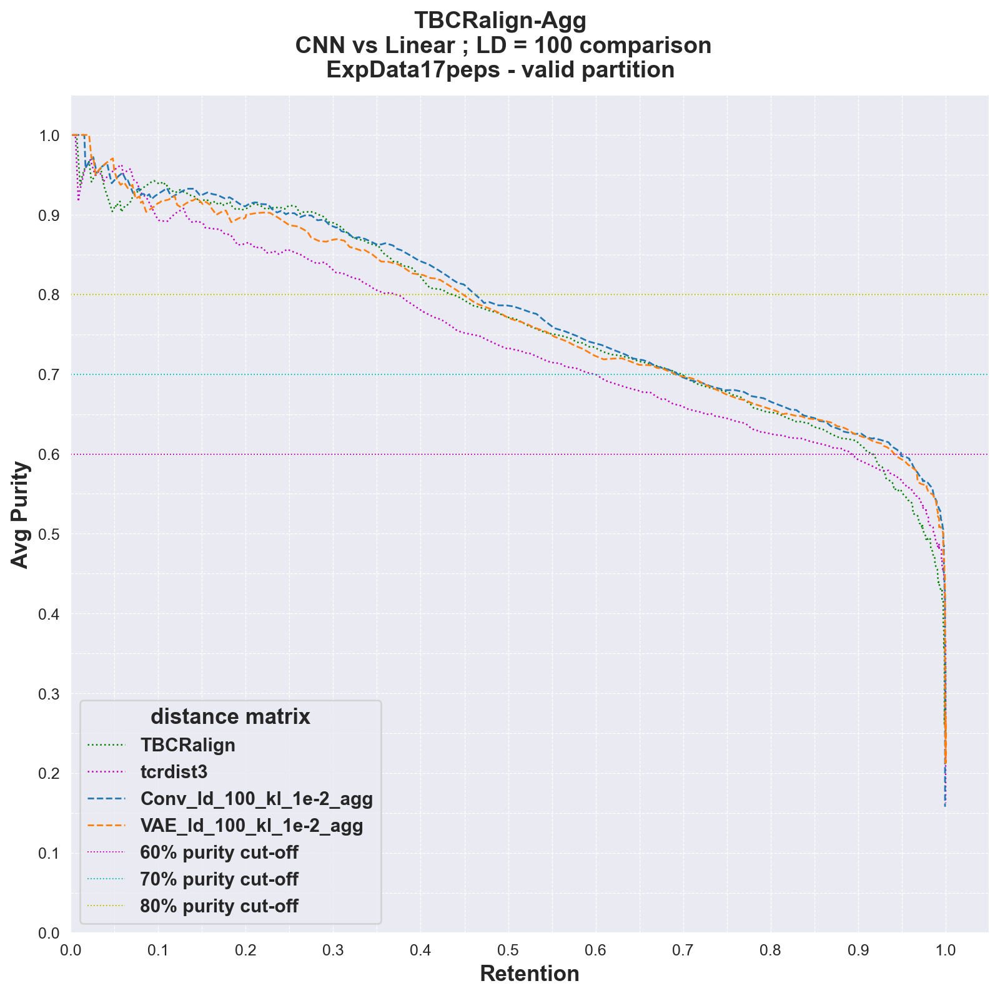

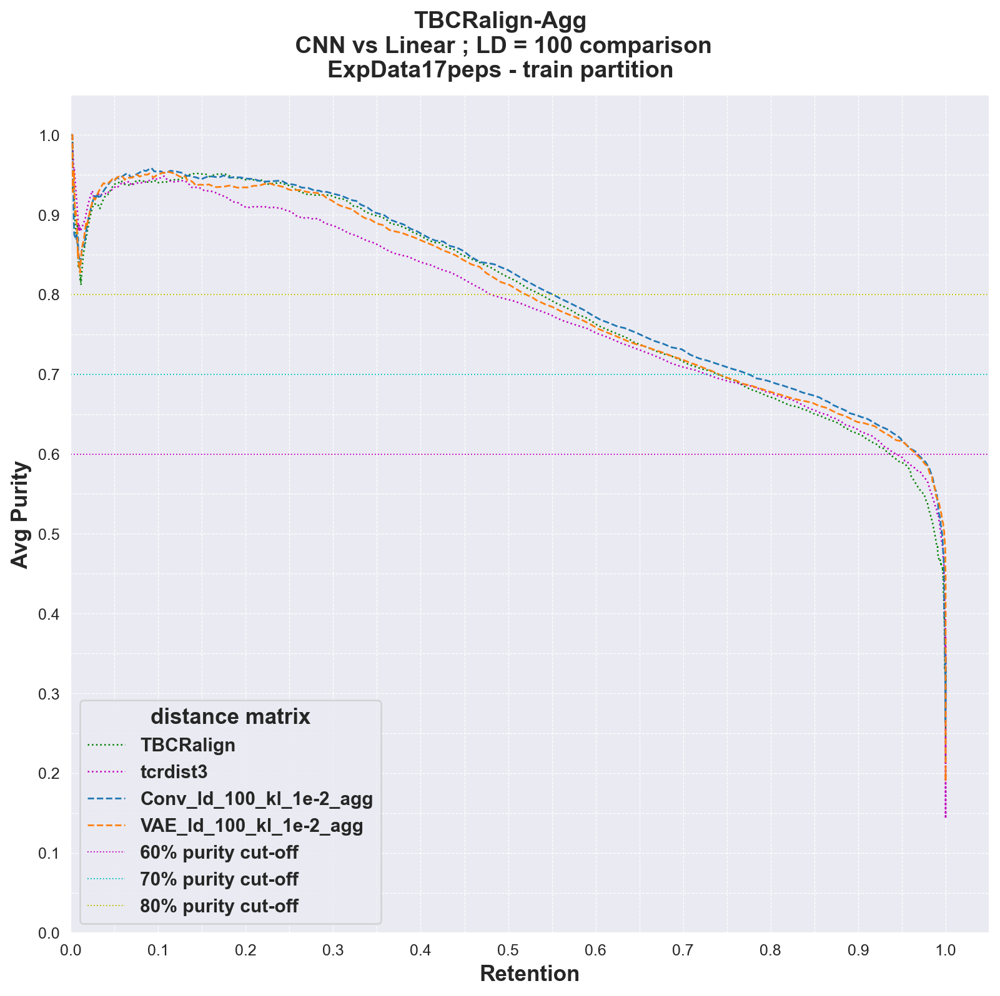

In [17]:
# First compare overffiting of LD 50 vs 100, choose the usual KLD (1e-2), CNN vs Lin
for dataset in datasets:
    valid = get_best_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'valid', filters=['ld_100_kl_1e-2']) 
    plot_pipeline_all(valid, f'CNN vs Linear ; LD = 100 comparison\n{dataset} - valid partition', f'{savedir}CNN_Lin_LD100_comparisons_{dataset}_valid', 'tab10')
    train = get_best_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'train', filters=['ld_100_kl_1e-2']) 
    plot_pipeline_all(train, f'CNN vs Linear ; LD = 100 comparison\n{dataset} - train partition', f'{savedir}CNN_Lin_LD100_comparisons_{dataset}_train', 'tab10')

# First compare overffiting of LD 50 vs 100, choose the usual KLD (1e-2), CNN vs Lin
for dataset in datasets:
    valid = get_agg_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'valid', filters=['ld_100_kl_1e-2']) 
    plot_pipeline_all(valid, f'TBCRalign-Agg\n CNN vs Linear ; LD = 100 comparison\n{dataset} - valid partition', f'{savedir}aggCNN_Lin_LD100_comparisons_{dataset}_valid', 'tab10')
    train = get_agg_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'train', filters=['ld_100_kl_1e-2']) 
    plot_pipeline_all(train, f'TBCRalign-Agg\n CNN vs Linear ; LD = 100 comparison\n{dataset} - train partition', f'{savedir}aggCNN_Lin_LD100_comparisons_{dataset}_train', 'tab10')

# Comparisons of various CNN KD for LD100

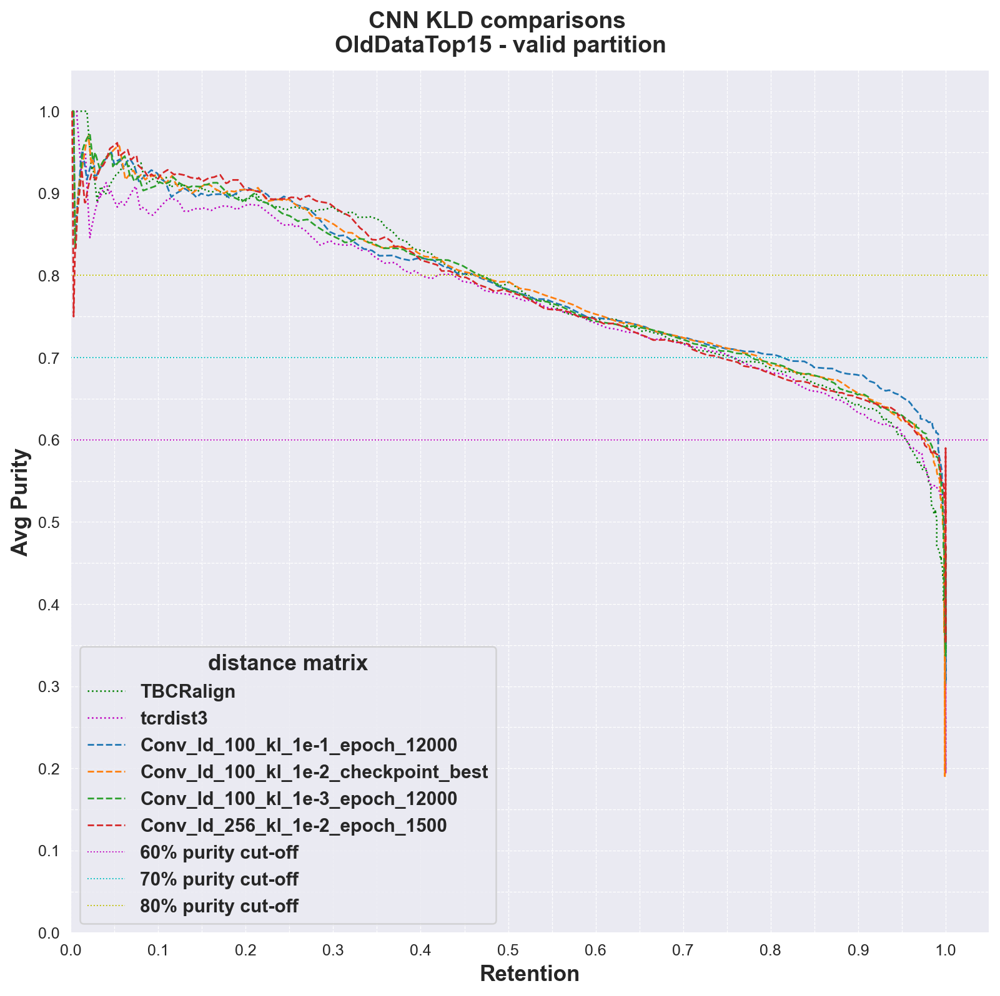

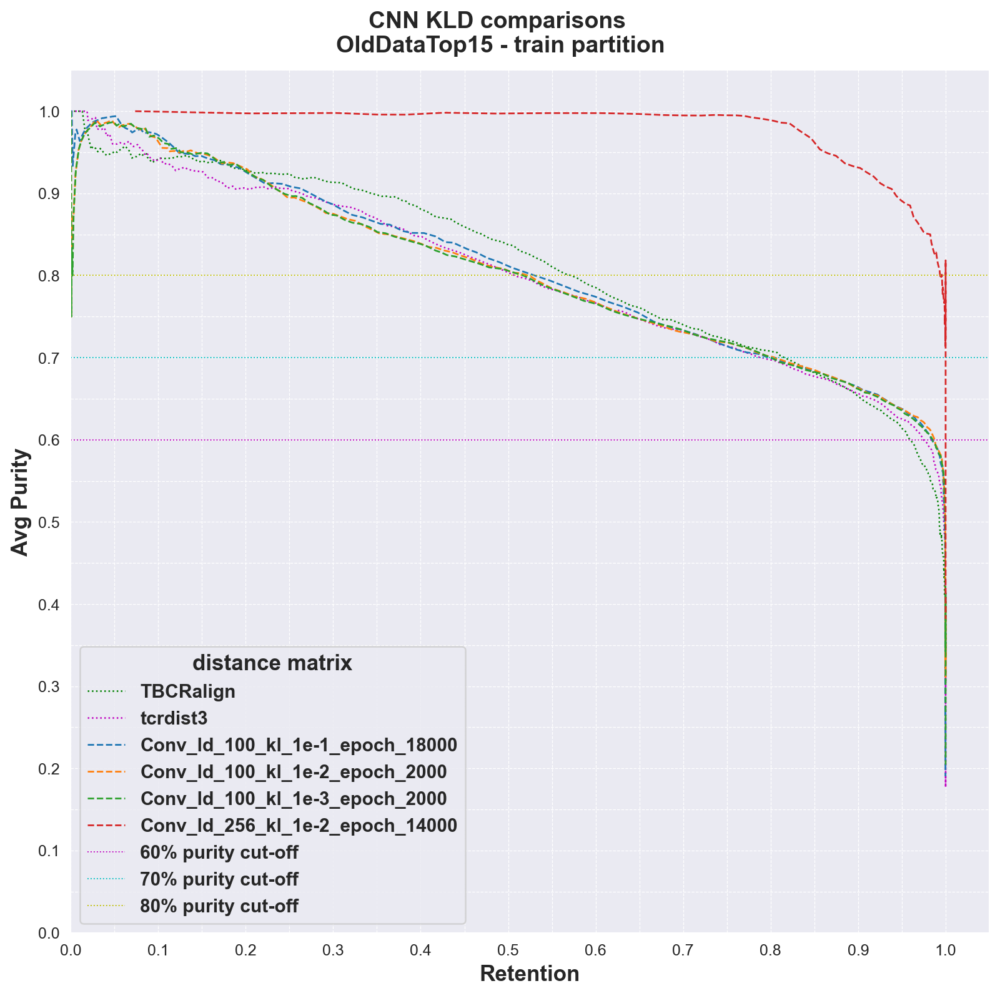

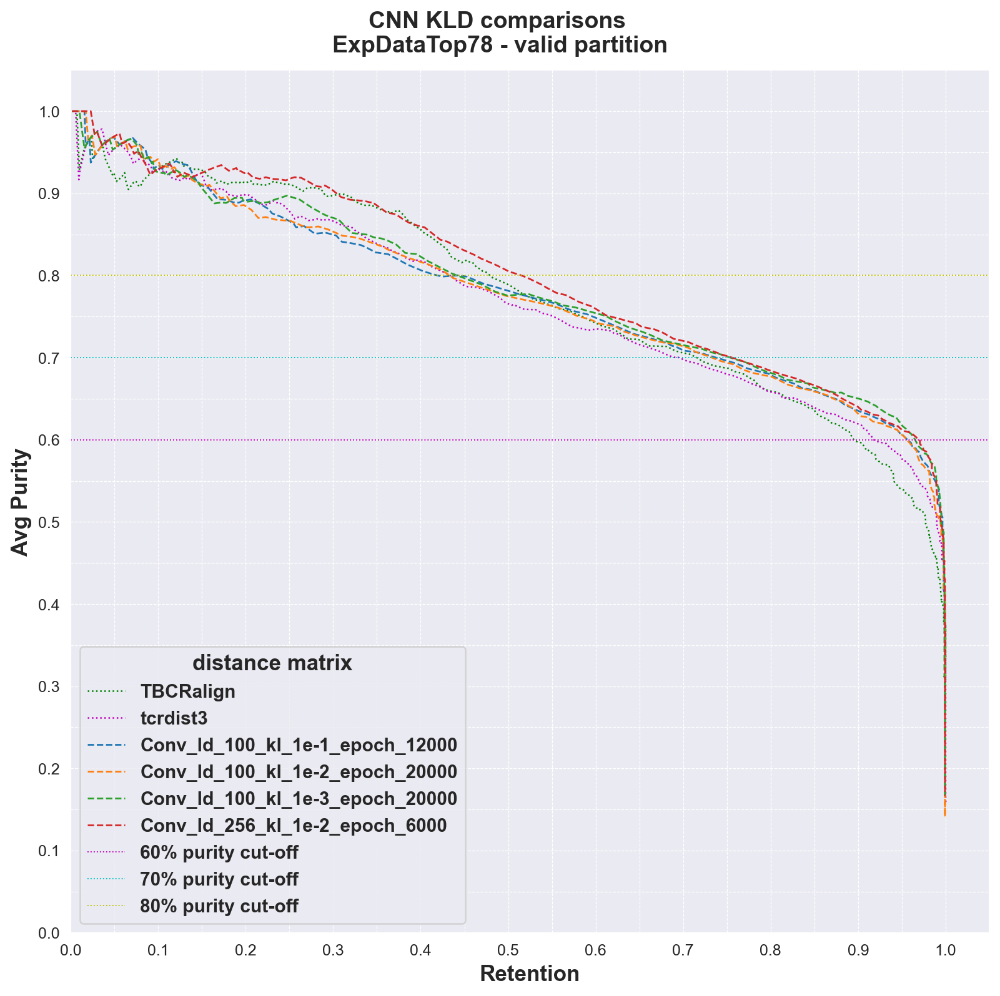

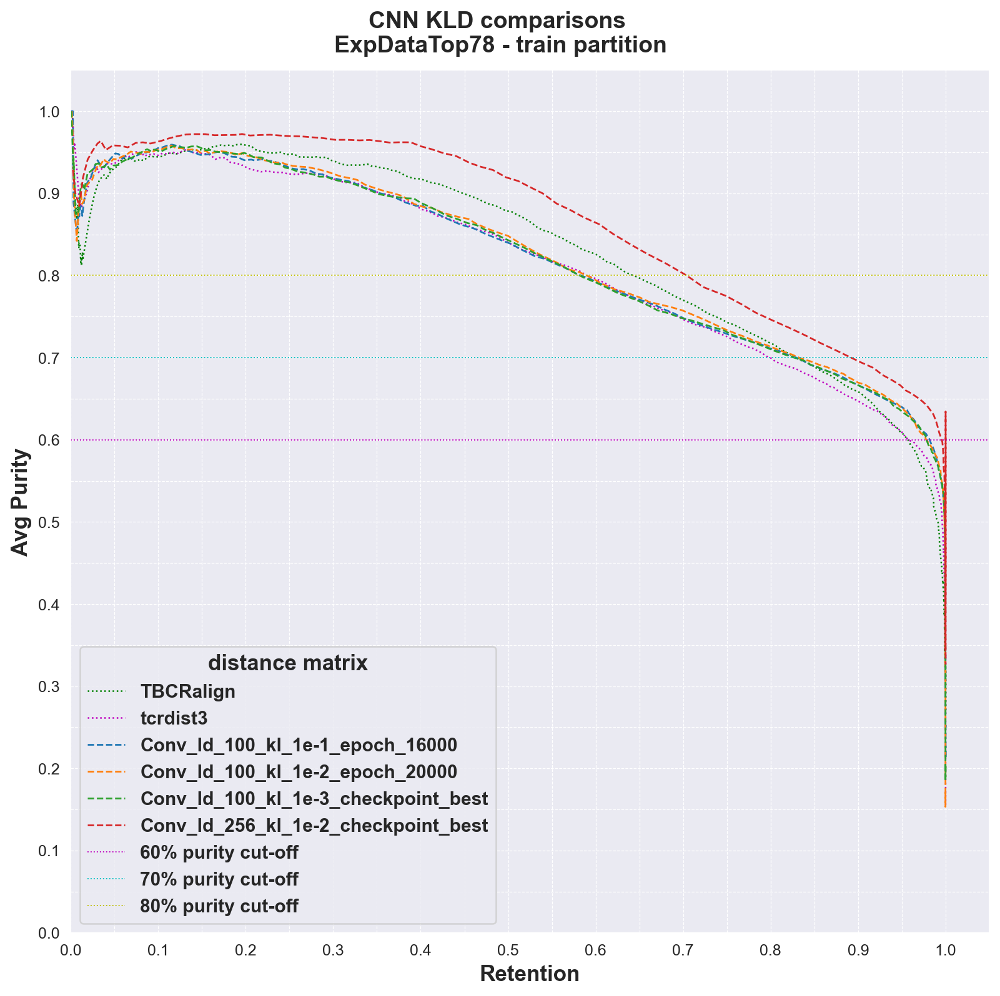

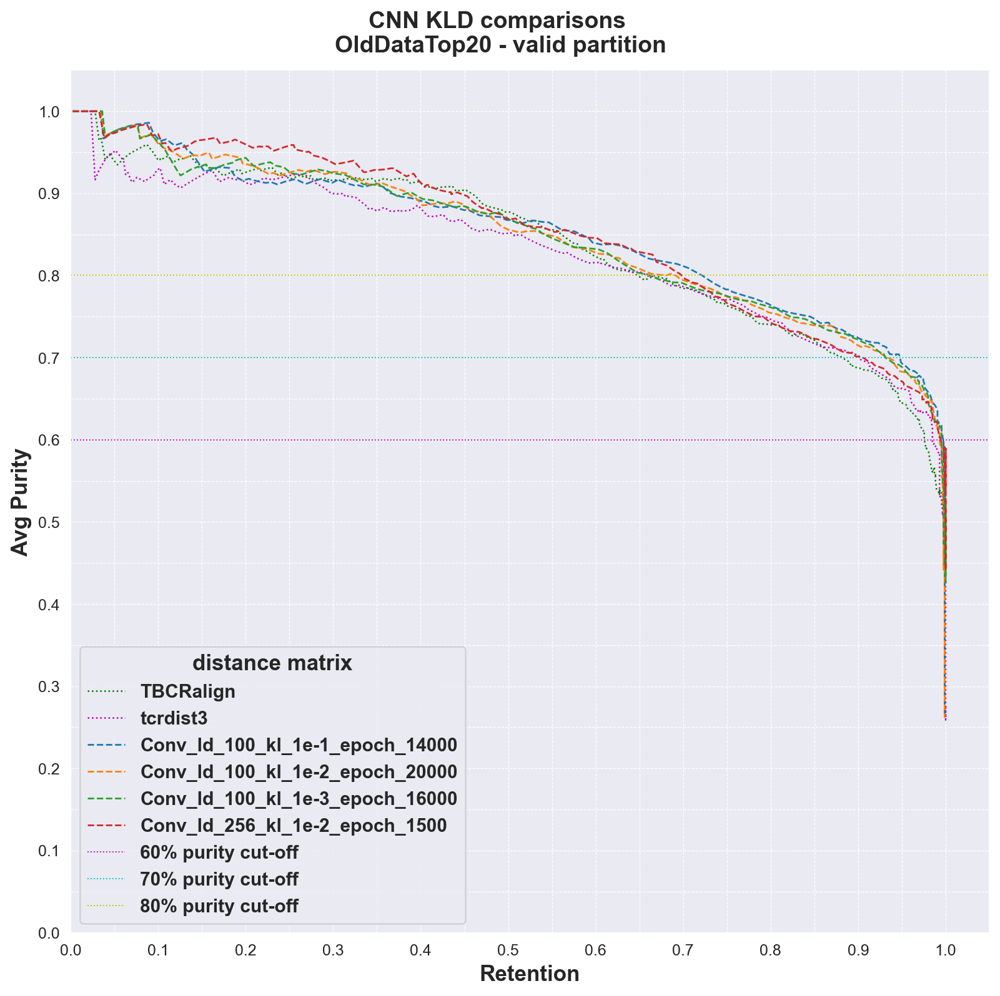

...

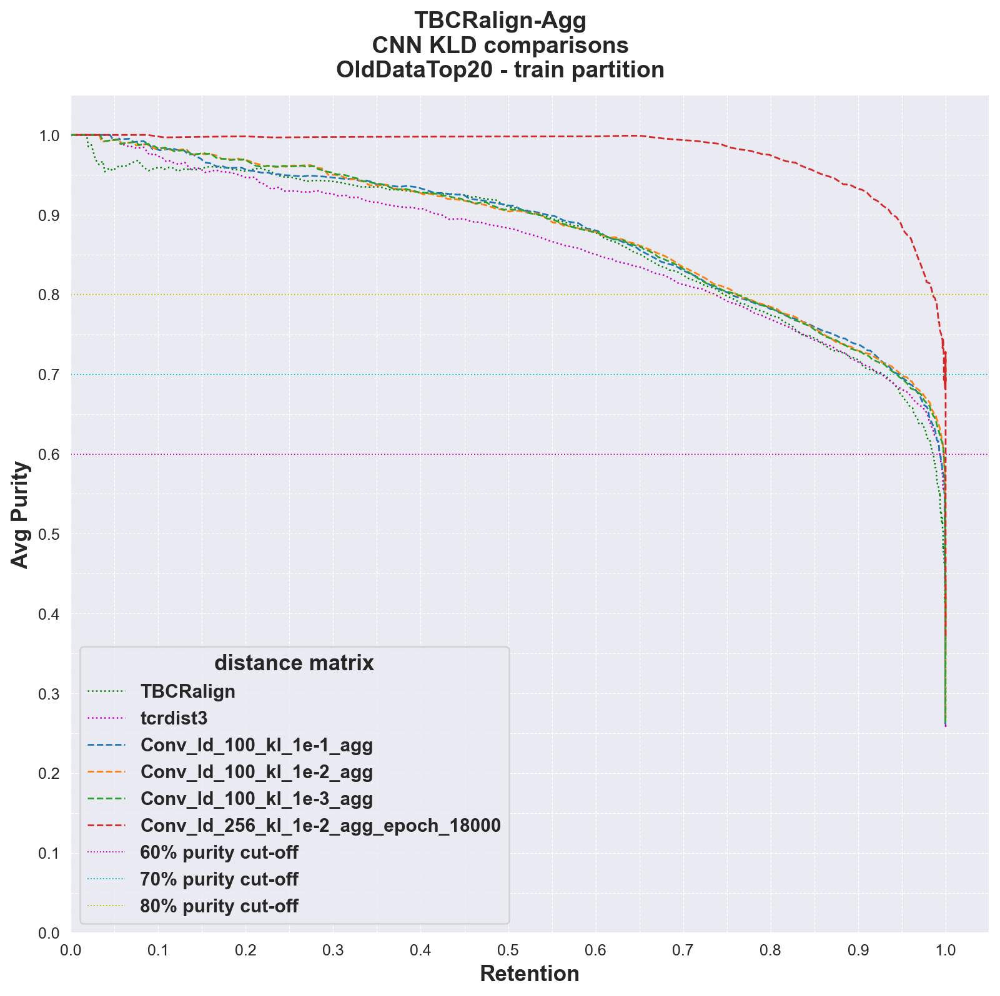

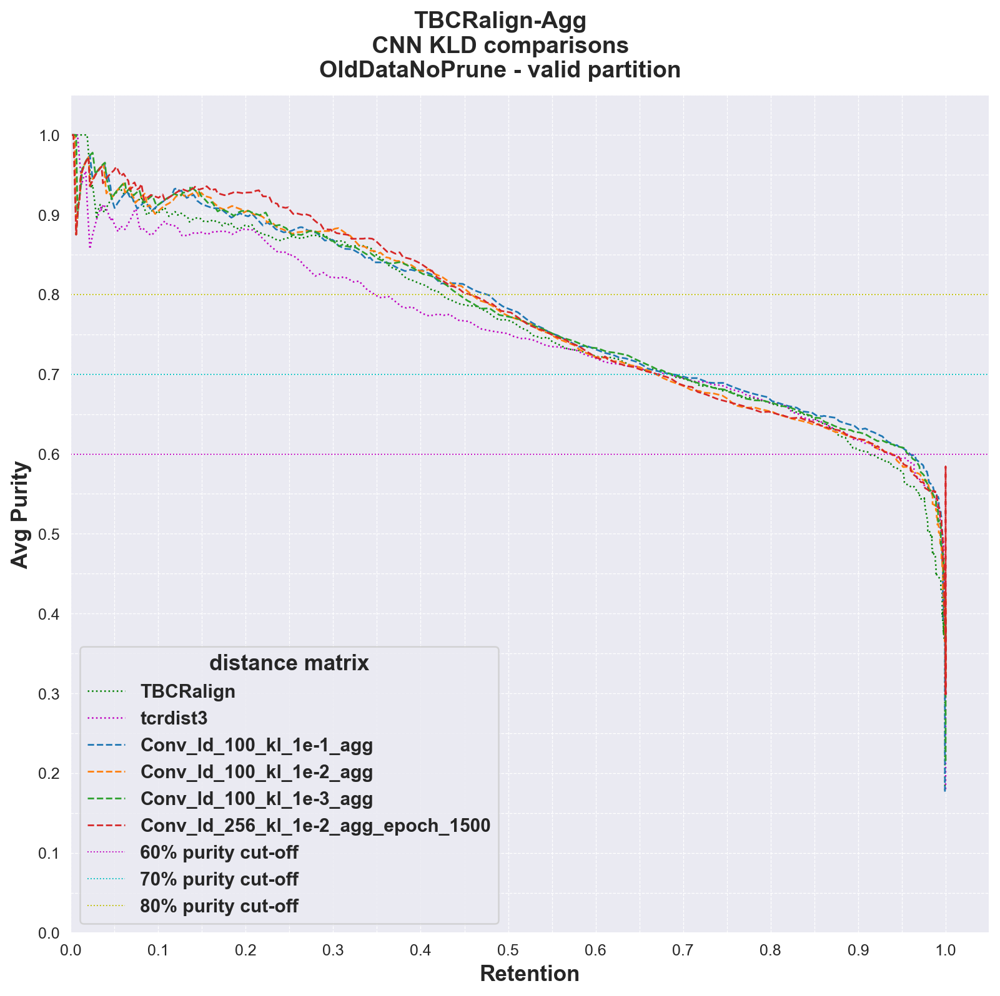

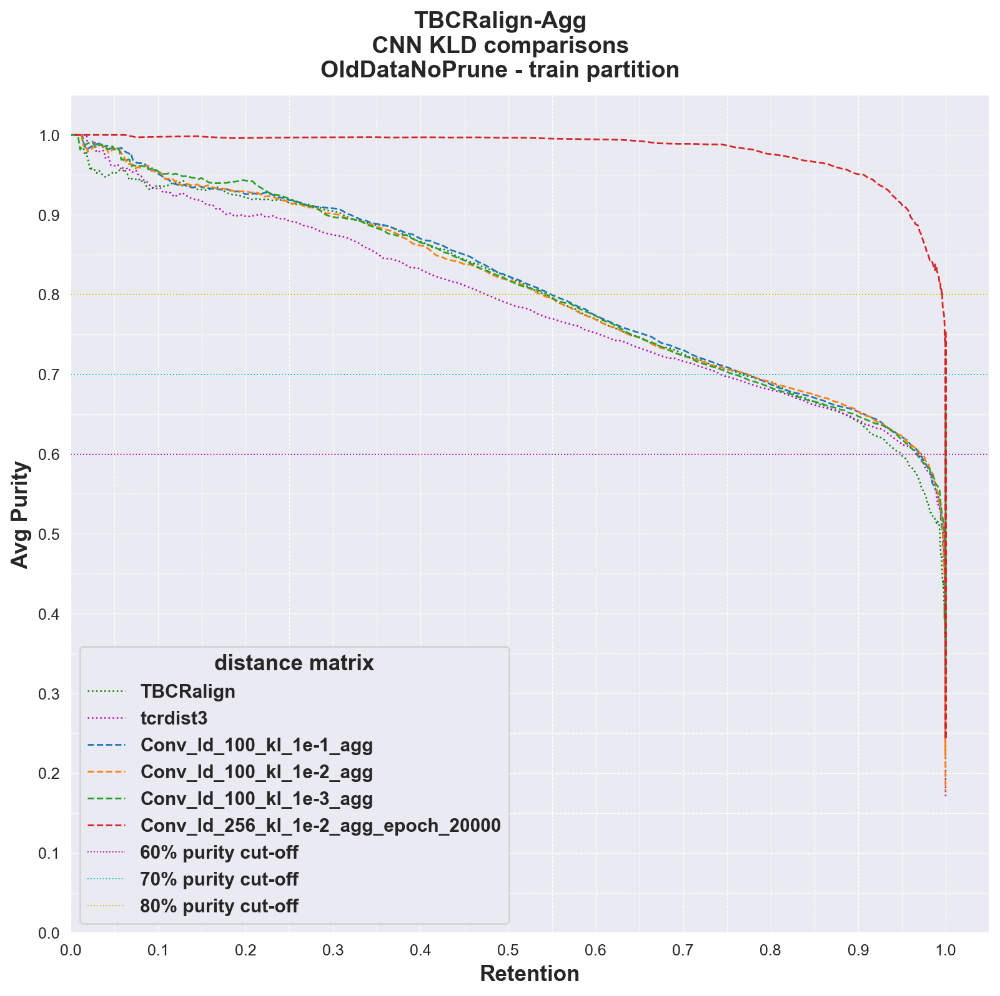

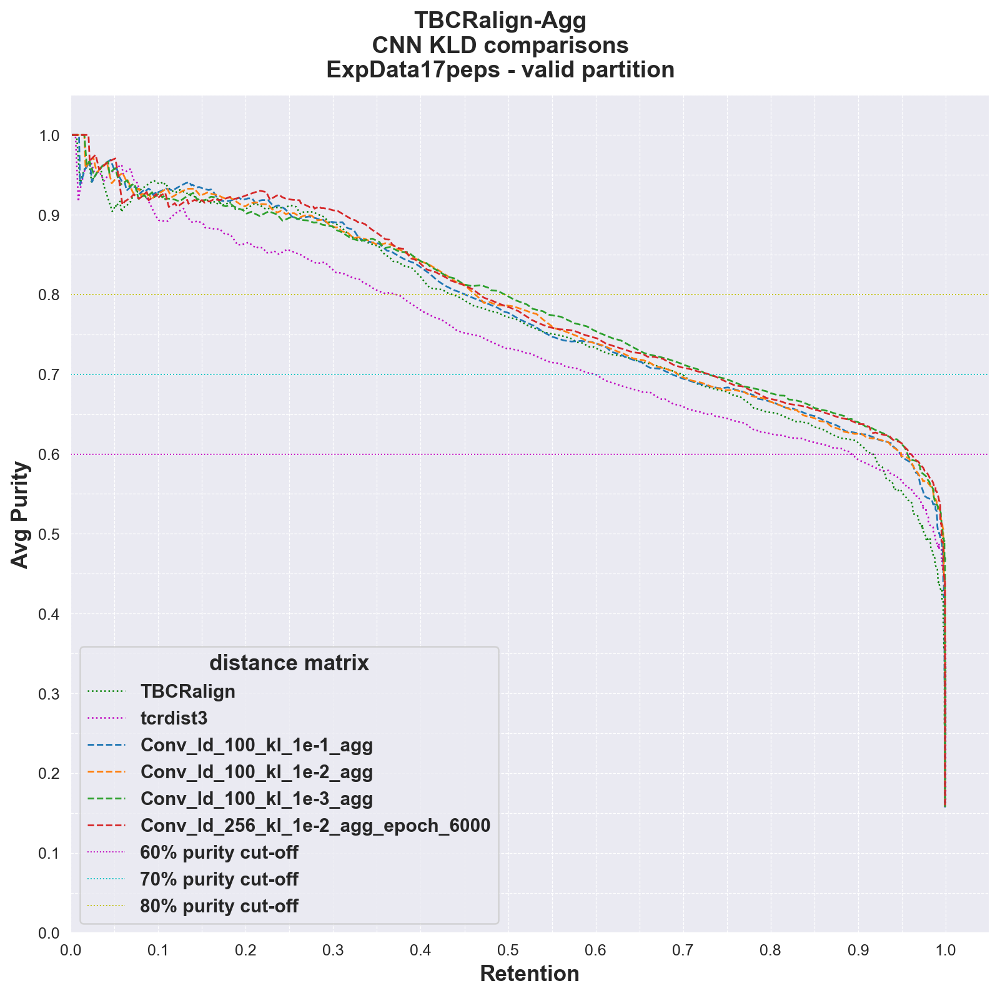

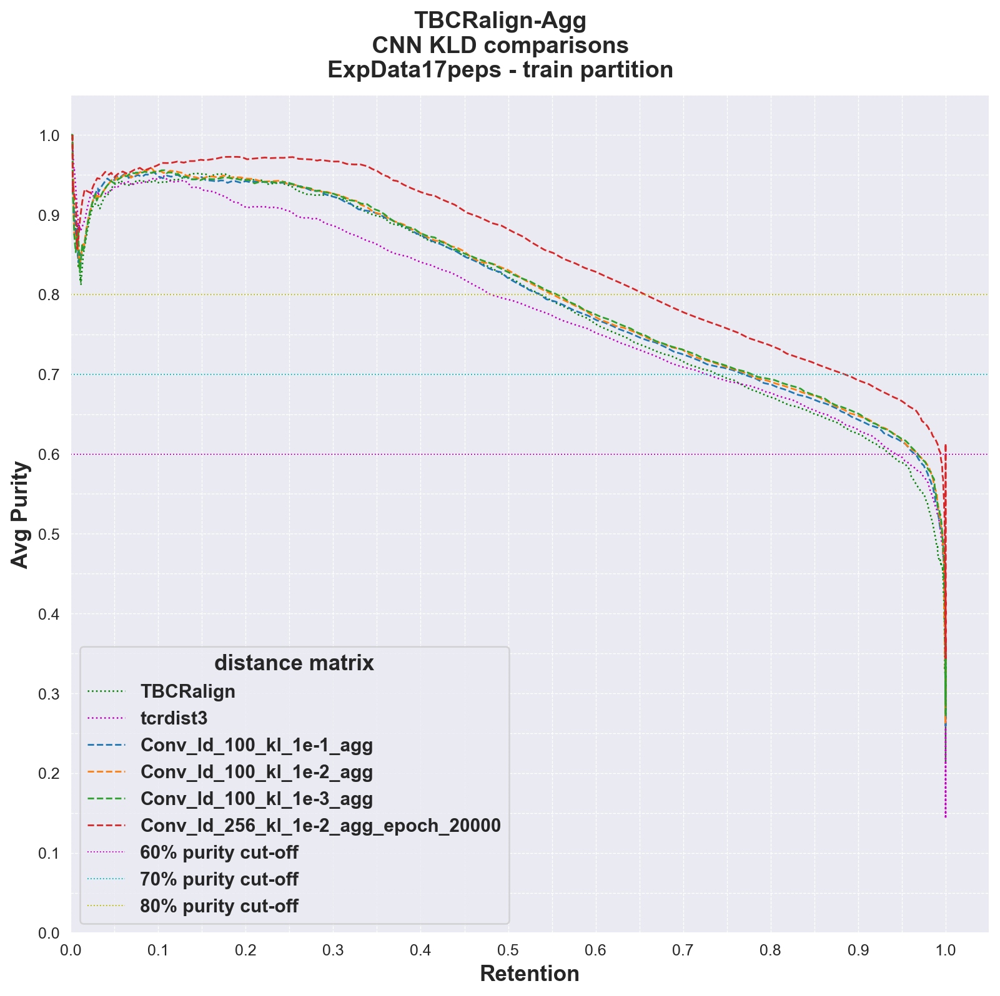

In [19]:
# First compare overffiting of LD 50 vs 100, choose the usual KLD (1e-2), CNN vs Lin
for dataset in datasets:
    valid = get_best_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'valid', filters=['Conv_ld_100', 'ld_256']) 
    plot_pipeline_all(valid, f'CNN KLD comparisons \n{dataset} - valid partition', f'{savedir}CNN_KLD_comparisons_{dataset}_valid', 'tab10')
    train = get_best_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'train', filters=['Conv_ld_100', 'ld_256']) 
    plot_pipeline_all(train, f'CNN KLD comparisons \n{dataset} - train partition', f'{savedir}CNN_KLD_comparisons_{dataset}_train', 'tab10')

# First compare overffiting of LD 50 vs 100, choose the usual KLD (1e-2), CNN vs Lin
for dataset in datasets:
    valid = get_agg_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'valid', filters=['Conv_ld_100', 'ld_256']) 
    plot_pipeline_all(valid, f'TBCRalign-Agg\n CNN KLD comparisons \n{dataset} - valid partition', f'{savedir}agg_CNN_KLD_comparisons_{dataset}_valid', 'tab10')
    train = get_agg_given_dir_diag2(f'../output/240527_DiagnosticRound2/clustering/{dataset}/', 'train', filters=['Conv_ld_100', 'ld_256']) 
    plot_pipeline_all(train, f'TBCRalign-Agg\n CNN KLD comparisons \n{dataset} - train partition', f'{savedir}agg_CNN_KLD_comparisons_{dataset}_train', 'tab10')

# NXMinimum spanning trees

In [217]:
import networkx as nx
from src.cluster_utils import *

## old stuff

In [13]:
files_dict = pkl_load('../output/240411_ClusteringTests/files_dict.pkl')
comp_dict = pkl_load('../output/240411_ClusteringTests/comp_dict.pkl')

In [37]:
# Select the best model from FullExp 0200 KL 1e-1
folder = files_dict['FullExp_KL_1e-1']
join = '_'.join([comp_dict['FullExp_KL_1e-1'][-2], comp_dict['FullExp_KL_1e-1'][-1]])+'_'
js = glob.glob(f'{folder}*kwargs*.json')[0]
pt = glob.glob(f'{folder}*{join}*.pt')[0]
model = load_model_full(pt, js, map_location='cpu')
latent_df = get_latent_df(model, pd.read_csv('../data/filtered/240418_nettcr_expanded_20binders_17pep_POSONLY.csv').query('partition==0'))

Reloading best model:
epoch: 10000
total: 0.133039653301239
reconstruction: 0.0919111892580986
kld: 0.024339670315384865
triplet: 0.016788793727755547
seq_accuracy: 0.9892194867134094
pos_accuracy: 0.9978100657463074
{'max_len_a1': 7, 'max_len_a2': 8, 'max_len_a3': 22, 'max_len_b1': 6, 'max_len_b2': 7, 'max_len_b3': 23, 'max_len_pep': 0, 'encoding': 'BL50LO', 'pad_scale': -20, 'a1_col': 'A1', 'a2_col': 'A2', 'a3_col': 'A3', 'b1_col': 'B1', 'b2_col': 'B2', 'b3_col': 'B3', 'pep_col': 'peptide', 'add_positional_encoding': True}


In [39]:
tbcr_valid['original_peptide'] = tbcr_valid['peptide']
tbcr_valid, tbcr_array = resort_baseline(tbcr_valid, latent_df, 'raw_index')
dist_matrix, dist_array, features, labels, encoded_labels, label_encoder = get_distances_labels_from_latent(latent_df)
other_array = tbcr_valid.iloc[:len(tbcr_valid), :len(tbcr_valid)].values
agg_array = 1 - np.multiply(1-dist_array, 1-other_array)


1471


In [40]:
len(latent_df), agg_array.shape

(1471, (1471, 1471))

In [ ]:
from src.networkx_utils import collect_init_subgraphs, create_graph_from_subgraphsets, trim_graph_into_subgraphs
priority_abags = set()

#create initial graphs
#abag_adjmatrix np.array (nr_seq, nr_seqs)
init_graph = nx.Graph(agg_array)
datasize = len(init_graph)
size_cutoff = 3

okay_subgraphs, subgraphs_to_trim = collect_init_subgraphs(init_graph, size_cutoff = size_cutoff)
print(f"Number of decently sized subgraphs  {len(okay_subgraphs)}")
print(f"Number of subgraphs that need to be trimmed {len(subgraphs_to_trim)}")

if subgraphs_to_trim:
    trimmed_subgraphs = []
    for g in subgraphs_to_trim: trimmed_subgraphs.extend(trim_graph_into_subgraphs(g, size_cutoff=size_cutoff, priority_nodes=priority_abags,
                                                                                   remove_multnodes=remove_multnodes, priority_limit=priority_limit))
#trim the graphs
all_graphs = okay_subgraphs + trimmed_subgraphs
finalG = create_graph_from_subgraphsets(init_graph, all_graphs)
finalG_subgraphs = list(nx.connected_components(finalG))
final_sizes = [len(t) for t in finalG_subgraphs ]
print(f"Final graph sizes {final_sizes}")

### Check with a small subset

In [812]:
subset_df = pd.read_csv('../data/filtered/240326_nettcr_paired_NOswaps.csv').query('peptide in ["GILGFVFTL", "RAKFKQLL", "LLWNGPMAV", "YLQPRTFLL","ELAGIGILTV"] and partition==0')

In [814]:
# load a CNN expAll small model to run agg matrix on the side
# load CNNVAE_ExpAl|_Smallerepoch_2500
# model = load_model_full('../output/240516_CNNVAE_DiffDatasets/240516_1703_CNNVAE_ExpAll_KF0_GroupSamplerSmaller_KL1e-1_LWT10_30kepochs_KFold_0_iksqch/epoch_2500_interval_checkpoint__fold00_kcv_240326_nettcr_paired_NOswaps_f00_240516_1703_CNNVAE_ExpAll_KF0_GroupSamplerSmaller_KL1e-1_LWT10_30kepochs_KFold_0_iksqch.pt',
#                         '../output/240516_CNNVAE_DiffDatasets/240516_1703_CNNVAE_ExpAll_KF0_GroupSamplerSmaller_KL1e-1_LWT10_30kepochs_KFold_0_iksqch/checkpoint_best_fold00_kcv_240326_nettcr_paired_NOswaps_f00_240516_1703_CNNVAE_ExpAll_KF0_GroupSamplerSmaller_KL1e-1_LWT10_30kepochs_KFold_0_iksqch_JSON_kwargs.json')

model = load_model_full('../output/240527_DiagnosticRound2/RedoHP_CNNVAE_latent_100_kld_1e-3_train_ExpAll_KFold_0_240529_1313_NK0Uy/checkpoint_best_fold00_kcv_240326_nettcr_paired_NOswaps_f00_RedoHP_CNNVAE_latent_100_kld_1e-3_train_ExpAll_KFold_0_240529_1313_NK0Uy.pt',
                        '../output/240527_DiagnosticRound2/RedoHP_CNNVAE_latent_100_kld_1e-3_train_ExpAll_KFold_0_240529_1313_NK0Uy/checkpoint_best_fold00_kcv_240326_nettcr_paired_NOswaps_f00_RedoHP_CNNVAE_latent_100_kld_1e-3_train_ExpAll_KFold_0_240529_1313_NK0Uy_JSON_kwargs.json')

latent = get_latent_df(model, subset_df)
xx = get_distances_labels_from_latent(latent, index_col='raw_index')
dm, da, labels = xx[0], xx[1], xx[3]

<class 'torch.nn.modules.batchnorm.BatchNorm1d'> 128 9 4 2 1 0 SELU()
No GPUs available. Using CPU.
Reloading best model:
Best epoch: 19887
total: 0.08891265526269541
reconstruction: 0.07188191963953366
kld: 0.0003216291428662358
triplet: 0.016709108045253444
seq_accuracy: 0.9925578236579895
pos_accuracy: 0.9987985491752625


In [816]:
tbcr_subset = pd.read_csv('../output/240411_ClusteringTests/dist_matrices/2404XX_OUTPUT_tbcralign_distmatrix_140peps_labeled.csv', index_col=0).query('peptide in ["GILGFVFTL", "RAKFKQLL", "LLWNGPMAV", "YLQPRTFLL","ELAGIGILTV"] and partition==0')
tbcr_subset.groupby('peptide').count()

,0,1,2,3,4,5,6,7,8,9,...,9763,9764,9765,9766,9767,9768,original_peptide,binder,partition,raw_index
peptide,,,,,,,,,,,,,,,,,,,,,
ELAGIGILTV,92,92,92,92,92,92,92,92,92,92,...,92,92,92,92,92,92,92,92,92,92
GILGFVFTL,233,233,233,233,233,233,233,233,233,233,...,233,233,233,233,233,233,233,233,233,233
LLWNGPMAV,75,75,75,75,75,75,75,75,75,75,...,75,75,75,75,75,75,75,75,75,75
RAKFKQLL,166,166,166,166,166,166,166,166,166,166,...,166,166,166,166,166,166,166,166,166,166
YLQPRTFLL,80,80,80,80,80,80,80,80,80,80,...,80,80,80,80,80,80,80,80,80,80


In [817]:
tbcr_subset, tbcr_subda = resort_baseline(tbcr_subset, dm, 'raw_index')

In [818]:
# Reset index and columns for DM so they match the tbcr subset 
dm.reset_index(drop=True, inplace=True)
dm.index = tbcr_subset.index.copy()
dm.columns = [list(tbcr_subset.index.copy()) + ['peptide', 'binder', 'origin', 'original_peptide', 'raw_index']]

# THEN CAN do the same subsampling //

In [911]:
# subsample to 4 and subsample a few
subsample = []
for p in tbcr_subset.peptide.unique():
    if p=="GILGFVFTL" or p=="RAKFKQLL":
        frac=0.5
    else:
        frac=0.9
    subsample.append(tbcr_subset.query('peptide==@p').sample(frac=frac, random_state=13))
tbcr_test = pd.concat(subsample)
tbcr_test = tbcr_test[[str(x) for x in tbcr_test.index]+['binder','partition','raw_index','peptide','original_peptide']]
dm_test = dm.loc[tbcr_test.index][list(tbcr_test.index.copy())+['peptide','binder','origin','original_peptide','raw_index']]
# Reset index to ordinal to match NetworkX tree just for this example
tbcr_test.reset_index(drop=True, inplace=True)
dm_test.reset_index(drop=True, inplace=True)
tbcr_test.columns = tbcr_test.index.tolist() + ['binder', 'partition', 'raw_index', 'peptide','original_peptide']
dm_test.columns = dm_test.index.tolist() + ['binder', 'partition', 'raw_index', 'peptide','original_peptide']
tbcr_test.groupby('peptide').count()

dm_test = dm_test.sort_values('peptide')
dm_test = dm_test[dm_test.index.tolist() + ['binder','partition','raw_index','peptide']]
tbcr_test = tbcr_test.sort_values('peptide')
tbcr_test = tbcr_test[tbcr_test.index.tolist() + ['binder','partition','raw_index','peptide']]

In [912]:
tbcr_test.groupby('peptide').agg(count=(0, 'count'))

,count
peptide,
ELAGIGILTV,83
GILGFVFTL,116
LLWNGPMAV,68
RAKFKQLL,83
YLQPRTFLL,72


In [913]:
# Take min-max for better visualization
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
mms = MinMaxScaler()
le = LabelEncoder()
labels = dm_test['peptide'].values
encoded_labels = le.fit_transform(labels)

da_test = dm_test[dm_test.index].values
da_tbcr = tbcr_test[tbcr_test.index].values
da_agg1 = 1-np.multiply( mms.fit_transform((1-da_test)), mms.fit_transform((1-da_tbcr)))
da_agg2 = 1-np.multiply( (1-da_test), (1-da_tbcr))


### distance matrix stats and heatmaps 

In [914]:
import numpy as np

# Evaluate dist matrix
def evaluate_distance_matrix(distance_matrix, labels):
    unique_classes = np.unique(labels)
    intra_class_distances = []
    inter_class_distances = []

    # Compute intra-class distances
    for class_label in unique_classes:
        intra_indices = np.where(labels == class_label)[0]
        intra_class_distances.append(distance_matrix[np.ix_(intra_indices, intra_indices)].mean())

    # Compute inter-class distances
    for i, class1 in enumerate(unique_classes):
        for j, class2 in enumerate(unique_classes):
            if class1 != class2:
                indices1 = np.where(labels == class1)[0]
                indices2 = np.where(labels == class2)[0]
                inter_class_distances.append(distance_matrix[np.ix_(indices1, indices2)].mean())

    mean_intra = np.mean(intra_class_distances)
    mean_inter = np.mean(inter_class_distances)
    ratio = mean_intra / mean_inter

    return mean_intra, mean_inter, ratio

# Assuming distance_matrix1, distance_matrix2, distance_matrix3, and labels are defined
results1 = evaluate_distance_matrix(mms.fit_transform(da_test), encoded_labels)
results2 = evaluate_distance_matrix(mms.fit_transform(da_tbcr), encoded_labels)
results3 = evaluate_distance_matrix(da_agg1, encoded_labels)
results4 = evaluate_distance_matrix(mms.fit_transform(da_agg2), encoded_labels)

print("Results for CNNVAE:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results1))
print("Results for TBCRalign:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results2))
print("Results for aggregate1:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results3))
print("Results for aggregate2:\tIntra-class: {:.4f}, Inter-class: {:.4f}, Ratio: {:.4f}".format(*results4))


Results for CNNVAE:	Intra-class: 0.6583, Inter-class: 0.7352, Ratio: 0.8954
Results for TBCRalign:	Intra-class: 0.6832, Inter-class: 0.7416, Ratio: 0.9213
Results for aggregate1:	Intra-class: 0.8729, Inter-class: 0.9271, Ratio: 0.9415
Results for aggregate2:	Intra-class: 0.7338, Inter-class: 0.8042, Ratio: 0.9124


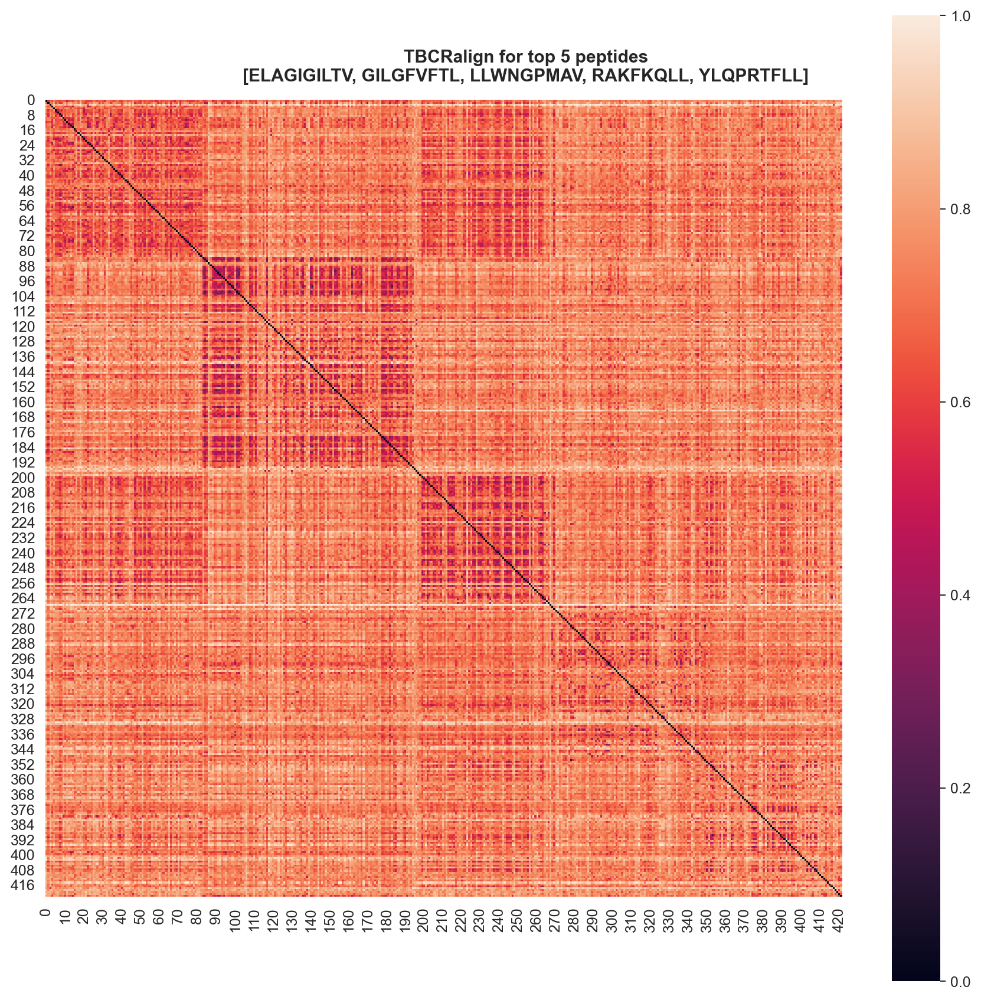

In [915]:
f,a = plt.subplots(1,1,figsize=(10,10))
sns.heatmap( mms.fit_transform(da_tbcr), square=True, ax = a)
f.suptitle('TBCRalign for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]',fontweight='semibold',  y=0.9)
f.tight_layout()

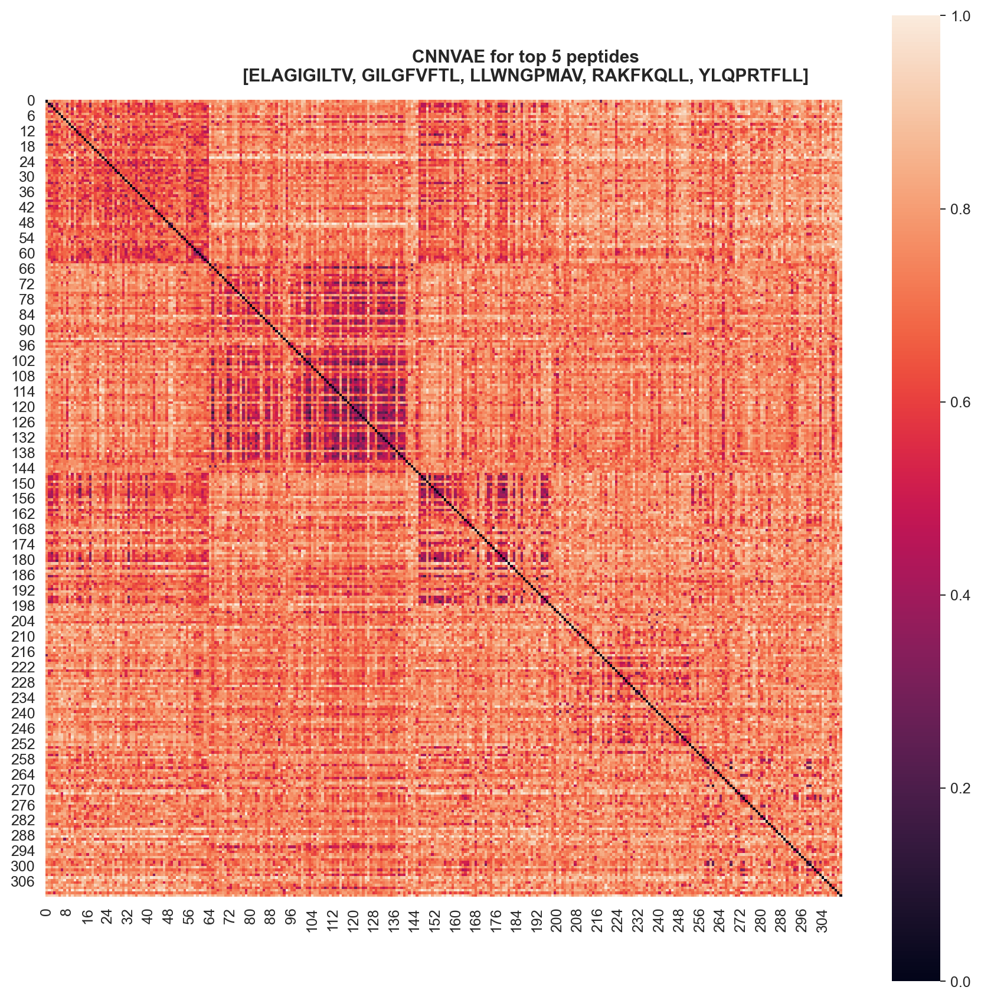

In [903]:
f,a = plt.subplots(1,1,figsize=(10,10))
sns.heatmap(mms.fit_transform(da_test), square=True, ax = a)
f.suptitle('CNNVAE for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold', y=0.9)
f.tight_layout()

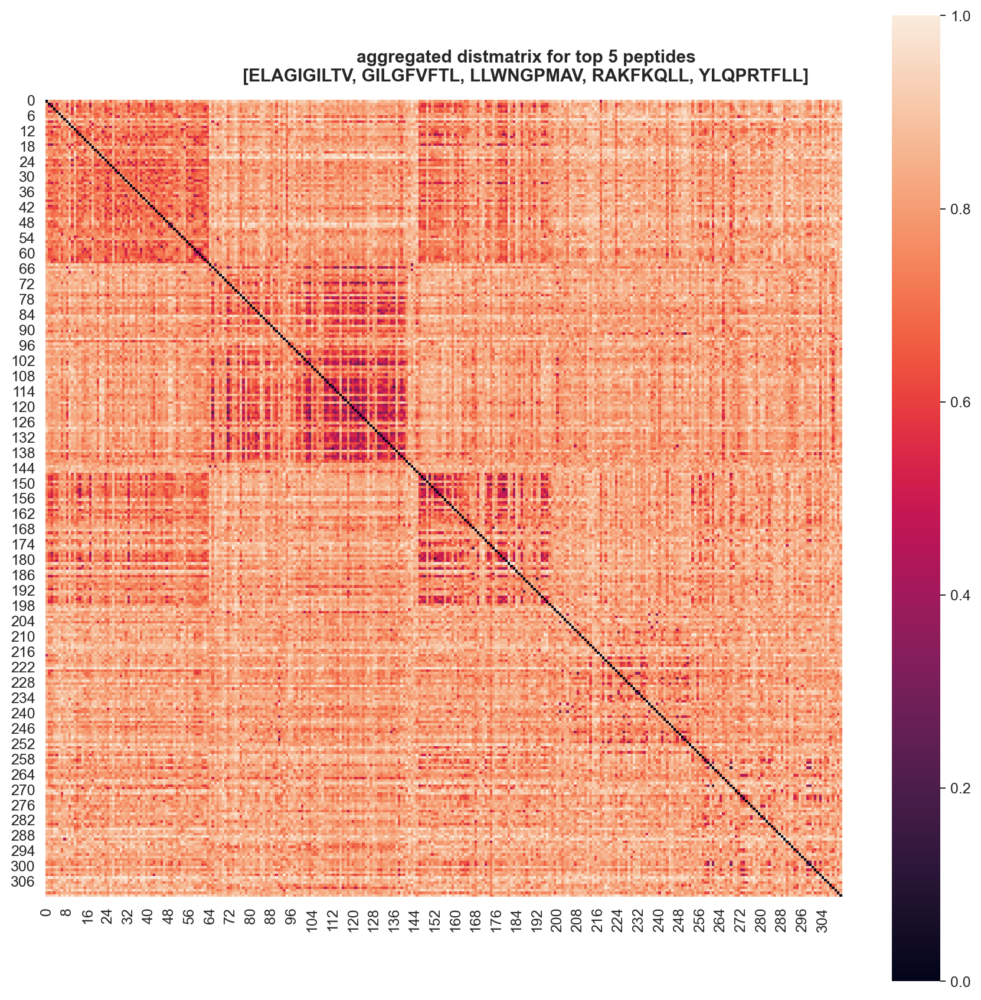

In [905]:
f,a = plt.subplots(1,1,figsize=(10,10))
sns.heatmap(mms.fit_transform(da_agg2), square=True, ax = a)
f.suptitle('aggregated distmatrix for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold',y=0.9)
f.tight_layout()

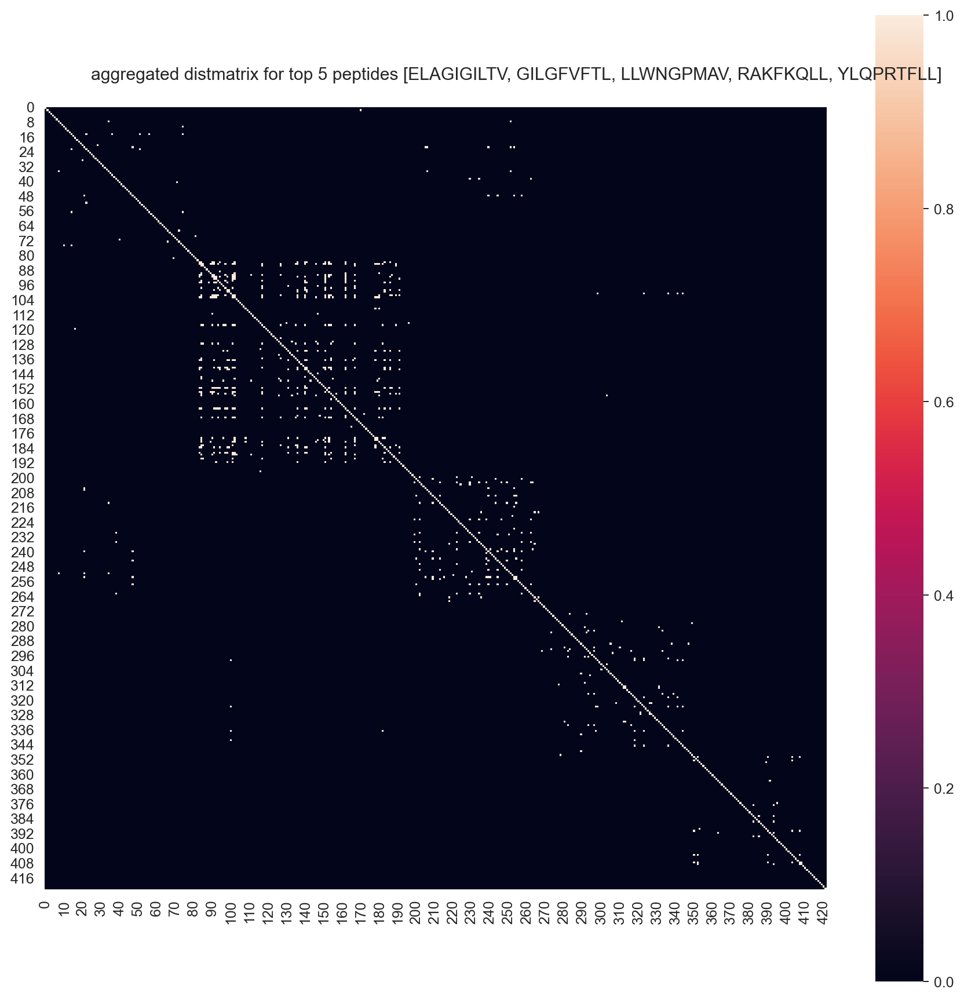

In [906]:
f,a = plt.subplots(1,1,figsize=(10,10))
sns.heatmap(mms.fit_transform(da_agg)<0.6, square=True, ax = a)
f.suptitle('aggregated distmatrix for top 5 peptides [ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', y=0.9)
f.tight_layout()

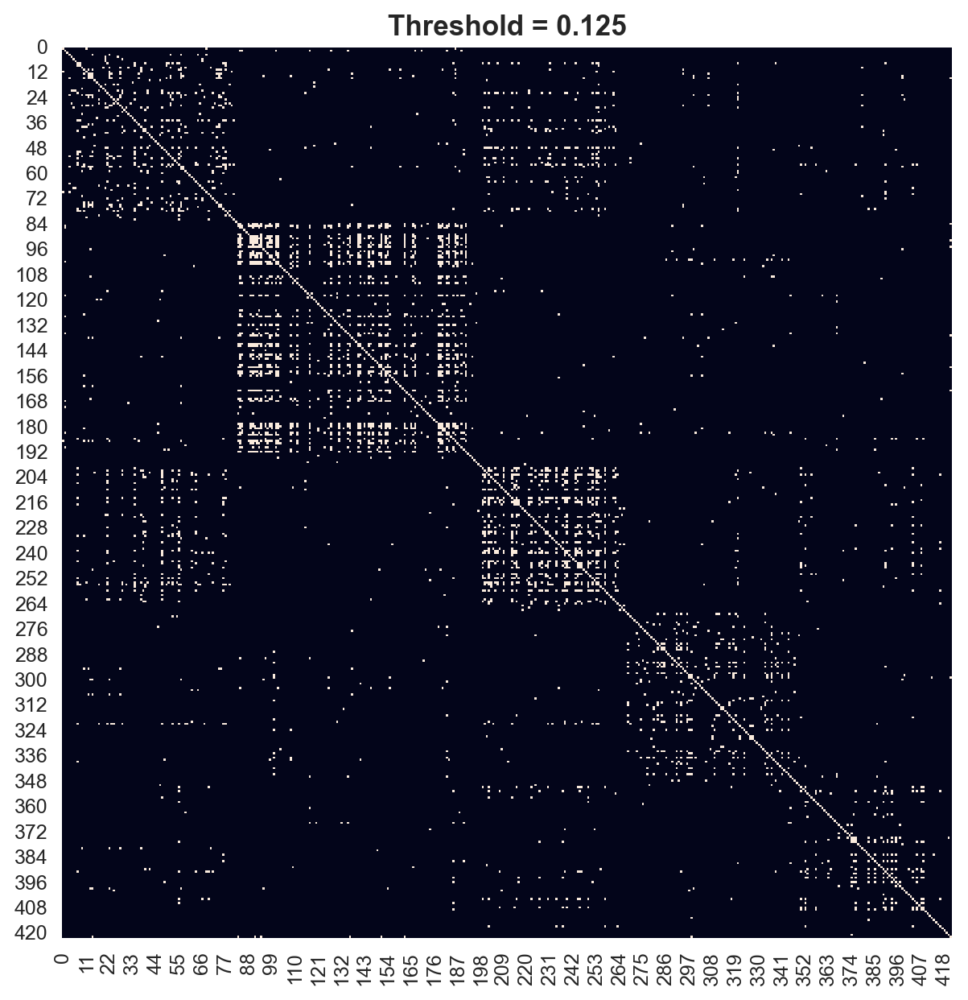

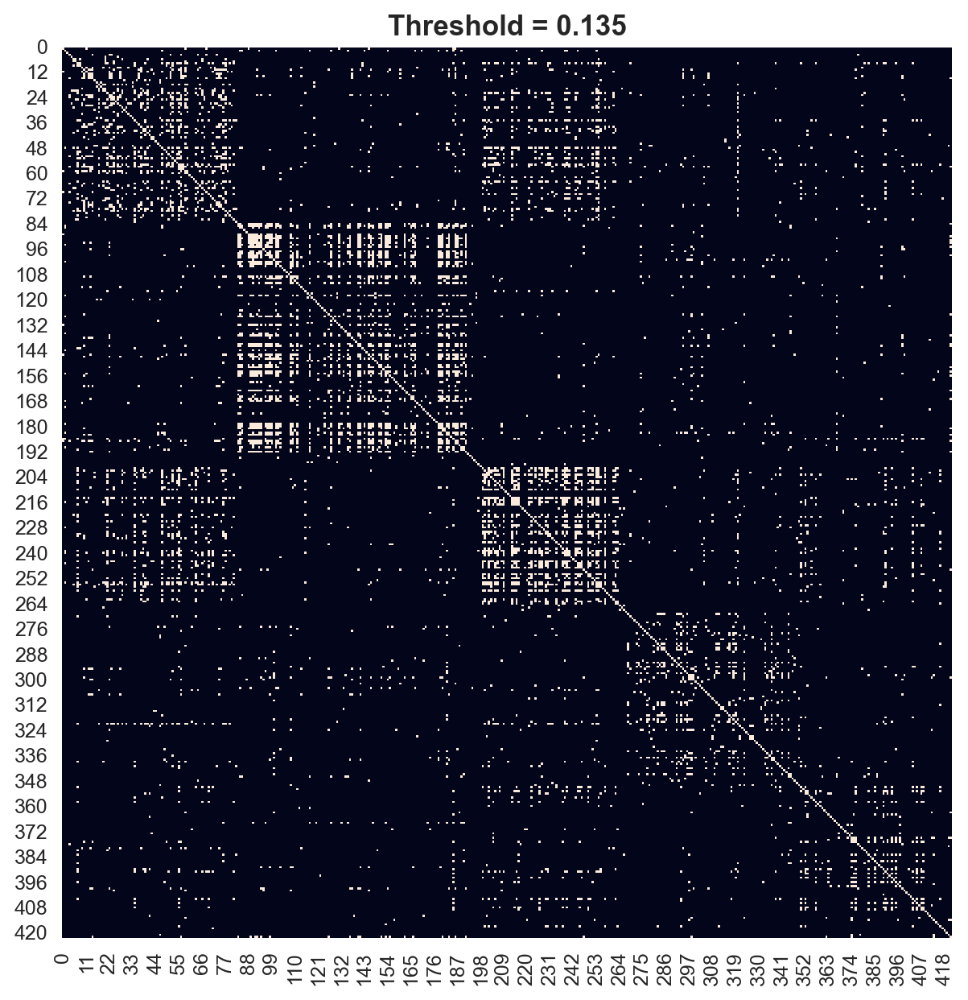

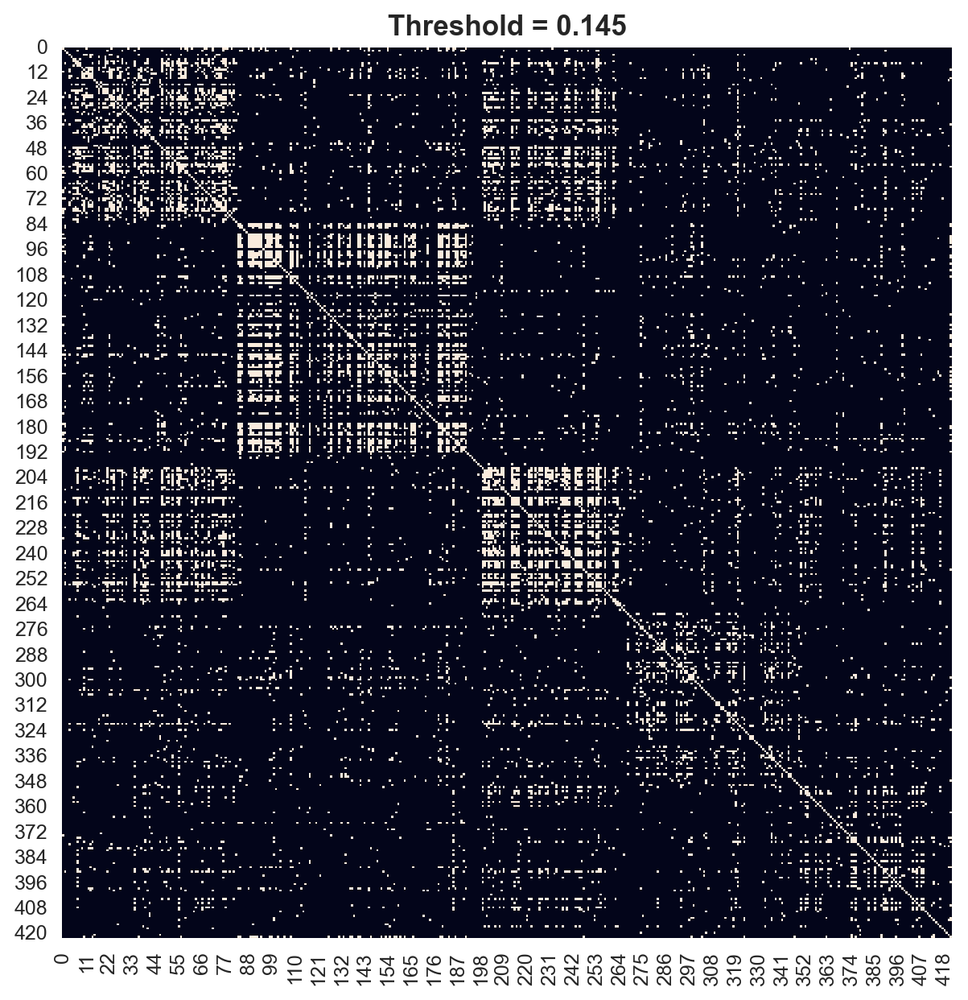

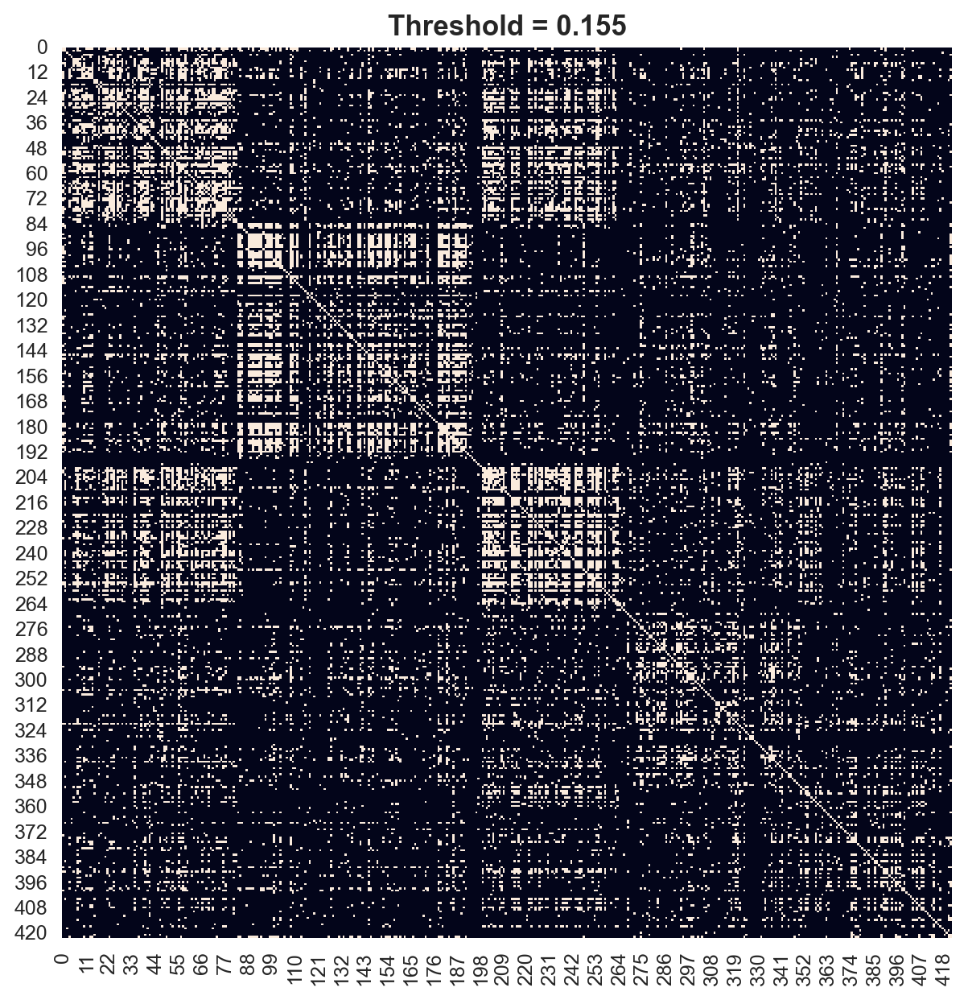

In [916]:
# for t in [0.

for t in [0.125, 0.135, 0.145, 0.155]:
    f,a = plt.subplots(1,1,figsize=(7,7))
    sns.heatmap(da_tbcr<t, square=True, ax = a, cbar=False)
    a.set_title(f'Threshold = {t}', fontweight='semibold', fontsize=14)
    # f.suptitle('CNNVAE for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold', y=0.9)
    f.tight_layout()

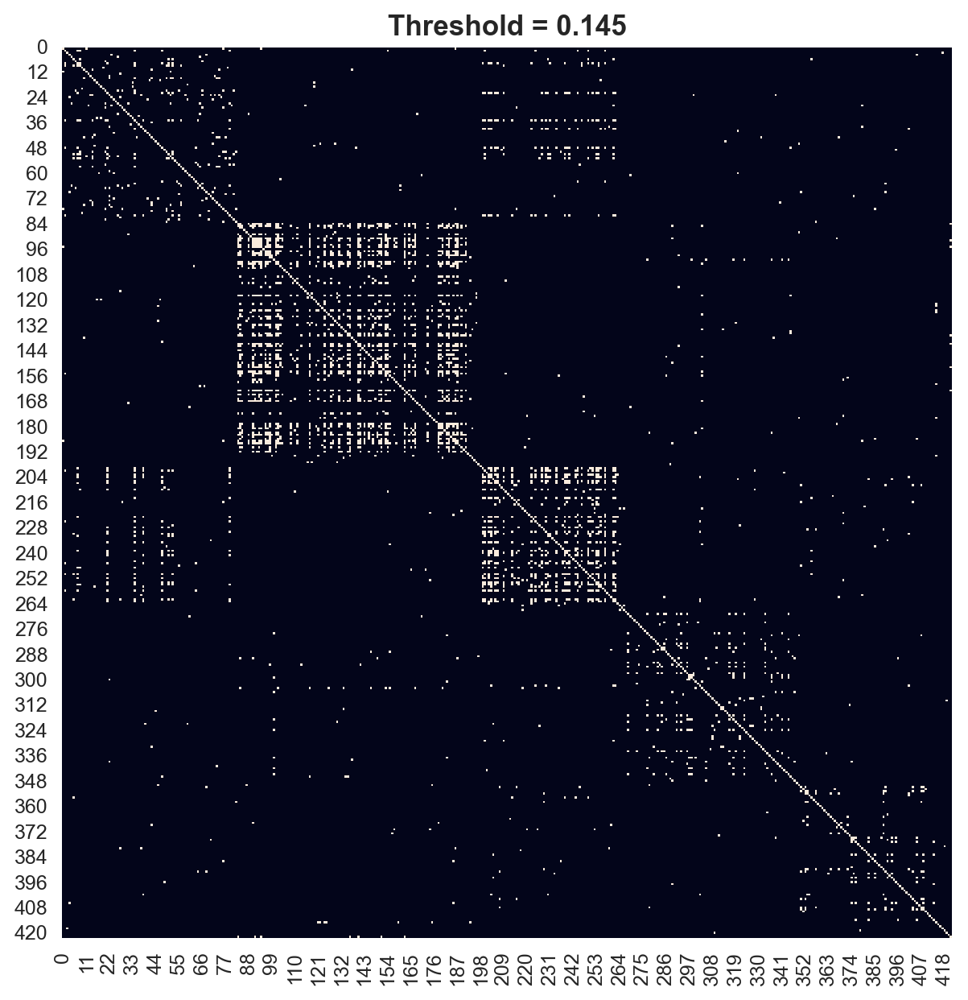

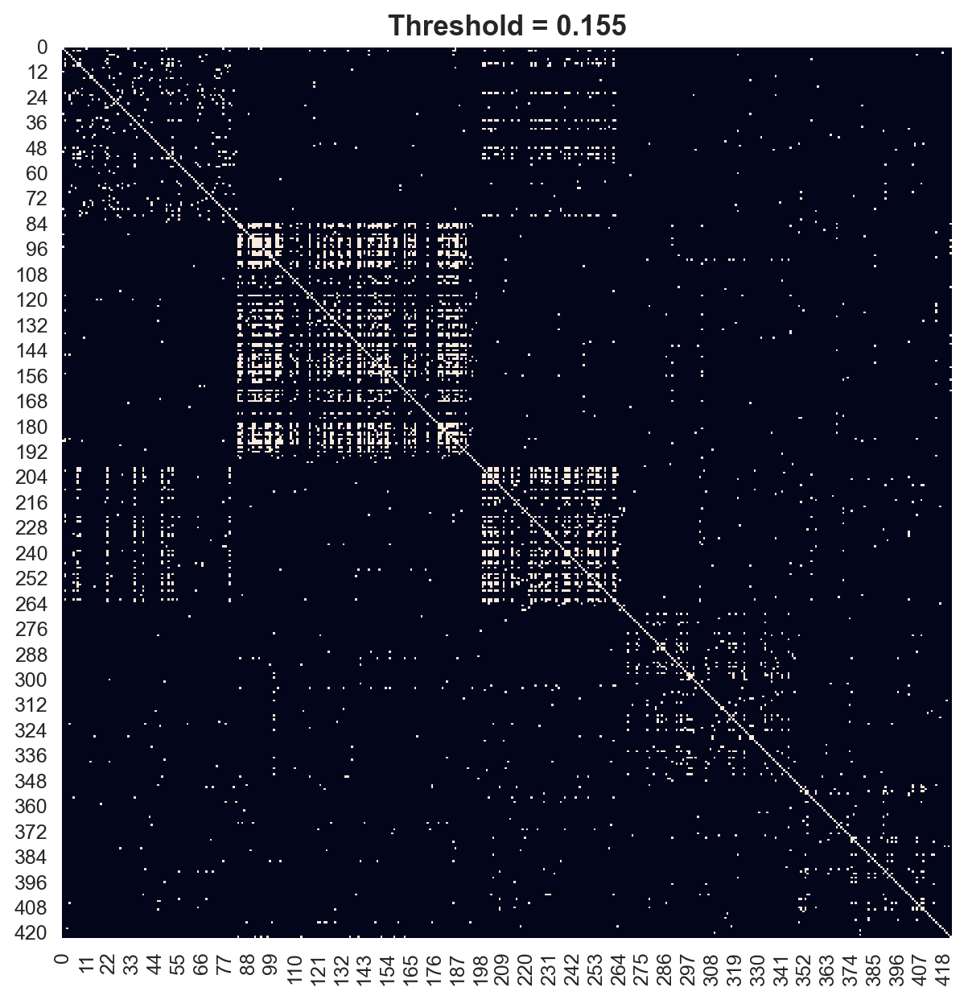

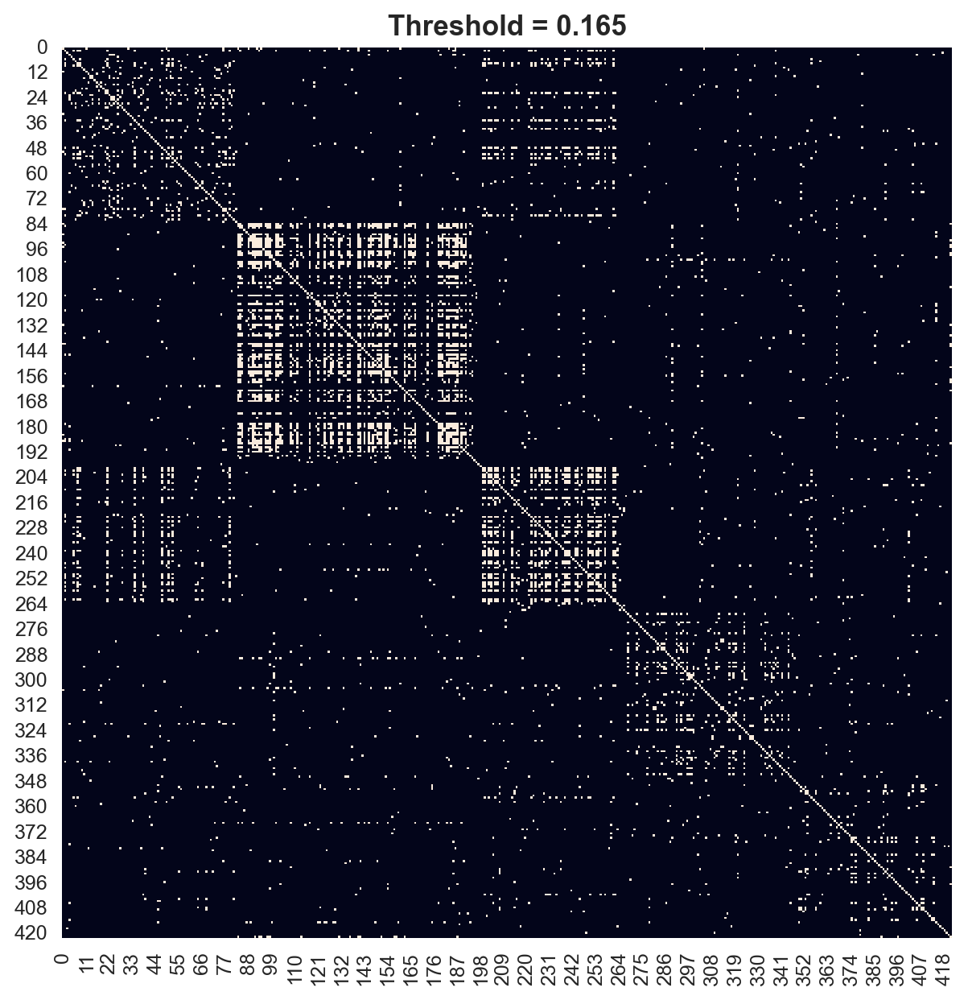

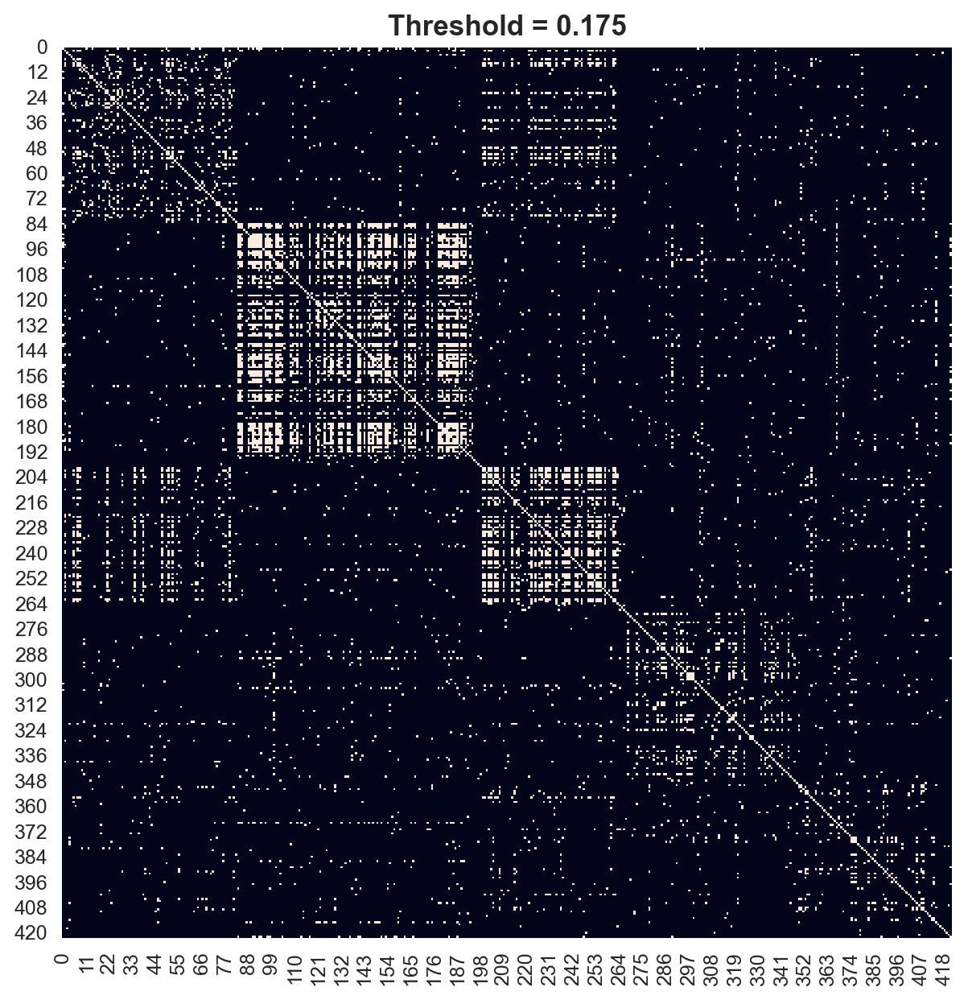

In [917]:
# for t in [0.

for t in [0.145, 0.155, 0.165, 0.175]:
    f,a = plt.subplots(1,1,figsize=(7,7))
    sns.heatmap(da_test<t, square=True, ax = a, cbar=False)
    a.set_title(f'Threshold = {t}', fontweight='semibold', fontsize=14)
    # f.suptitle('CNNVAE for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold', y=0.9)
    f.tight_layout()

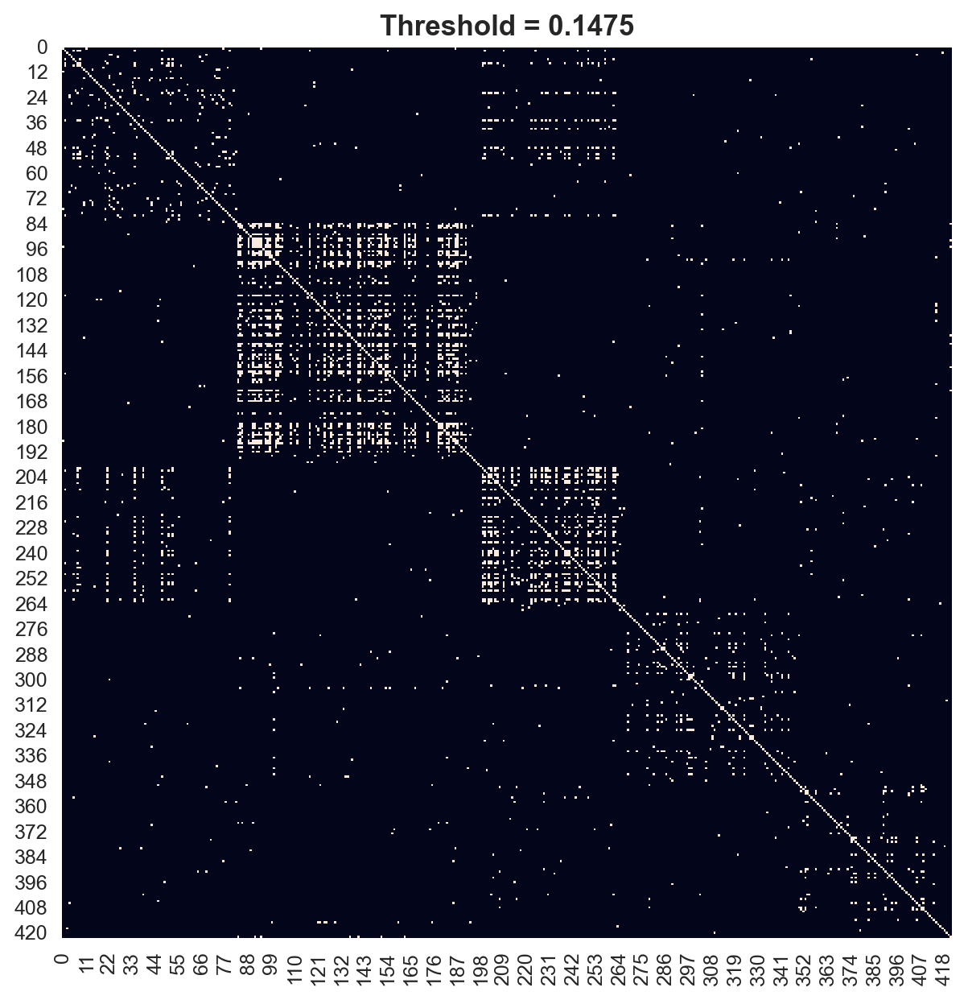

In [921]:
# for t in [0.
t=0.1475
f,a = plt.subplots(1,1,figsize=(7,7))
sns.heatmap(da_test<t, square=True, ax = a, cbar=False)
a.set_title(f'Threshold = {t}', fontweight='semibold', fontsize=14)
# f.suptitle('CNNVAE for top 5 peptides\n[ELAGIGILTV, GILGFVFTL, LLWNGPMAV, RAKFKQLL, YLQPRTFLL]', fontweight='semibold', y=0.9)
f.tight_layout()

### Unsub - heatmap test

In [419]:
# subsample to 4 and subsample a few
subsample = []
for p in tbcr_subset.peptide.unique():
    subsample.append(tbcr_subset.query('peptide==@p').sample(frac=1, random_state=13))
tbcr_nosub = pd.concat(subsample)
tbcr_nosub = tbcr_nosub[[str(x) for x in tbcr_nosub.index]+['binder','partition','raw_index','peptide','original_peptide']]
# Reset index to ordinal to match NetworkX tree just for this example
tbcr_nosub.reset_index(drop=True, inplace=True)
tbcr_nosub.columns = tbcr_nosub.index.tolist() + ['binder', 'partition', 'raw_index', 'peptide','original_peptide']
tbcr_nosub.groupby('peptide').count()

,0,1,2,3,4,5,6,7,8,9,...,640,641,642,643,644,645,binder,partition,raw_index,original_peptide
peptide,,,,,,,,,,,,,,,,,,,,,
ELAGIGILTV,92,92,92,92,92,92,92,92,92,92,...,92,92,92,92,92,92,92,92,92,92
GILGFVFTL,233,233,233,233,233,233,233,233,233,233,...,233,233,233,233,233,233,233,233,233,233
LLWNGPMAV,75,75,75,75,75,75,75,75,75,75,...,75,75,75,75,75,75,75,75,75,75
RAKFKQLL,166,166,166,166,166,166,166,166,166,166,...,166,166,166,166,166,166,166,166,166,166
YLQPRTFLL,80,80,80,80,80,80,80,80,80,80,...,80,80,80,80,80,80,80,80,80,80


In [422]:
sorted = tbcr_nosub.sort_values('peptide')
sorted = sorted[list(sorted.index) + ['peptide','raw_index']]
sorted_vals = sorted[list(sorted.index)].values

### some pruning stats things

In [986]:
print('TBCR')
vals = tbcr_test[tbcr_test.index].values
vals[vals!=0].min(), vals.max(), vals.std(), vals.mean(), np.median(vals)
# Using distances
threshold = 0.145
for threshold in np.linspace(0.135, 0.16, 10):
    G = nx.Graph(vals)
    tree = nx.minimum_spanning_tree(G)
    tree_pruned = tree.copy()
    removed_edges = []
    for u,v in tree_pruned.edges():
        weight = tree_pruned.get_edge_data(u,v)['weight']
        if weight >=threshold:
            label1=tbcr_test.iloc[u]['peptide']
            label2=tbcr_test.iloc[v]['peptide']
            removed_edges.append((u,v, round(weight,4), int(label1==label2), label1, label2)) 
            tree_pruned.remove_edge(u,v)
    print('***')
    print(f'threshold:{threshold:.3f}\t\t',len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were same-class')
    print('***')

TBCR
***
threshold:0.135		 51 removed edges 
25.49% of the removed edges were same-class
***
***
threshold:0.138		 44 removed edges 
25.00% of the removed edges were same-class
***
***
threshold:0.141		 35 removed edges 
22.86% of the removed edges were same-class
***
***
threshold:0.143		 31 removed edges 
19.35% of the removed edges were same-class
***
***
threshold:0.146		 25 removed edges 
20.00% of the removed edges were same-class
***
***
threshold:0.149		 22 removed edges 
18.18% of the removed edges were same-class
***
***
threshold:0.152		 17 removed edges 
23.53% of the removed edges were same-class
***
***
threshold:0.154		 16 removed edges 
25.00% of the removed edges were same-class
***
***
threshold:0.157		 13 removed edges 
23.08% of the removed edges were same-class
***
***
threshold:0.160		 8 removed edges 
25.00% of the removed edges were same-class
***


In [984]:
print('VAE')
vals = da_test # tbcr_test[tbcr_test.index].values
vals[vals!=0].min(), vals.max(), vals.std(), vals.mean(), np.median(vals)
# Using distances
threshold = 0.145
for threshold in np.linspace(0.155, 0.18, 10):
    G = nx.Graph(vals)
    tree = nx.minimum_spanning_tree(G)
    tree_pruned = tree.copy()
    removed_edges = []
    for u,v in tree_pruned.edges():
        weight = tree_pruned.get_edge_data(u,v)['weight']
        if weight >=threshold:
            label1=tbcr_test.iloc[u]['peptide']
            label2=tbcr_test.iloc[v]['peptide']
            removed_edges.append((u,v, round(weight,4), int(label1==label2), label1, label2)) 
            tree_pruned.remove_edge(u,v)
    print('***')
    print(f'threshold:{threshold:.3f}\t\t',len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were same-class')
    print('***')

VAE
***
threshold:0.155		 60 removed edges 
38.33% of the removed edges were same-class
***
***
threshold:0.158		 49 removed edges 
38.78% of the removed edges were same-class
***
***
threshold:0.161		 38 removed edges 
42.11% of the removed edges were same-class
***
***
threshold:0.163		 31 removed edges 
41.94% of the removed edges were same-class
***
***
threshold:0.166		 27 removed edges 
48.15% of the removed edges were same-class
***
***
threshold:0.169		 22 removed edges 
40.91% of the removed edges were same-class
***
***
threshold:0.172		 15 removed edges 
46.67% of the removed edges were same-class
***
***
threshold:0.174		 12 removed edges 
41.67% of the removed edges were same-class
***
***
threshold:0.177		 8 removed edges 
25.00% of the removed edges were same-class
***
***
threshold:0.180		 8 removed edges 
25.00% of the removed edges were same-class
***


In [985]:
print('Aggregated')
vals = da_agg2 # tbcr_test[tbcr_test.index].values
vals[vals!=0].min(), vals.max(), vals.std(), vals.mean(), np.median(vals)
# Using distances
threshold = 0.145
for threshold in np.linspace(0.28, 0.32, 10):
    G = nx.Graph(vals)
    tree = nx.minimum_spanning_tree(G)
    tree_pruned = tree.copy()
    removed_edges = []
    for u,v in tree_pruned.edges():
        weight = tree_pruned.get_edge_data(u,v)['weight']
        if weight >=threshold:
            label1=tbcr_test.iloc[u]['peptide']
            label2=tbcr_test.iloc[v]['peptide']
            removed_edges.append((u,v, round(weight,4), int(label1==label2), label1, label2)) 
            tree_pruned.remove_edge(u,v)
    print('***')
    print(f'threshold:{threshold:.3f}\t\t',len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were same-class')
    print('***')

Aggregated
***
threshold:0.280		 57 removed edges 
31.58% of the removed edges were same-class
***
***
threshold:0.284		 49 removed edges 
30.61% of the removed edges were same-class
***
***
threshold:0.289		 42 removed edges 
30.95% of the removed edges were same-class
***
***
threshold:0.293		 33 removed edges 
33.33% of the removed edges were same-class
***
***
threshold:0.298		 28 removed edges 
35.71% of the removed edges were same-class
***
***
threshold:0.302		 19 removed edges 
36.84% of the removed edges were same-class
***
***
threshold:0.307		 15 removed edges 
26.67% of the removed edges were same-class
***
***
threshold:0.311		 12 removed edges 
16.67% of the removed edges were same-class
***
***
threshold:0.316		 9 removed edges 
22.22% of the removed edges were same-class
***
***
threshold:0.320		 7 removed edges 
14.29% of the removed edges were same-class
***


# MST / CC

In [1038]:
vals = tbcr_test[tbcr_test.index].values
labels = tbcr_test['peptide'].values
label_encoder = LabelEncoder()
encoded_labels = label_encoder.fit_transform(labels)

print(vals[vals!=0].min(), vals.max(), vals.std(), vals.mean(), np.median(vals)) 
# Using distances
G = nx.Graph(vals)
for i, node in enumerate(G.nodes()):
    G.nodes[node]['peptide'] = labels[i]
    
tree = nx.minimum_spanning_tree(G)
tree_pruned = tree.copy()
threshold = 0.13
removed_edges = []
for u,v in tree_pruned.edges():
    weight = tree_pruned.get_edge_data(u,v)['weight']
    if weight >=threshold:
        label1=tbcr_test.iloc[u]['peptide']
        label2=tbcr_test.iloc[v]['peptide']
        removed_edges.append((u,v, round(weight,4), int(label1==label2), label1, label2)) 
        tree_pruned.remove_edge(u,v)

nodes_to_remove=list(nx.isolates(tree_pruned))
tree_pruned.remove_nodes_from(nodes_to_remove)
print(f'***\nbefore pruning : {len(tree.edges())} edges, {len(tree.nodes())} nodes\n***')
print(f'***\nafter pruning : {len(tree_pruned.edges())} edges, {len(tree_pruned.nodes())} nodes\n***')
print(len(removed_edges), 'removed edges', f'\n{np.array([x[3] for x in removed_edges]).mean():.2%} of the removed edges were actually same-class')
print('***\n')
print(removed_edges)
print(tree_pruned.edges())

0.0355119166666666 0.2906513333333334 0.027530748383427613 0.1814250393793565 0.18264616666666655
***
before pruning : 421 edges, 422 nodes
***
***
after pruning : 347 edges, 352 nodes
***
74 removed edges 
27.03% of the removed edges were actually same-class
***

[(0, 373, 0.1381, 0, 'ELAGIGILTV', 'YLQPRTFLL'), (2, 417, 0.1493, 0, 'ELAGIGILTV', 'YLQPRTFLL'), (20, 123, 0.1512, 0, 'ELAGIGILTV', 'GILGFVFTL'), (25, 187, 0.1513, 0, 'ELAGIGILTV', 'GILGFVFTL'), (34, 142, 0.1302, 0, 'ELAGIGILTV', 'GILGFVFTL'), (43, 243, 0.1321, 0, 'ELAGIGILTV', 'LLWNGPMAV'), (43, 314, 0.1332, 0, 'ELAGIGILTV', 'RAKFKQLL'), (47, 212, 0.1434, 0, 'ELAGIGILTV', 'LLWNGPMAV'), (48, 177, 0.1392, 0, 'ELAGIGILTV', 'GILGFVFTL'), (52, 335, 0.1307, 0, 'ELAGIGILTV', 'RAKFKQLL'), (53, 189, 0.1452, 0, 'ELAGIGILTV', 'GILGFVFTL'), (60, 207, 0.1305, 0, 'ELAGIGILTV', 'LLWNGPMAV'), (71, 417, 0.1341, 0, 'ELAGIGILTV', 'YLQPRTFLL'), (73, 176, 0.139, 0, 'ELAGIGILTV', 'GILGFVFTL'), (86, 398, 0.1586, 0, 'GILGFVFTL', 'YLQPRTFLL'), (100,

In [1068]:
color_map = {k:v for k,v in zip(sorted(np.unique(labels)), sns.color_palette('tab10', len(np.unique(labels))))}
shape_map = {k:v for k,v in zip(sorted(np.unique(labels)), ['s', 'o', 'h', '8', 'v'])}#so^>v<dph8

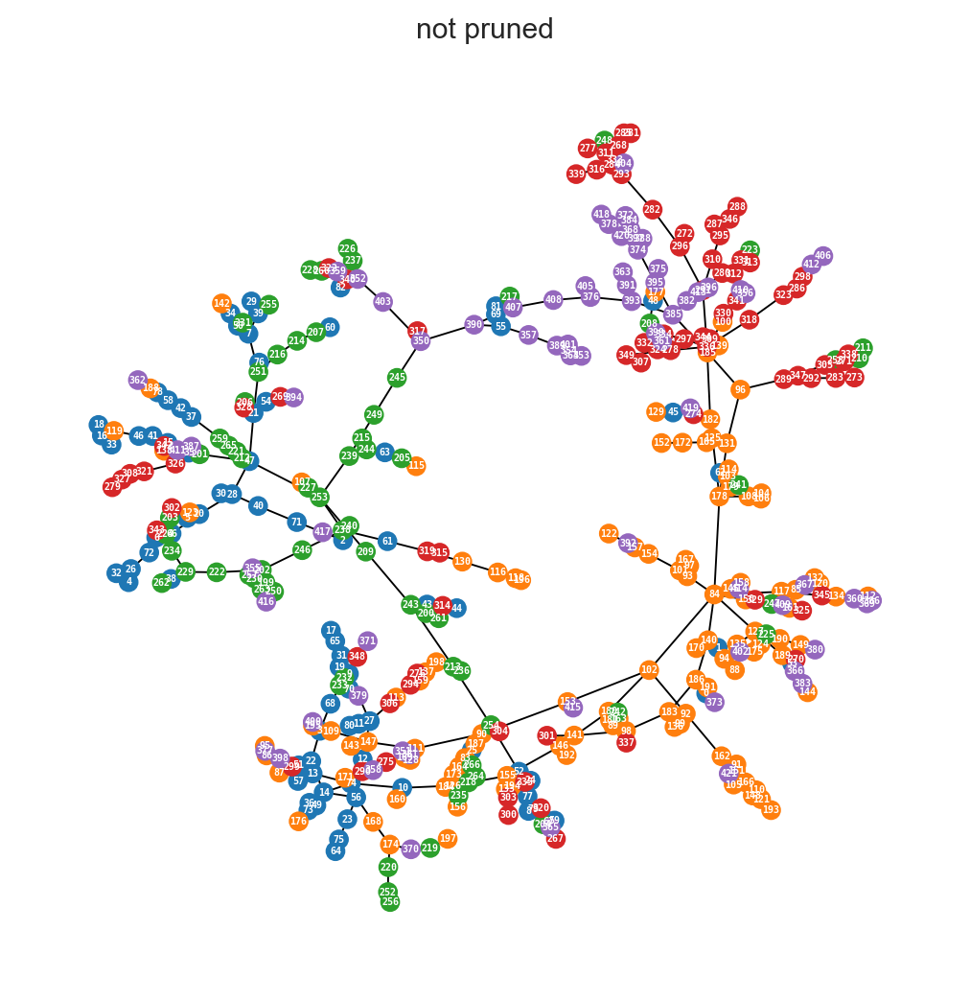

In [1104]:
sns.set_style('darkgrid')
# Visualize the graph and the minimum spanning tree
f,a = plt.subplots(1,1, figsize=(7,7))
pos = nx.spring_layout(tree, iterations=300, k=0.1, threshold=1e-5, seed=13)
node_colors = [color_map[tree.nodes[node]['peptide']] for node in tree.nodes()]
nx.draw_networkx_nodes(tree, pos, node_color=node_colors, node_size=52.5, ax=a) # nx.draw_networkx_edges(G, pos, edge_color="grey")
nx.draw_networkx_labels(tree, pos, font_size=4, font_color='w', font_weight='semibold', font_family="monospace")
# nx.draw_networkx_edge_labels(
#     G, pos, edge_labels={(u, v): round(d["weight"],3) for u, v, d in tree.edges(data=True)}
# )
nx.draw_networkx_edges(tree, pos, edge_color="k", width=0.75)
a.set_title('not pruned')
plt.axis("off")
plt.show()

In [1067]:
tree_pruned.nodes[210], tree_pruned.nodes[271], tree_pruned.get_edge_data(210,271)

({'peptide': 'LLWNGPMAV'},
 {'peptide': 'RAKFKQLL'},
 {'weight': 0.1271555833333333})

In [1107]:
pd.read_csv('../../elagigiltv_llwngpmav.txt')

,Unnamed: 0,A1,A2,A3,B1,B2,B3,fulltcr,mhc_seq,raw_index
0,3,DRGSQS,IYSNGD,AVSASKII,MNHNS,SASEGT,ASSDQTGDAYEQY,DRGSQSIYSNGDAVSASKIIMNHNSSASEGTASSDQTGDAYEQY,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,VDJdb_6432
1,9,NSASQS,VYSSG,VADSWGKLQ,LNHDA,SQIVND,ASSIPAGGAYGYT,NSASQSVYSSGVADSWGKLQLNHDASQIVNDASSIPAGGAYGYT,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,IEDB_56359
2,13,DRGSQS,IYSNGD,AVIDDKII,MNHEY,SVGEGT,ASSYTEAYEQY,DRGSQSIYSNGDAVIDDKIIMNHEYSVGEGTASSYTEAYEQY,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,IEDB_56364
3,17,DRGSQS,IYSNGD,APSGGKLI,DFQATT,SNEGSKA,SASGDRGADTQY,DRGSQSIYSNGDAPSGGKLIDFQATTSNEGSKASASGDRGADTQY,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,VDJdb_6299
4,19,DRGSQS,IYSNGD,AVGGGGADGLT,LGHNA,YNFKEQ,ASSQAQLNTEAF,DRGSQSIYSNGDAVGGGGADGLTLGHNAYNFKEQASSQAQLNTEAF,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,ITRAP_1768
...,...,...,...,...,...,...,...,...,...,...
162,629,DRGSQS,IYSNGD,AVPSGGYQKVT,PRHDT,FYEKMQ,ASTLSGGAVFEQY,DRGSQSIYSNGDAVPSGGYQKVTPRHDTFYEKMQASTLSGGAVFEQY,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,IEDB_56376
163,633,DRGSQS,IYSNGD,AVIHARLM,SGHAT,FQNNGV,ASSPAGGYEQYV,DRGSQSIYSNGDAVIHARLMSGHATFQNNGVASSPAGGYEQYV,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,IEDB_56334
164,637,TSDPSYG,QGSYDQQN,AMSPEGGGSYIPT,SGHKS,YYEKEE,ASSPRRTGYTGELF,TSDPSYGQGSYDQQNAMSPEGGGSYIPTSGHKSYYEKEEASSPRRT...,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,VDJdb_74016
165,640,DRGSQS,IYSNGD,AVKRGSQGNLI,MDHEN,SYDVKM,ASSLAWGQPQH,DRGSQSIYSNGDAVKRGSQGNLIMDHENSYDVKMASSLAWGQPQH,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,ITRAP_5737


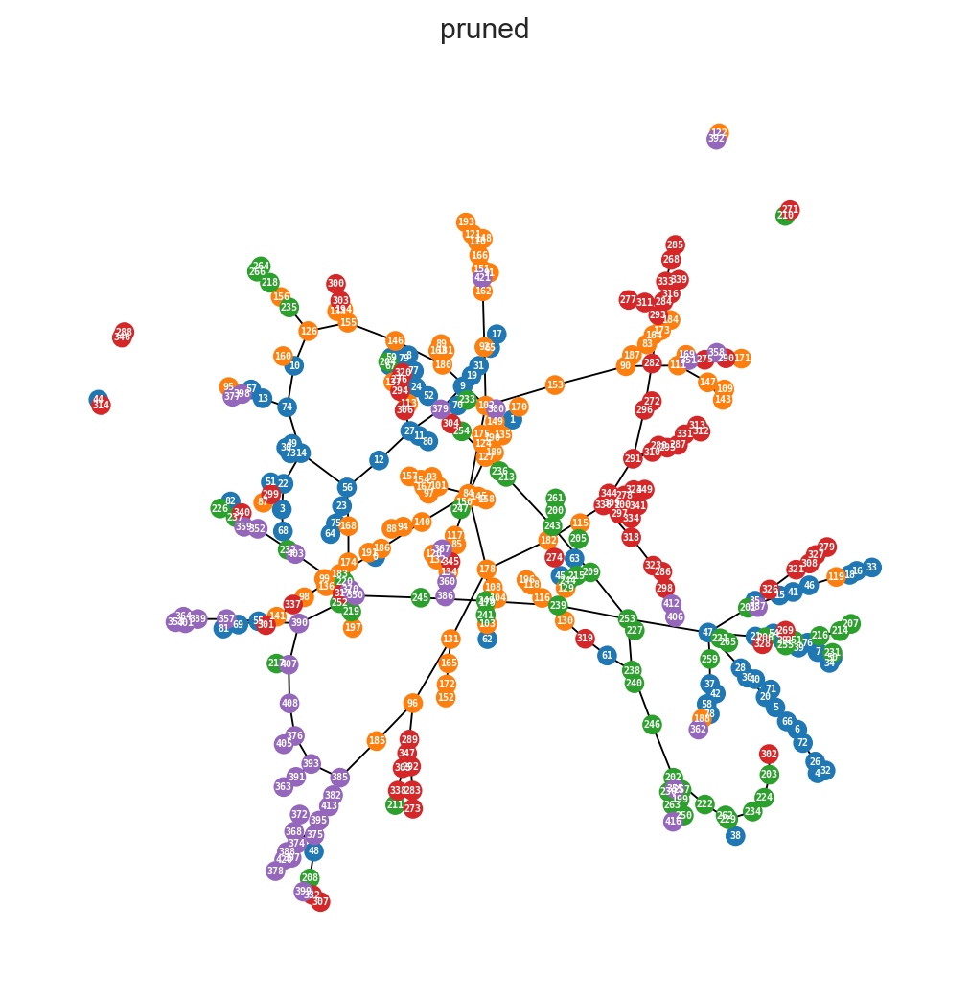

In [1105]:
sns.set_style('darkgrid')
# Visualize the graph and the minimum spanning tree
f,a = plt.subplots(1,1, figsize=(7,7))
pos = nx.spring_layout(tree_pruned, iterations=300, k=0.1, threshold=1e-5, seed=13)
node_colors = [color_map[tree_pruned.nodes[node]['peptide']] for node in tree_pruned.nodes()]
nx.draw_networkx_nodes(tree_pruned, pos, node_color=node_colors, node_size=52.5, ax=a) # nx.draw_networkx_edges(G, pos, edge_color="grey")
nx.draw_networkx_labels(tree_pruned, pos, font_size=4, font_color='w', font_weight='semibold', font_family="monospace")
# nx.draw_networkx_edge_labels(
#     G, pos, edge_labels={(u, v): round(d["weight"],3) for u, v, d in tree.edges(data=True)}
# )
nx.draw_networkx_edges(tree_pruned, pos, edge_color="k", width=0.75)
a.set_title('pruned')
plt.axis("off")
plt.show()

# 